#### Import

In [ ]:
import os
import cv2
import glob
from PIL import Image
from tqdm import tqdm

import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
import torch.nn.functional as F
from torchvision import transforms, datasets
from torchvision.datasets import MNIST
from torch.utils.data import Dataset
from torch.utils.data import Dataset, DataLoader, Subset
import torchvision.transforms.functional as TF
from torchvision.datasets import ImageFolder
from einops.layers.torch import Rearrange
from einops import rearrange, repeat
from torchsummary import summary

#### Data

In [ ]:
# Base directory
base_dir = "MNIST-Reconstruction"

# Create the base directory if it doesn't exist
os.makedirs(base_dir, exist_ok=True)

# Create subfolders from 1 to 50
for i in range(1, 51):
    folder_path = os.path.join(base_dir, str(i))
    os.makedirs(folder_path, exist_ok=True)

print("Folders MNIST-Reconstruction/1 to MNIST-Reconstruction/50 created successfully.")

# Set device (CPU or GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

Folders MNIST-Reconstruction/1 to MNIST-Reconstruction/50 created successfully.


device(type='cuda')

In [ ]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Subset

# ====================================
# Configuration
# ====================================
fmnist_mean = 0.2860
fmnist_std = 0.3530
batch_size = 100
target_per_class = 100   # Change to 10 if you want 10 samples per class

# ====================================
# Data Transformations
# ====================================
train_transform = transforms.Compose([
    # Data augmentations (optional, uncomment if needed)
    # transforms.RandomRotation(degrees=(-20, 20)),
    # transforms.RandomResizedCrop(28, scale=(0.8, 1.0), ratio=(0.9, 1.1)),
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    # transforms.RandomGrayscale(p=0.1),
    # transforms.RandomAffine(degrees=(-10, 10), translate=(0.1, 0.1), scale=(0.9, 1.1), shear=(-10, 10)),
    # transforms.RandomPerspective(distortion_scale=0.5, p=0.5),

    transforms.Grayscale(num_output_channels=1),
    transforms.Resize(28),
    transforms.ToTensor(),
    # transforms.Normalize((fmnist_mean,), (fmnist_std,))  # Optional normalization
])

test_transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=1),
    transforms.Resize(28),
    transforms.ToTensor(),
    # transforms.Normalize((fmnist_mean,), (fmnist_std,))
])

# ====================================
# Load Full FashionMNIST Dataset
# ====================================
full_train_dataset = datasets.FashionMNIST(
    root='./data',
    train=True,
    transform=train_transform,
    download=True
)

# ====================================
# Select a Small Subset (Balanced Classes)
# ====================================
class_counts = {i: 0 for i in range(10)}
selected_indices = []

for idx, (_, label) in enumerate(full_train_dataset):
    if class_counts[label] < target_per_class:
        selected_indices.append(idx)
        class_counts[label] += 1
    if all(count >= target_per_class for count in class_counts.values()):
        break

train_dataset = Subset(full_train_dataset, selected_indices)

# ====================================
# Load Test Dataset
# ====================================
test_dataset = datasets.FashionMNIST(
    root='./data',
    train=False,
    transform=test_transform,
    download=True
)

# ====================================
# Data Loaders
# ====================================
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2, pin_memory=True)

# ====================================
# Verify Setup
# ====================================
print("Training Dataset:")
print(f"  Size: {len(train_dataset)}")
print(f"  Shape: {next(iter(train_loader))[0].shape}")
print(f"  Batch Size: {train_loader.batch_size}")

print("\nTesting Dataset:")
print(f"  Size: {len(test_dataset)}")
print(f"  Shape: {next(iter(test_loader))[0].shape}")
print(f"  Batch Size: {test_loader.batch_size}")


100%|██████████| 26.4M/26.4M [00:02<00:00, 11.7MB/s]
100%|██████████| 29.5k/29.5k [00:00<00:00, 211kB/s]
100%|██████████| 4.42M/4.42M [00:01<00:00, 3.95MB/s]
100%|██████████| 5.15k/5.15k [00:00<00:00, 13.0MB/s]


Training Dataset:
  Size: 1000
  Shape: torch.Size([100, 1, 28, 28])
  Batch Size: 100

Testing Dataset:
  Size: 10000
  Shape: torch.Size([100, 1, 28, 28])
  Batch Size: 100


In [ ]:
# # Plot first 100 images in a 10x10 grid
# plt.figure(figsize=(12, 12))
# for i in range(100):
#     image, label = train_dataset[i]
#     plt.subplot(10, 10, i + 1)
#     plt.imshow(image.squeeze(), cmap='gray')
#     plt.title(label, fontsize=6)
#     plt.axis('off')

# plt.tight_layout()
# plt.show()

#### Classifiers

In [ ]:
import torch
import torch.nn as nn
from torchsummary import summary

class CNNClassifier(nn.Module):
    def __init__(self, nc=1, ncf=64, n_classes=10, img_size=28):
        super(CNNClassifier, self).__init__()

        # Output after Conv(5x5, stride=1, no padding): 28→24
        conv_out_size = img_size - 5 + 1  # = 24
        flattened_dim = ncf * conv_out_size * conv_out_size

        self.main = nn.Sequential(
            nn.Conv2d(nc, ncf, kernel_size=5, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(ncf),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Flatten(),
            nn.Linear(flattened_dim, ncf * 2),
            nn.ReLU(inplace=True),
            nn.Linear(ncf * 2, n_classes)
        )

    def forward(self, input):
        return self.main(input)


# Instantiate model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn_model = CNNClassifier(nc=1, ncf=32).to(device)

# Print model summary
print("=== CNN ===")
summary(cnn_model, (1, 28, 28))

=== CNN ===
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 24, 24]             800
       BatchNorm2d-2           [-1, 32, 24, 24]              64
         LeakyReLU-3           [-1, 32, 24, 24]               0
           Flatten-4                [-1, 18432]               0
            Linear-5                   [-1, 64]       1,179,712
              ReLU-6                   [-1, 64]               0
            Linear-7                   [-1, 10]             650
Total params: 1,181,226
Trainable params: 1,181,226
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.00
Forward/backward pass size (MB): 0.56
Params size (MB): 4.51
Estimated Total Size (MB): 5.07
----------------------------------------------------------------


In [ ]:
def train(model, train_loader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0

    pbar = tqdm(enumerate(train_loader), total=len(train_loader), desc="Training")

    for i, (inputs, labels) in pbar:
        inputs, labels = inputs.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

        pbar.set_postfix({"Batch Loss": loss.item()})

    average_loss = running_loss / len(train_loader)
    accuracy = correct / total

    return average_loss, accuracy

def test(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0
    running_loss = 0.0

    with torch.no_grad():
        pbar = tqdm(enumerate(test_loader), total=len(test_loader), desc="Testing")

        for i, (inputs, labels) in pbar:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

            pbar.set_postfix({"Batch Loss": loss.item()})

    average_loss = running_loss / len(test_loader)
    accuracy = correct / total

    return average_loss, accuracy

#### Train the model

In [ ]:
# Model Hyperparameters
input_dim = 28 * 28
hidden_dim = 128
lr = 1e-4
num_epochs = 50

# Model, optimizer, loss
csf = CNNClassifier( nc=1, ncf=64).to(device)
csf_optimizer = optim.Adam(csf.parameters(), lr=lr)
criterion = nn.CrossEntropyLoss()

# Tracking metrics
train_losses, train_accuracies = [], []
test_losses, test_accuracies = [], []
best_test_accuracy = 0.0
best_model_state = None

# Training loop
for epoch in range(num_epochs):
    train_loss, train_accuracy = train(csf, train_loader, csf_optimizer, criterion, device)
    test_loss, test_accuracy = test(csf, test_loader, device)

    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    test_losses.append(test_loss)
    test_accuracies.append(test_accuracy)

    if test_accuracy > best_test_accuracy:
        best_test_accuracy = test_accuracy
        best_model_state = csf.state_dict()

    print(f"\nEpoch {epoch + 1}/{num_epochs}")
    print(f"Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.4f}")
    print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Save best model
save_path = 'fmnist_cnn_csf_1000_noaug_.pth'
if best_model_state is not None:
    torch.save(best_model_state, save_path)
    print(f"\n✅ Best model saved with test accuracy: {best_test_accuracy:.4f}")
else:
    print("⚠️ No model was saved.")


Testing: 100%|██████████| 100/100 [00:01<00:00, 61.03it/s, Batch Loss=1.27]


Epoch 1/50
Train Loss: 1.2120, Train Accuracy: 0.5800
Test Loss: 1.2646, Test Accuracy: 0.6921



Testing: 100%|██████████| 100/100 [00:01<00:00, 62.07it/s, Batch Loss=0.82]


Epoch 2/50
Train Loss: 0.5795, Train Accuracy: 0.8020
Test Loss: 0.8127, Test Accuracy: 0.7511



Testing: 100%|██████████| 100/100 [00:01<00:00, 62.91it/s, Batch Loss=0.69]


Epoch 3/50
Train Loss: 0.4066, Train Accuracy: 0.8740
Test Loss: 0.6554, Test Accuracy: 0.7827



Testing: 100%|██████████| 100/100 [00:01<00:00, 62.72it/s, Batch Loss=0.648]


Epoch 4/50
Train Loss: 0.3139, Train Accuracy: 0.9070
Test Loss: 0.6011, Test Accuracy: 0.7858



Testing: 100%|██████████| 100/100 [00:01<00:00, 63.07it/s, Batch Loss=0.637]


Epoch 5/50
Train Loss: 0.2361, Train Accuracy: 0.9370
Test Loss: 0.6021, Test Accuracy: 0.7859



Testing: 100%|██████████| 100/100 [00:02<00:00, 48.21it/s, Batch Loss=0.666]


Epoch 6/50
Train Loss: 0.1925, Train Accuracy: 0.9480
Test Loss: 0.6045, Test Accuracy: 0.7902



Testing: 100%|██████████| 100/100 [00:01<00:00, 50.88it/s, Batch Loss=0.681]


Epoch 7/50
Train Loss: 0.1672, Train Accuracy: 0.9550
Test Loss: 0.6054, Test Accuracy: 0.7934



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.09it/s, Batch Loss=0.709]


Epoch 8/50
Train Loss: 0.1370, Train Accuracy: 0.9710
Test Loss: 0.6468, Test Accuracy: 0.7870



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.79it/s, Batch Loss=0.681]



Epoch 9/50
Train Loss: 0.1166, Train Accuracy: 0.9770
Test Loss: 0.6103, Test Accuracy: 0.7966


Testing: 100%|██████████| 100/100 [00:01<00:00, 63.04it/s, Batch Loss=0.668]



Epoch 10/50
Train Loss: 0.0900, Train Accuracy: 0.9900
Test Loss: 0.6166, Test Accuracy: 0.7973


Testing: 100%|██████████| 100/100 [00:01<00:00, 58.76it/s, Batch Loss=0.735]


Epoch 11/50
Train Loss: 0.0753, Train Accuracy: 0.9880
Test Loss: 0.6308, Test Accuracy: 0.7967



Testing: 100%|██████████| 100/100 [00:01<00:00, 51.16it/s, Batch Loss=0.711]


Epoch 12/50
Train Loss: 0.0711, Train Accuracy: 0.9890
Test Loss: 0.6297, Test Accuracy: 0.7980



Testing: 100%|██████████| 100/100 [00:02<00:00, 48.77it/s, Batch Loss=0.711]


Epoch 13/50
Train Loss: 0.0582, Train Accuracy: 0.9930
Test Loss: 0.6412, Test Accuracy: 0.7996



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.88it/s, Batch Loss=0.741]


Epoch 14/50
Train Loss: 0.0518, Train Accuracy: 0.9930
Test Loss: 0.6523, Test Accuracy: 0.7944



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.68it/s, Batch Loss=0.738]


Epoch 15/50
Train Loss: 0.0445, Train Accuracy: 0.9940
Test Loss: 0.6489, Test Accuracy: 0.7991



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.95it/s, Batch Loss=0.738]


Epoch 16/50
Train Loss: 0.0417, Train Accuracy: 0.9960
Test Loss: 0.6592, Test Accuracy: 0.7998



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.95it/s, Batch Loss=0.777]


Epoch 17/50
Train Loss: 0.0362, Train Accuracy: 0.9970
Test Loss: 0.6707, Test Accuracy: 0.7996



Testing: 100%|██████████| 100/100 [00:01<00:00, 55.12it/s, Batch Loss=0.766]


Epoch 18/50
Train Loss: 0.0331, Train Accuracy: 0.9960
Test Loss: 0.6684, Test Accuracy: 0.7990



Testing: 100%|██████████| 100/100 [00:02<00:00, 45.06it/s, Batch Loss=0.776]


Epoch 19/50
Train Loss: 0.0267, Train Accuracy: 0.9980
Test Loss: 0.6748, Test Accuracy: 0.7984



Testing: 100%|██████████| 100/100 [00:01<00:00, 62.57it/s, Batch Loss=0.795]


Epoch 20/50
Train Loss: 0.0239, Train Accuracy: 1.0000
Test Loss: 0.6832, Test Accuracy: 0.8000



Testing: 100%|██████████| 100/100 [00:01<00:00, 62.22it/s, Batch Loss=0.786]


Epoch 21/50
Train Loss: 0.0213, Train Accuracy: 1.0000
Test Loss: 0.6865, Test Accuracy: 0.7994



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.57it/s, Batch Loss=0.801]


Epoch 22/50
Train Loss: 0.0198, Train Accuracy: 0.9990
Test Loss: 0.6964, Test Accuracy: 0.7999



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.80it/s, Batch Loss=0.811]


Epoch 23/50
Train Loss: 0.0179, Train Accuracy: 1.0000
Test Loss: 0.7039, Test Accuracy: 0.7975



Testing: 100%|██████████| 100/100 [00:01<00:00, 58.23it/s, Batch Loss=0.819]


Epoch 24/50
Train Loss: 0.0165, Train Accuracy: 1.0000
Test Loss: 0.7076, Test Accuracy: 0.7978



Testing: 100%|██████████| 100/100 [00:02<00:00, 42.01it/s, Batch Loss=0.82]



Epoch 25/50
Train Loss: 0.0154, Train Accuracy: 1.0000
Test Loss: 0.7146, Test Accuracy: 0.8000


Testing: 100%|██████████| 100/100 [00:01<00:00, 61.64it/s, Batch Loss=0.839]



Epoch 26/50
Train Loss: 0.0138, Train Accuracy: 1.0000
Test Loss: 0.7168, Test Accuracy: 0.7993


Testing: 100%|██████████| 100/100 [00:01<00:00, 60.25it/s, Batch Loss=0.829]


Epoch 27/50
Train Loss: 0.0130, Train Accuracy: 1.0000
Test Loss: 0.7212, Test Accuracy: 0.7994



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.39it/s, Batch Loss=0.841]


Epoch 28/50
Train Loss: 0.0121, Train Accuracy: 1.0000
Test Loss: 0.7286, Test Accuracy: 0.7996



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.62it/s, Batch Loss=0.849]


Epoch 29/50
Train Loss: 0.0111, Train Accuracy: 1.0000
Test Loss: 0.7333, Test Accuracy: 0.7996



Testing: 100%|██████████| 100/100 [00:01<00:00, 58.95it/s, Batch Loss=0.86]


Epoch 30/50
Train Loss: 0.0106, Train Accuracy: 1.0000
Test Loss: 0.7393, Test Accuracy: 0.7992



Testing: 100%|██████████| 100/100 [00:02<00:00, 42.99it/s, Batch Loss=0.862]


Epoch 31/50
Train Loss: 0.0102, Train Accuracy: 1.0000
Test Loss: 0.7433, Test Accuracy: 0.7984



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.22it/s, Batch Loss=0.868]


Epoch 32/50
Train Loss: 0.0095, Train Accuracy: 1.0000
Test Loss: 0.7464, Test Accuracy: 0.7999



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.82it/s, Batch Loss=0.869]


Epoch 33/50
Train Loss: 0.0088, Train Accuracy: 1.0000
Test Loss: 0.7530, Test Accuracy: 0.7989



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.60it/s, Batch Loss=0.885]


Epoch 34/50
Train Loss: 0.0086, Train Accuracy: 1.0000
Test Loss: 0.7582, Test Accuracy: 0.7988



Testing: 100%|██████████| 100/100 [00:01<00:00, 61.90it/s, Batch Loss=0.881]


Epoch 35/50
Train Loss: 0.0078, Train Accuracy: 1.0000
Test Loss: 0.7625, Test Accuracy: 0.7981



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.87it/s, Batch Loss=0.896]


Epoch 36/50
Train Loss: 0.0075, Train Accuracy: 1.0000
Test Loss: 0.7671, Test Accuracy: 0.7981



Testing: 100%|██████████| 100/100 [00:02<00:00, 40.82it/s, Batch Loss=0.891]


Epoch 37/50
Train Loss: 0.0072, Train Accuracy: 1.0000
Test Loss: 0.7700, Test Accuracy: 0.7992



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.23it/s, Batch Loss=0.905]


Epoch 38/50
Train Loss: 0.0068, Train Accuracy: 1.0000
Test Loss: 0.7728, Test Accuracy: 0.7986



Testing: 100%|██████████| 100/100 [00:01<00:00, 58.26it/s, Batch Loss=0.898]


Epoch 39/50
Train Loss: 0.0067, Train Accuracy: 1.0000
Test Loss: 0.7777, Test Accuracy: 0.7983



Testing: 100%|██████████| 100/100 [00:01<00:00, 56.16it/s, Batch Loss=0.915]


Epoch 40/50
Train Loss: 0.0062, Train Accuracy: 1.0000
Test Loss: 0.7826, Test Accuracy: 0.7979



Testing: 100%|██████████| 100/100 [00:01<00:00, 59.80it/s, Batch Loss=0.915]



Epoch 41/50
Train Loss: 0.0061, Train Accuracy: 1.0000
Test Loss: 0.7846, Test Accuracy: 0.7987


Testing: 100%|██████████| 100/100 [00:01<00:00, 59.04it/s, Batch Loss=0.919]


Epoch 42/50
Train Loss: 0.0055, Train Accuracy: 1.0000
Test Loss: 0.7911, Test Accuracy: 0.7991



Testing: 100%|██████████| 100/100 [00:02<00:00, 40.65it/s, Batch Loss=0.93]


Epoch 43/50
Train Loss: 0.0055, Train Accuracy: 1.0000
Test Loss: 0.7927, Test Accuracy: 0.7975



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.49it/s, Batch Loss=0.927]


Epoch 44/50
Train Loss: 0.0051, Train Accuracy: 1.0000
Test Loss: 0.7961, Test Accuracy: 0.7984



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.77it/s, Batch Loss=0.933]


Epoch 45/50
Train Loss: 0.0049, Train Accuracy: 1.0000
Test Loss: 0.8008, Test Accuracy: 0.7986



Testing: 100%|██████████| 100/100 [00:01<00:00, 58.93it/s, Batch Loss=0.936]



Epoch 46/50
Train Loss: 0.0047, Train Accuracy: 1.0000
Test Loss: 0.8042, Test Accuracy: 0.7989


Testing: 100%|██████████| 100/100 [00:01<00:00, 58.49it/s, Batch Loss=0.939]


Epoch 47/50
Train Loss: 0.0045, Train Accuracy: 1.0000
Test Loss: 0.8047, Test Accuracy: 0.7990



Testing: 100%|██████████| 100/100 [00:01<00:00, 57.52it/s, Batch Loss=0.939]



Epoch 48/50
Train Loss: 0.0044, Train Accuracy: 1.0000
Test Loss: 0.8096, Test Accuracy: 0.7983


Testing: 100%|██████████| 100/100 [00:02<00:00, 41.57it/s, Batch Loss=0.949]


Epoch 49/50
Train Loss: 0.0043, Train Accuracy: 1.0000
Test Loss: 0.8124, Test Accuracy: 0.7980



Testing: 100%|██████████| 100/100 [00:01<00:00, 60.45it/s, Batch Loss=0.952]



Epoch 50/50
Train Loss: 0.0040, Train Accuracy: 1.0000
Test Loss: 0.8172, Test Accuracy: 0.7987

✅ Best model saved with test accuracy: 0.8000


#### Generator + Functions

In [ ]:
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc=1, n_classes=10):  # Default nc=1 for grayscale output, n_classes=10
        super(Generator, self).__init__()
        self.nz = nz
        self.n_classes = n_classes

        # Define the embedding layer for class matrix diagonal
        self.embedding = nn.Linear(n_classes, nz)

        # Adjust layers before concatenation to take nz*2 channels
        self.layers_before_concat = nn.Sequential(
            nn.ConvTranspose2d(nz * 2, ngf, 4, 1, 0),  # Adjusted input channels to nz*2
            nn.BatchNorm2d(ngf),
            #nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf, ngf * 2, 4, 1, 0),
            nn.BatchNorm2d(ngf * 2),
            #nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 2, ngf * 4, 4, 1, 0),
            nn.BatchNorm2d(ngf * 4),
            #nn.Dropout2d(0.1),
            nn.ReLU(True),
        )

        # Layers after concatenation remain the same
        self.layers_after_concat = nn.Sequential(
            nn.ConvTranspose2d(ngf * 4 + 1, ngf * 8, 4, 1, 1),
            nn.BatchNorm2d(ngf * 8),
            nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 1, 1),
            nn.BatchNorm2d(ngf * 4),
            nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1),
            nn.BatchNorm2d(ngf * 2),
            nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 1, 0),
            nn.BatchNorm2d(ngf),
            nn.Dropout2d(0.1),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf, nc, 4, 1, 1),
            nn.Tanh(),
        )

    def forward(self, latent_vector, conditioning_vector):
        # Get the argmax of the conditioning vector
        argmax_index = torch.argmax(conditioning_vector, dim=1)

        # Create a class matrix based on the argmax index
        class_matrix = torch.zeros((latent_vector.size(0), self.n_classes, self.n_classes)).to(latent_vector.device)
        for i, idx in enumerate(argmax_index):
            class_matrix[i, idx, :] = 1
            class_matrix[i, :, idx] = 1

        # Map the conditioning vector to nz dimensions
        embedding_vector = self.embedding(conditioning_vector).unsqueeze(2).unsqueeze(3)

        # Concatenate the latent vector with the conditioned input
        concat1 = torch.cat([latent_vector, embedding_vector], dim=1)

        # Pass the combined input through the layers before concatenation
        upsample1 = self.layers_before_concat(concat1)

        # Ensure class_matrix has the correct shape for concatenation
        class_matrix = class_matrix.unsqueeze(1)

        # Concatenate the upsampled noise with the class matrix
        concat2 = torch.cat([upsample1, class_matrix], dim=1)

        # Pass through the layers after concatenation to generate the output
        upsample2 = self.layers_after_concat(concat2)

        return upsample2


In [ ]:
class Generator(nn.Module):
    def __init__(self, nz, ngf, nc, n_classes):
        super(Generator, self).__init__()
        # Linear layer to map the softmaxed vector to the size nz
        self.embed = nn.Linear(n_classes, nz)

        # The main model architecture remains unchanged
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz * 2, ngf * 4, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            #nn.Dropout2d(0.2),
            nn.Dropout2d(0.3),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            #nn.Dropout2d(0.2),
            nn.Dropout2d(0.3),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 2, bias=False),
            nn.BatchNorm2d(ngf),
            #nn.Dropout2d(0.2),
            nn.Dropout2d(0.3),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z, class_vector):
        # Map the class vector to the latent space size
        embed_vector = self.embed(class_vector).unsqueeze(-1).unsqueeze(-1)
        # Concatenate with the latent vector z
        input = torch.cat([z, embed_vector], 1)
        return self.main(input)

In [ ]:
def cosine_similarity_loss(features):
    normalized_features = F.normalize(features, p=2, dim=1)
    similarity_matrix = torch.mm(normalized_features, normalized_features.t())
    mask = torch.eye(similarity_matrix.size(0), device=similarity_matrix.device).bool()
    similarity_matrix = similarity_matrix.masked_fill(mask, 0)
    loss = similarity_matrix.sum() / (features.size(0) * (features.size(0) - 1))
    return loss  # Minimize

def feature_orthogonality_loss(features):
    gram_matrix = torch.mm(features, features.t())
    identity_matrix = torch.eye(gram_matrix.size(0), device=gram_matrix.device)
    loss = torch.mean((gram_matrix - identity_matrix) ** 2)
    return loss / (features.size(0) * features.size(1))  # Minimize

def jensen_shannon_divergence(p, q):

    # Compute the midpoint distribution
    m = 0.5 * (p + q)

    # Compute the KL divergence between each distribution and the midpoint
    kl_p_m = F.kl_div(p.log(), m, reduction='batchmean')
    kl_q_m = F.kl_div(q.log(), m, reduction='batchmean')

    # The Jensen-Shannon Divergence is the average of these two KL divergences
    jsd = 0.5 * (kl_p_m + kl_q_m)

    return jsd

def kl_divergence(p, q):

    kl_div = F.kl_div(p.log(), q, reduction='batchmean')
    return kl_div

def total_variation_loss(generated_images):

    batch_size = generated_images.size(0)
    h_variation = torch.pow(generated_images[:, :, 1:, :] - generated_images[:, :, :-1, :], 2).sum()
    w_variation = torch.pow(generated_images[:, :, :, 1:] - generated_images[:, :, :, :-1], 2).sum()

    return (h_variation + w_variation) / batch_size

def pixel_range_loss(gen_images):
    # Penalize pixels that are below 0 or above 1
    lower_bound_loss = torch.sum(torch.clamp(-gen_images, min=0))  # Penalize pixels less than 0
    upper_bound_loss = torch.sum(torch.clamp(gen_images - 1, min=0))  # Penalize pixels greater than 1

    # Total loss is the sum of both penalties
    total_loss = lower_bound_loss + upper_bound_loss
    return total_loss

def gradient_minimization_loss(model, random_images, target_labels, criterion):

    # Forward pass: Get model output for random images
    model_output = model(random_images)

    # Compute the loss for the random images
    loss_random = criterion(model_output, target_labels)

    # Compute the gradients of the loss with respect to the model's parameters (weights and biases)
    grads = torch.autograd.grad(outputs=loss_random, inputs=model.parameters(),
                                grad_outputs=torch.ones_like(loss_random),
                                create_graph=True)  # Create graph for higher-order derivatives

    # Compute the L2 norm of the gradients
    grad_norm = torch.sqrt(sum([grad.norm(2)**2 for grad in grads]))

    return grad_norm

def add_linf_perturbation(images, perturbation_bound):
    # Generate random perturbation
    perturbation = torch.randn_like(images)

    # Scale the perturbation so that its maximum absolute value does not exceed the perturbation bound
    perturbation = perturbation_bound * torch.sign(perturbation)

    # Add the perturbation to the images
    perturbed_images = images + perturbation

    return perturbed_images
def add_l1_perturbation(images, perturbation_bound):
    # Generate random perturbation
    perturbation = torch.randn_like(images)

    # Normalize the perturbation to have an L1 norm of 1
    perturbation = perturbation / perturbation.abs().sum(dim=[1, 2, 3], keepdim=True)

    # Scale perturbation by the L1 bound
    perturbation = perturbation * perturbation_bound

    # Add the perturbation to the images
    perturbed_images = images + perturbation

    return perturbed_images
def add_l2_perturbation(images, perturbation_bound):
    # Generate random perturbation
    perturbation = torch.randn_like(images)

    # Normalize the perturbation to have an L2 norm of 1
    perturbation = perturbation / perturbation.view(perturbation.size(0), -1).norm(p=2, dim=1).view(-1, 1, 1, 1)

    # Scale perturbation by the L2 bound
    perturbation = perturbation * perturbation_bound

    # Add the perturbation to the images
    perturbed_images = images + perturbation

    return perturbed_images

In [ ]:
def plot_generated_grid(images, nrow=10, title="Generated Images Grid"):
    """
    Plots a nrow x nrow grid of images (expects images.shape = [nrow*nrow, C, H, W])
    """
    images = images.detach().cpu()
    if images.size(1) == 1:
        images = images.squeeze(1)  # For grayscale

    fig, axes = plt.subplots(nrow, nrow, figsize=(10, 10))
    fig.suptitle(title, fontsize=16)
    for i in range(nrow * nrow):
        row = i // nrow
        col = i % nrow
        axes[row, col].imshow(images[i], cmap='gray')
        axes[row, col].axis('off')
    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()

features0=[]
def hook_function0(module, input, output):
    # This function saves the output of the layer to the global list 'features0'
    features0.append(output.clone())
features1=[]
def hook_function1(module, input, output):
    # This function saves the output of the layer to the global list 'features1'
    features1.append(output.clone())
def generate_sorted_input_pdf(batch_size, n_classes, nz, samples_per_class=10, device=None):
    # Generate noise
    noise = torch.randn(batch_size, nz,1,1, device=device)

    # Ensure enough samples to select exactly 'samples_per_class' per class
    initial_batch_size = 250
    input_pdf_large = F.softmax(torch.rand(initial_batch_size, n_classes, device=device), dim=1)

    # Sort input_pdf based on argmax values to evenly distribute and order classes
    set_labels_large = torch.argmax(input_pdf_large, dim=1)
    sorted_indices = torch.argsort(set_labels_large)
    ordered_input_pdf = input_pdf_large[sorted_indices]

    # Ensure we pick exactly 'samples_per_class' for each class
    input_pdf = torch.zeros((batch_size, n_classes), device=device)
    for i in range(n_classes):
        indices = (set_labels_large == i).nonzero(as_tuple=True)[0][:samples_per_class]
        input_pdf[i * samples_per_class:(i + 1) * samples_per_class] = input_pdf_large[indices]

    return noise, input_pdf

def generate_ordered_one_hot_noise(batch_size, n_classes, nz, samples_per_class=10, device=None):
    # Generate noise
    noise = torch.randn(batch_size, nz, 1, 1, device=device)

    # Generate one-hot labels in order from 0 to n_classes-1
    labels = torch.arange(n_classes).repeat_interleave(samples_per_class).to(device)
    one_hot_labels = torch.nn.functional.one_hot(labels, num_classes=n_classes).float()

    return noise, one_hot_labels

def weights_initialization_gen_xavier(m):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.xavier_normal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.xavier_normal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def weights_initialization_gen_ortho(m):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.orthogonal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.orthogonal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def weights_initialization_gen_normal(m):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def weights_initialization_gen_uniform(m):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.uniform_(m.weight, -0.08, 0.08)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.uniform_(m.weight, -0.08, 0.08)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def weights_initialization_gen_zero(m):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.constant_(m.weight, 0)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 0)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.constant_(m.weight, 0)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def weights_initialization_gen_small(m, scale=1):
    if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
        nn.init.constant_(m.weight, scale)
        if m.bias is not None:
            nn.init.constant_(m.bias, scale)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, scale)
        nn.init.constant_(m.bias, scale)
    elif isinstance(m, nn.Linear):  # For the embedding layer
        nn.init.constant_(m.weight, scale)
        if m.bias is not None:
            nn.init.constant_(m.bias, scale)

def weights_initialization_gen_custom(m):
    if isinstance(m, nn.ConvTranspose2d):
        # Xavier initialization for ConvTranspose2d layers
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.BatchNorm2d):
        # Constant initialization for BatchNorm2d layers
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)
    elif isinstance(m, nn.Linear):
        # Orthogonal initialization for Linear (embedding) layers
        nn.init.orthogonal_(m.weight)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

def quantization_constraint(images, num_levels=256):
    # Scale from [-1, 1] to [0, 1]
    images = (images + 1) / 2.0
    # Scale from [0, 1] to [0, 255]
    images = images * 255.0
    quantized_images = torch.round(images * (num_levels - 1)) / (num_levels - 1)
    return torch.mean((images - quantized_images) ** 2)

In [ ]:
import torch
from torch.nn.utils import parameters_to_vector

def reconstruction_terms(model, samples, labels, lambdas, y_signs=None):
    """
    Compute L_stationary = || θ - Σ_i λ_i y_i ∇_θ Φ(θ; x_i) ||²
    and L_lambda = Σ max(-λ_i, 0)
    """

    params = [p for p in model.parameters() if p.requires_grad]
    theta_vec = parameters_to_vector(params)

    outputs = model(samples)
    # Binary (single-output) case
    if outputs.dim() == 1 or (outputs.dim() == 2 and outputs.size(1) == 1):
        logits = outputs.view(-1)
        if y_signs is None:
            # try to infer from labels if in {-1,+1} or {0,1}
            y_signs = labels.float()
            if y_signs.min() == 0:
                y_signs = y_signs * 2.0 - 1.0
        combined = torch.dot(lambdas, y_signs * logits)
    else:
        # Multiclass case: take logit of true label
        logits_y = outputs[torch.arange(outputs.size(0), device=outputs.device), labels]
        combined = torch.dot(lambdas, logits_y)

    grads = torch.autograd.grad(combined, params, create_graph=True, retain_graph=True)
    grad_vec = parameters_to_vector(grads)

    L_stationary = torch.norm(theta_vec - grad_vec, p=2) ** 2
    L_lambda = torch.clamp(-lambdas, min=0).sum()
    return L_stationary, L_lambda
def reverse_cross_entropy(logits, targets, eps=1e-8):
    """
    Computes Reverse Cross Entropy (RCE) loss.
    Args:
        logits: Tensor of shape (N, C)
        targets: LongTensor of shape (N,)
        eps: small number to prevent log(0)
    Returns:
        scalar tensor (mean RCE)
    """
    probs = F.softmax(logits, dim=1).clamp(min=eps, max=1.0)
    one_hot = F.one_hot(targets, num_classes=probs.size(1)).float()

    # Mask out the true class
    wrong_class_probs = probs * (1 - one_hot)

    # Compute log for incorrect classes only
    rce = -torch.sum(torch.log(wrong_class_probs + eps), dim=1) / (probs.size(1) - 1)
    return rce.mean()


#### Main Function

In [ ]:
def train_csf_gen(
    csf,
    device,
    *,
    nz=100, ngf=64, nc=1, ncf=64,
    n_classes=10,
    batch_size=500,
    num_epochs=2000,
    perturbation_bound=2.0,
    # Optimizer for generator
    gen_lr=0.001,
    gen_weight_decay=0.0,
    # Hook layers
    hook_layer_indices=(9, 7),
    # Fixed sampling + saving
    fixed_grid_size=100,
    save_dir="MNIST-Reconstruction/1",
    save_nrow=10,
    save_normalize=True,
    # CE settings
    ce_label_smoothing=0.0,
    # Loss weights; if None, that term is skipped
    w_ce=1.0,
    w_kld=1.0,
    w_var=None,
    w_grad=None,
    w_pert_ce=None,
    w_pert_kld=None,
    w_cosine=None,
    w_orth=None,
    w_l1=None,
    w_rce = None,
    w_recon=None,
    alpha1 = 1.0,
    alpha2 = 1.0,
    # Whether to re-init gen like original snippet
    init_gen_weights=True,
    time=10
):
    gen = Generator(nz, ngf, nc, n_classes).to(device)
    if init_gen_weights:
        gen.apply(weights_initialization_gen_custom)

    gen.train()
    csf.eval()

    gen_optimizer = optim.AdamW(gen.parameters(), lr=gen_lr, weight_decay=gen_weight_decay)
    lambdas = torch.rand(batch_size, device=device, requires_grad=True)
    lambda_optimizer = optim.Adam([lambdas], lr=gen_lr * 0.1)  # smaller LR for stability

    recon_criterion = nn.CrossEntropyLoss()
    criterion = nn.CrossEntropyLoss(label_smoothing=ce_label_smoothing)

    fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(fixed_grid_size, n_classes, nz)
    fixed_noise = fixed_noise.to(device)
    fixed_input_pdf = fixed_input_pdf.to(device)

    for epoch in range(num_epochs):
        gen_optimizer.zero_grad()
        lambda_optimizer.zero_grad()

        random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
        input_pdf = F.one_hot(random_indices, num_classes=n_classes).float().to(device)
        set_labels = torch.argmax(input_pdf, dim=1)
        noise = torch.randn(batch_size, nz, 1, 1).to(device)
        gen_images = gen(noise, input_pdf)

        # Optional losses
        var_loss = total_variation_loss(gen_images) if w_var is not None else None
        grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion) if w_grad is not None else None

        # Perturbed branch (always compute PA, even if losses disabled)
        perturbation_entropy = None
        perturbed_kl_div = None

        perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
        csf_outputs_pert = csf(perturbed_images)
        perturbed_pdf = F.softmax(csf_outputs_pert, dim=1)

        if w_pert_ce is not None:
            perturbation_entropy = criterion(csf_outputs_pert, set_labels)
        if w_pert_kld is not None:
            perturbed_kl_div = kl_divergence(perturbed_pdf, input_pdf)

        with torch.no_grad():
            predicted_labels_p = torch.argmax(perturbed_pdf, dim=1)
            perturbation_accuracy = (predicted_labels_p == set_labels).float().mean()

        # Clean branch + hooks
        cross_entropy = None
        kl_divergence_value = None
        cosine_similarilty = None
        orthogonality_loss = None

        # try:
        #     features0.clear()
        #     features1.clear()
        # except Exception:
        #     pass

        # hook0 = csf.main[hook_layer_indices[0]].register_forward_hook(hook_function0)
        # hook1 = csf.main[hook_layer_indices[1]].register_forward_hook(hook_function1)

        csf_outputs = csf(gen_images)
        output_pdf = F.softmax(csf_outputs, dim=1)

        if w_kld is not None:
            kl_divergence_value = kl_divergence(output_pdf, input_pdf)
        if w_cosine is not None and len(features0) > 0 and len(features1) > 0:
            cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
        if w_orth is not None and len(features0) > 0 and len(features1) > 0:
            orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])
        if w_ce is not None:
            cross_entropy = criterion(csf_outputs, set_labels)
        recon_loss = None
        if w_recon is not None:
            # Use persistent, trainable lambdas
            if lambdas.shape[0] != batch_size:
                # Reinitialize if batch size ever changes
                lambdas = torch.rand(batch_size, device=device, requires_grad=True)
                lambda_optimizer = optim.Adam([lambdas], lr=gen_lr * 0.1)

            # Compute reconstruction losses
            L_stationary, L_lambda = reconstruction_terms(csf, gen_images, set_labels, lambdas)

            # Combine terms as in the paper
            recon_loss = alpha1 * L_stationary + alpha2 * L_lambda
        reverse_ce = None
        if w_rce is not None:
            reverse_ce = reverse_cross_entropy(csf_outputs, set_labels)

        with torch.no_grad():
            predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
            accuracy = (predicted_labels == set_labels).float().mean()

        # hook0.remove()
        # hook1.remove()
        # features0.clear()
        # features1.clear()

        # L1 on generator
        l1_regularization = sum(param.abs().sum() for param in gen.parameters()) if w_l1 is not None else None

        # Compose loss from active terms
        total_loss = 0.0
        any_term = False
        def add_term(w, v):
            nonlocal total_loss, any_term
            if w is not None and v is not None:
                total_loss = total_loss + w * v
                any_term = True

        add_term(w_ce, cross_entropy)
        add_term(w_kld, kl_divergence_value)
        add_term(w_var, var_loss)
        add_term(w_grad, grad_loss)
        add_term(w_pert_ce, perturbation_entropy)
        add_term(w_pert_kld, perturbed_kl_div)
        add_term(w_cosine, cosine_similarilty)
        add_term(w_orth, orthogonality_loss)
        add_term(w_l1, l1_regularization)
        add_term(w_recon, recon_loss)
        add_term(w_rce, reverse_ce)


        if not any_term:
            raise ValueError("At least one loss weight must be non-None.")

        total_loss.backward()
        gen_optimizer.step()
        lambda_optimizer.step()

        def fmt(x):
            import numbers
            return f"{x.item():.6f}" if torch.is_tensor(x) else (f"{x:.6f}" if isinstance(x, numbers.Number) else "NC")

        if epoch % time == time - 1:
            print(
                f"Epoch {epoch + 1}/{num_epochs}, "
                f"GL: {fmt(grad_loss)}, VL: {fmt(var_loss)}, "
                f"PKLD:{fmt(perturbed_kl_div)}, KLD:{fmt(kl_divergence_value)}, "
                f"PE: {fmt(perturbation_entropy)}, CE: {fmt(cross_entropy)}, "
                f"RL: {fmt(recon_loss)}, "  # ADD THIS LINE
                f"OL: {fmt(orthogonality_loss)}, CS: {fmt(cosine_similarilty)}, "
                f"RCE: {fmt(reverse_ce)}, "
                f"IA: {fmt(accuracy)}, PA: {fmt(perturbation_accuracy)}"
            )

            with torch.no_grad():
                fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
                vutils.save_image(
                    fixed_gen_images,
                    f"{save_dir}/image_{epoch + 1}.png",
                    nrow=save_nrow,
                    normalize=save_normalize
                )

        if epoch % 100 == 99:
            plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")


### Old code

In [ ]:
def generate_sorted_input_pdf(batch_size, n_classes, nz, samples_per_class=10, device=None):
    # Generate noise
    noise = torch.randn(batch_size, nz,1,1, device=device)

    # Ensure enough samples to select exactly 'samples_per_class' per class
    initial_batch_size = 250
    input_pdf_large = F.softmax(torch.rand(initial_batch_size, n_classes, device=device), dim=1)

    # Sort input_pdf based on argmax values to evenly distribute and order classes
    set_labels_large = torch.argmax(input_pdf_large, dim=1)
    sorted_indices = torch.argsort(set_labels_large)
    ordered_input_pdf = input_pdf_large[sorted_indices]

    # Ensure we pick exactly 'samples_per_class' for each class
    input_pdf = torch.zeros((batch_size, n_classes), device=device)
    for i in range(n_classes):
        indices = (set_labels_large == i).nonzero(as_tuple=True)[0][:samples_per_class]
        input_pdf[i * samples_per_class:(i + 1) * samples_per_class] = input_pdf_large[indices]

    return noise, input_pdf

# Example usage:
batch_size = 100  # 10 classes * 10 samples each
n_classes = 10
nz = 100  # Example size for the noise dimension
noise, input_pdf = generate_sorted_input_pdf(batch_size, n_classes, nz)

print("Noise Shape:", noise.shape)
#print("Input PDF Shape:", input_pdf)
print("Input PDF Shape:", input_pdf.shape)
print("Set Labels (Sorted):", torch.argmax(input_pdf, dim=1))

Noise Shape: torch.Size([100, 100, 1, 1])
Input PDF Shape: torch.Size([100, 10])
Set Labels (Sorted): tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7,
        7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9,
        9, 9, 9, 9])


### 100 images per class

Epoch 10/2000,  GL: 5.6576, VL: 230.3879, PKLD:11.5794, KLD:2.3710, PE: 11.5794, CE: 2.3710, IA: 0.1920,  PA: 0.1060
Epoch 20/2000,  GL: 2.5261, VL: 109.8815, PKLD:11.9319, KLD:1.9909, PE: 11.9319, CE: 1.9909, IA: 0.4560,  PA: 0.1020
Epoch 30/2000,  GL: 2.3192, VL: 90.6800, PKLD:12.5035, KLD:1.4585, PE: 12.5035, CE: 1.4585, IA: 0.7560,  PA: 0.1120
Epoch 40/2000,  GL: 1.6847, VL: 75.9879, PKLD:9.8540, KLD:0.4311, PE: 9.8540, CE: 0.4311, IA: 0.9960,  PA: 0.1840
Epoch 50/2000,  GL: 0.3764, VL: 89.3444, PKLD:7.0308, KLD:0.0528, PE: 7.0308, CE: 0.0528, IA: 1.0000,  PA: 0.2780
Epoch 60/2000,  GL: 0.1068, VL: 99.8553, PKLD:5.7475, KLD:0.0117, PE: 5.7475, CE: 0.0117, IA: 1.0000,  PA: 0.3520
Epoch 70/2000,  GL: 0.0587, VL: 101.9411, PKLD:5.7831, KLD:0.0053, PE: 5.7831, CE: 0.0053, IA: 1.0000,  PA: 0.3620
Epoch 80/2000,  GL: 0.0320, VL: 104.3155, PKLD:5.3100, KLD:0.0029, PE: 5.3100, CE: 0.0029, IA: 1.0000,  PA: 0.4160
Epoch 90/2000,  GL: 0.0279, VL: 104.8754, PKLD:4.5678, KLD:0.0025, PE: 4.5678,

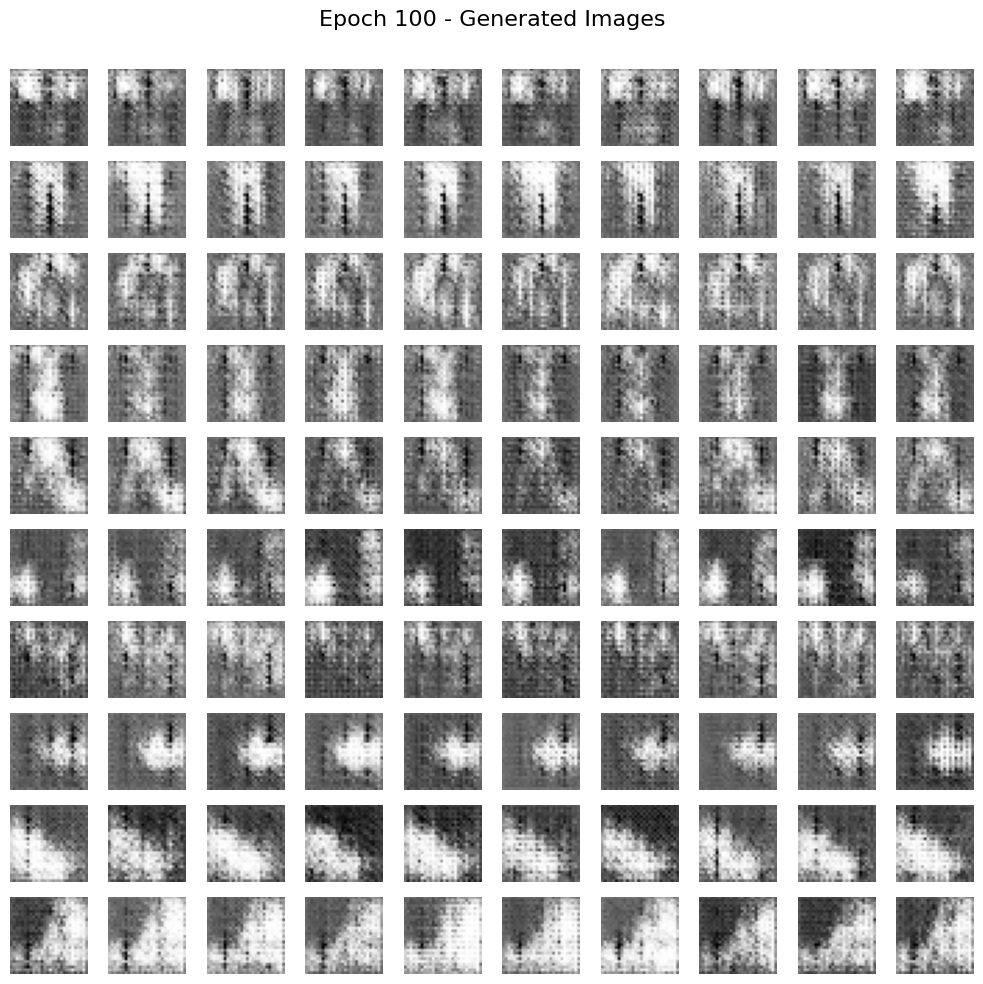

Epoch 110/2000,  GL: 0.0208, VL: 104.5981, PKLD:4.8326, KLD:0.0018, PE: 4.8326, CE: 0.0018, IA: 1.0000,  PA: 0.4160
Epoch 120/2000,  GL: 0.0168, VL: 105.0520, PKLD:4.4309, KLD:0.0014, PE: 4.4309, CE: 0.0014, IA: 1.0000,  PA: 0.4420
Epoch 130/2000,  GL: 0.0152, VL: 105.3651, PKLD:3.8650, KLD:0.0013, PE: 3.8650, CE: 0.0013, IA: 1.0000,  PA: 0.4560
Epoch 140/2000,  GL: 0.0154, VL: 106.1127, PKLD:4.2541, KLD:0.0013, PE: 4.2541, CE: 0.0013, IA: 1.0000,  PA: 0.4720
Epoch 150/2000,  GL: 0.0144, VL: 107.6433, PKLD:4.6586, KLD:0.0011, PE: 4.6586, CE: 0.0011, IA: 1.0000,  PA: 0.4440
Epoch 160/2000,  GL: 0.0115, VL: 106.1964, PKLD:3.9636, KLD:0.0009, PE: 3.9636, CE: 0.0009, IA: 1.0000,  PA: 0.4740
Epoch 170/2000,  GL: 0.0119, VL: 106.6629, PKLD:4.4313, KLD:0.0009, PE: 4.4313, CE: 0.0009, IA: 1.0000,  PA: 0.4480
Epoch 180/2000,  GL: 0.0103, VL: 105.4795, PKLD:4.4048, KLD:0.0008, PE: 4.4048, CE: 0.0008, IA: 1.0000,  PA: 0.4360
Epoch 190/2000,  GL: 0.0098, VL: 105.4600, PKLD:4.3728, KLD:0.0007, PE: 

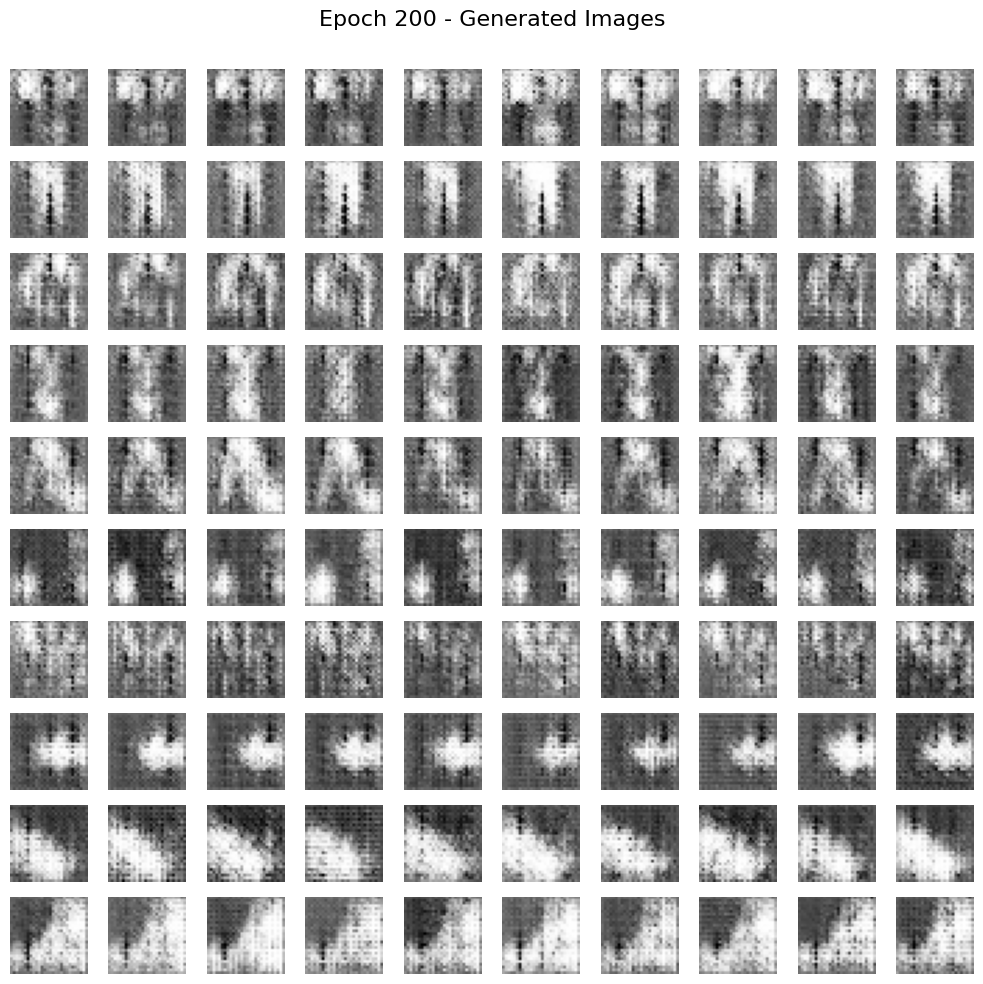

Epoch 210/2000,  GL: 0.0080, VL: 105.6298, PKLD:4.0392, KLD:0.0006, PE: 4.0392, CE: 0.0006, IA: 1.0000,  PA: 0.4740
Epoch 220/2000,  GL: 0.0079, VL: 105.2617, PKLD:3.8101, KLD:0.0006, PE: 3.8101, CE: 0.0006, IA: 1.0000,  PA: 0.5000
Epoch 230/2000,  GL: 0.0075, VL: 105.8666, PKLD:3.9030, KLD:0.0006, PE: 3.9030, CE: 0.0006, IA: 1.0000,  PA: 0.4760
Epoch 240/2000,  GL: 0.0075, VL: 103.9099, PKLD:3.7828, KLD:0.0006, PE: 3.7828, CE: 0.0006, IA: 1.0000,  PA: 0.4800
Epoch 250/2000,  GL: 0.0074, VL: 104.0077, PKLD:4.1068, KLD:0.0006, PE: 4.1068, CE: 0.0006, IA: 1.0000,  PA: 0.4640
Epoch 260/2000,  GL: 0.0068, VL: 101.8308, PKLD:3.8260, KLD:0.0005, PE: 3.8260, CE: 0.0005, IA: 1.0000,  PA: 0.4900
Epoch 270/2000,  GL: 0.0060, VL: 102.4160, PKLD:3.6131, KLD:0.0004, PE: 3.6131, CE: 0.0004, IA: 1.0000,  PA: 0.5080
Epoch 280/2000,  GL: 0.0056, VL: 101.1767, PKLD:3.3766, KLD:0.0004, PE: 3.3766, CE: 0.0004, IA: 1.0000,  PA: 0.5300
Epoch 290/2000,  GL: 0.0056, VL: 101.0797, PKLD:3.6643, KLD:0.0004, PE: 

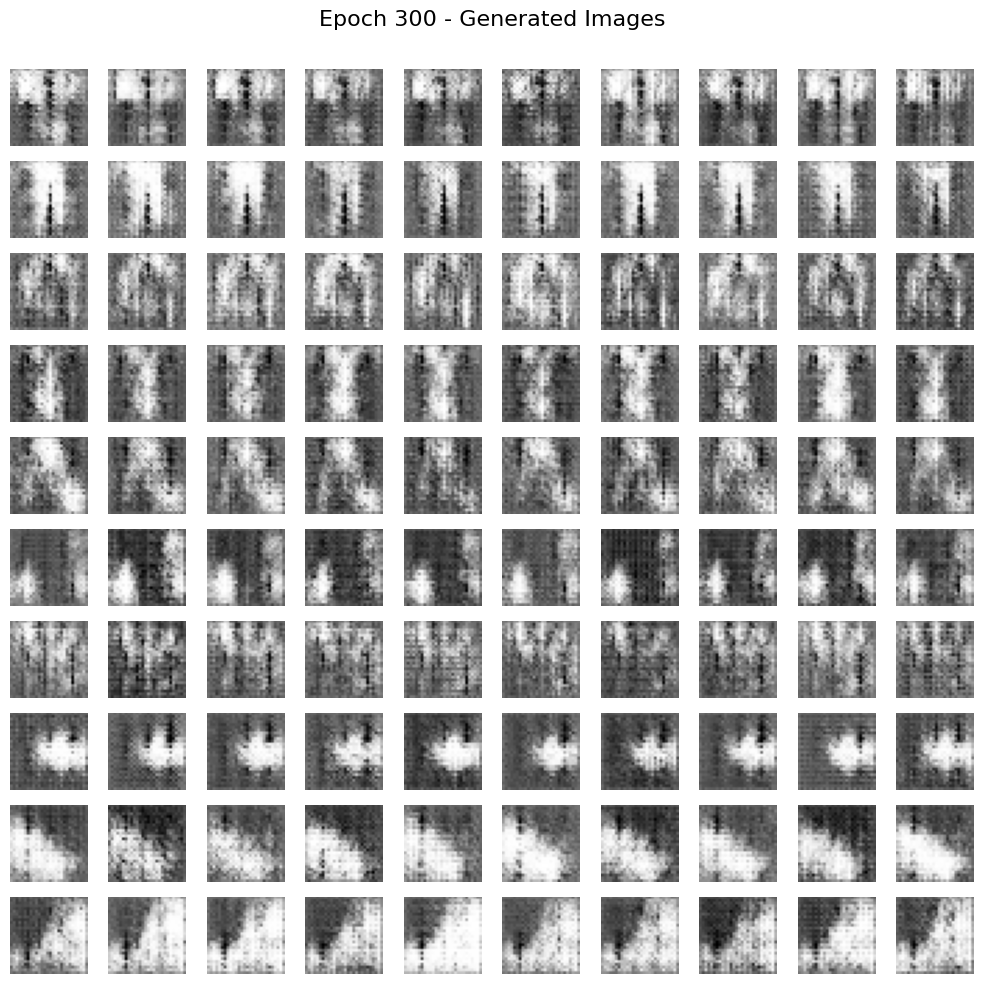

Epoch 310/2000,  GL: 0.0059, VL: 102.2759, PKLD:3.6009, KLD:0.0004, PE: 3.6009, CE: 0.0004, IA: 1.0000,  PA: 0.5200
Epoch 320/2000,  GL: 0.0053, VL: 100.3409, PKLD:4.1392, KLD:0.0004, PE: 4.1392, CE: 0.0004, IA: 1.0000,  PA: 0.4540
Epoch 330/2000,  GL: 0.0052, VL: 102.1789, PKLD:3.4271, KLD:0.0004, PE: 3.4271, CE: 0.0004, IA: 1.0000,  PA: 0.5100
Epoch 340/2000,  GL: 0.0049, VL: 98.7022, PKLD:3.6503, KLD:0.0003, PE: 3.6503, CE: 0.0003, IA: 1.0000,  PA: 0.5120
Epoch 350/2000,  GL: 0.0047, VL: 101.9064, PKLD:3.3478, KLD:0.0004, PE: 3.3478, CE: 0.0004, IA: 1.0000,  PA: 0.5220
Epoch 360/2000,  GL: 0.0045, VL: 99.4638, PKLD:3.4616, KLD:0.0003, PE: 3.4616, CE: 0.0003, IA: 1.0000,  PA: 0.5060
Epoch 370/2000,  GL: 0.0041, VL: 99.1907, PKLD:3.4789, KLD:0.0003, PE: 3.4789, CE: 0.0003, IA: 1.0000,  PA: 0.5080
Epoch 380/2000,  GL: 0.0043, VL: 99.5829, PKLD:3.2856, KLD:0.0003, PE: 3.2856, CE: 0.0003, IA: 1.0000,  PA: 0.5400
Epoch 390/2000,  GL: 0.0041, VL: 97.5587, PKLD:3.9877, KLD:0.0003, PE: 3.987

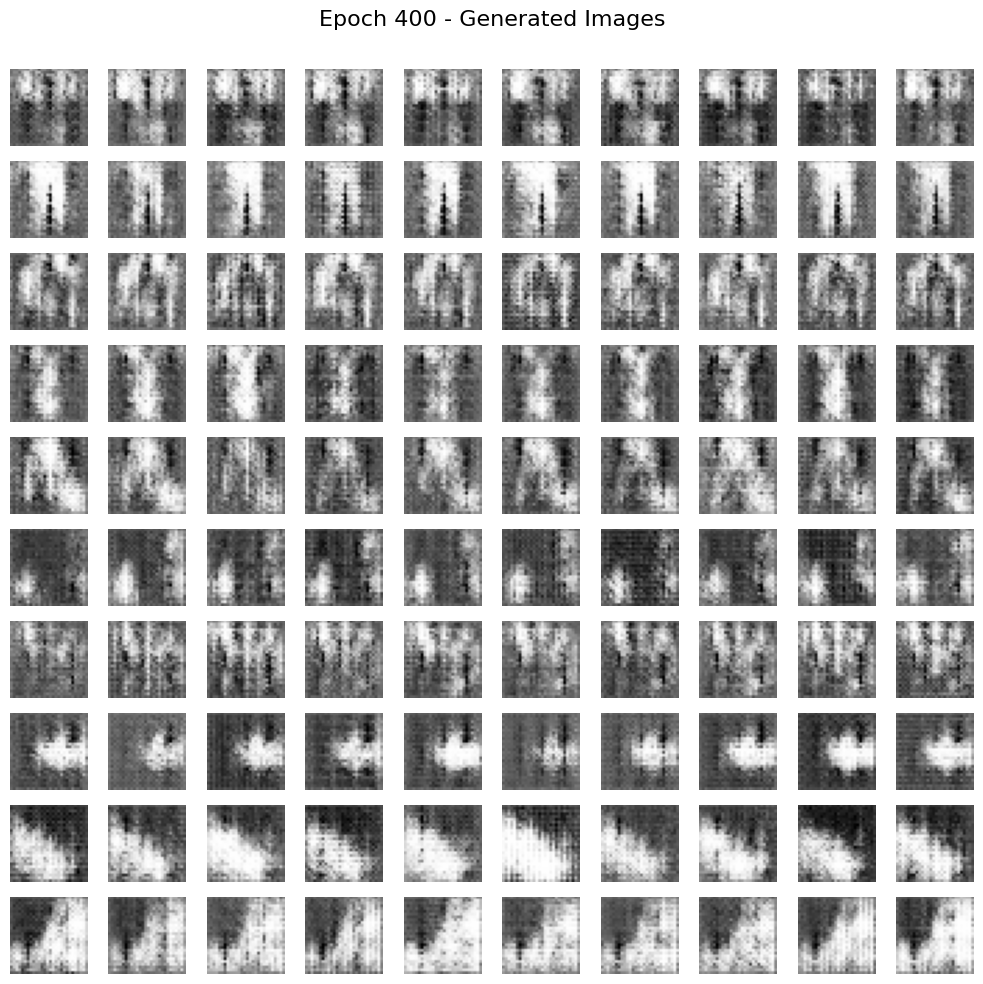

Epoch 410/2000,  GL: 0.0039, VL: 98.6971, PKLD:3.0679, KLD:0.0003, PE: 3.0679, CE: 0.0003, IA: 1.0000,  PA: 0.5920
Epoch 420/2000,  GL: 0.0039, VL: 97.0619, PKLD:3.2389, KLD:0.0003, PE: 3.2389, CE: 0.0003, IA: 1.0000,  PA: 0.5360
Epoch 430/2000,  GL: 0.0039, VL: 99.1441, PKLD:3.2984, KLD:0.0003, PE: 3.2984, CE: 0.0003, IA: 1.0000,  PA: 0.5020
Epoch 440/2000,  GL: 0.0035, VL: 95.7169, PKLD:3.3894, KLD:0.0003, PE: 3.3894, CE: 0.0003, IA: 1.0000,  PA: 0.5080
Epoch 450/2000,  GL: 0.0036, VL: 95.3153, PKLD:3.4631, KLD:0.0002, PE: 3.4631, CE: 0.0002, IA: 1.0000,  PA: 0.5260
Epoch 460/2000,  GL: 0.0037, VL: 97.7742, PKLD:3.5555, KLD:0.0003, PE: 3.5555, CE: 0.0003, IA: 1.0000,  PA: 0.5180
Epoch 470/2000,  GL: 0.0033, VL: 97.5826, PKLD:3.3844, KLD:0.0002, PE: 3.3844, CE: 0.0002, IA: 1.0000,  PA: 0.5180
Epoch 480/2000,  GL: 0.0040, VL: 94.8356, PKLD:3.8922, KLD:0.0003, PE: 3.8922, CE: 0.0003, IA: 1.0000,  PA: 0.5040
Epoch 490/2000,  GL: 0.0033, VL: 96.1278, PKLD:3.3923, KLD:0.0002, PE: 3.3923, C

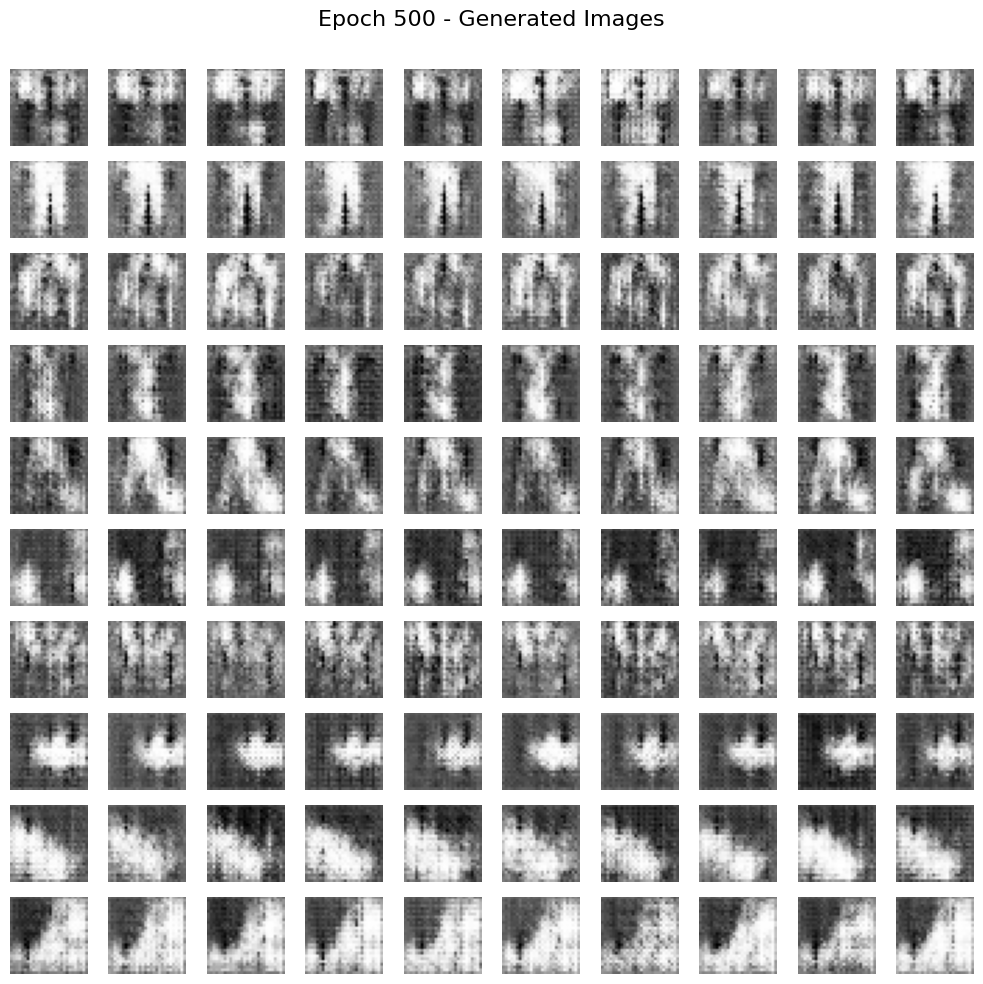

Epoch 510/2000,  GL: 0.0031, VL: 94.7856, PKLD:3.2484, KLD:0.0002, PE: 3.2484, CE: 0.0002, IA: 1.0000,  PA: 0.5320
Epoch 520/2000,  GL: 0.0031, VL: 92.4716, PKLD:3.8396, KLD:0.0002, PE: 3.8396, CE: 0.0002, IA: 1.0000,  PA: 0.5020
Epoch 530/2000,  GL: 0.0030, VL: 93.5033, PKLD:3.1797, KLD:0.0002, PE: 3.1797, CE: 0.0002, IA: 1.0000,  PA: 0.5480
Epoch 540/2000,  GL: 0.0035, VL: 94.6287, PKLD:3.1410, KLD:0.0002, PE: 3.1410, CE: 0.0002, IA: 1.0000,  PA: 0.5560
Epoch 550/2000,  GL: 0.0027, VL: 93.5904, PKLD:3.2238, KLD:0.0002, PE: 3.2238, CE: 0.0002, IA: 1.0000,  PA: 0.5480
Epoch 560/2000,  GL: 0.0031, VL: 90.2440, PKLD:3.1139, KLD:0.0002, PE: 3.1139, CE: 0.0002, IA: 1.0000,  PA: 0.5500
Epoch 570/2000,  GL: 0.0026, VL: 93.2432, PKLD:3.4037, KLD:0.0002, PE: 3.4037, CE: 0.0002, IA: 1.0000,  PA: 0.5260
Epoch 580/2000,  GL: 0.0029, VL: 91.3374, PKLD:3.0982, KLD:0.0002, PE: 3.0982, CE: 0.0002, IA: 1.0000,  PA: 0.5460
Epoch 590/2000,  GL: 0.0027, VL: 91.8728, PKLD:2.9619, KLD:0.0002, PE: 2.9619, C

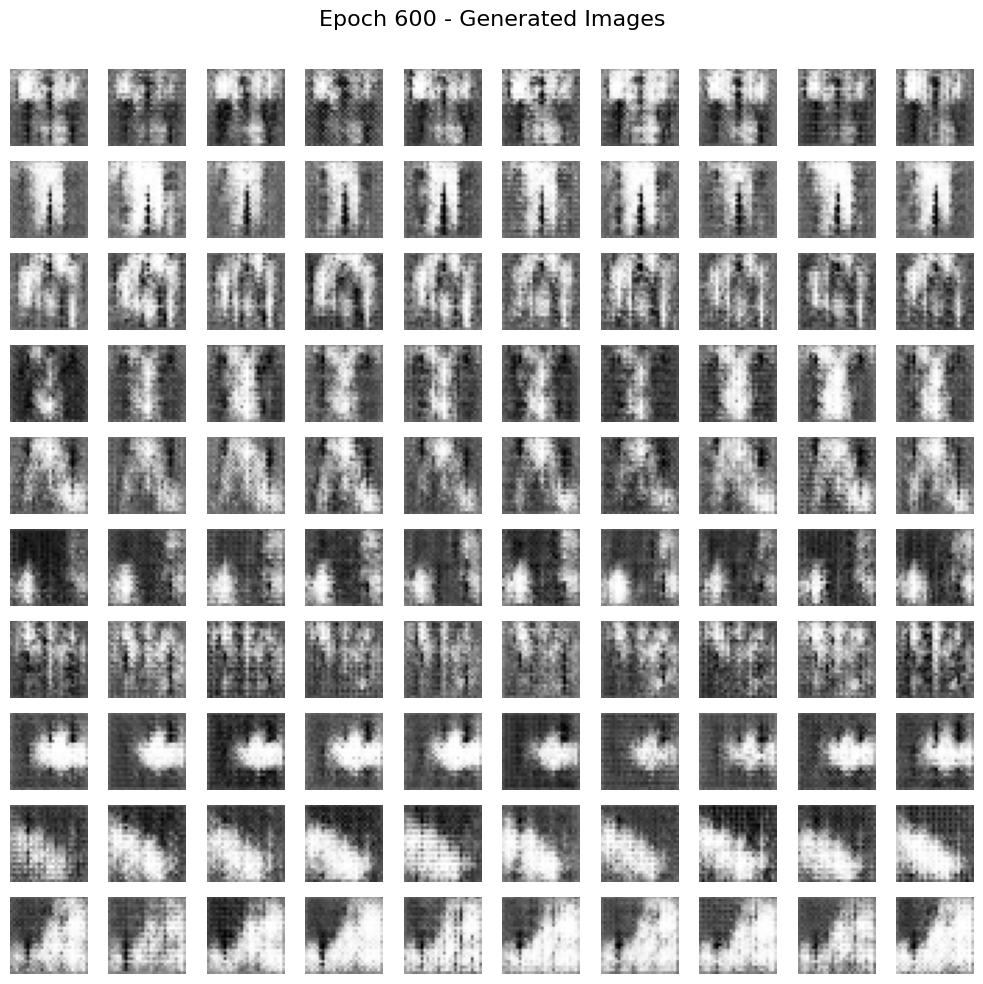

Epoch 610/2000,  GL: 0.0029, VL: 90.8136, PKLD:3.1946, KLD:0.0002, PE: 3.1946, CE: 0.0002, IA: 1.0000,  PA: 0.5380
Epoch 620/2000,  GL: 0.0026, VL: 91.2407, PKLD:3.0989, KLD:0.0002, PE: 3.0989, CE: 0.0002, IA: 1.0000,  PA: 0.5540
Epoch 630/2000,  GL: 0.0025, VL: 88.4442, PKLD:2.8698, KLD:0.0002, PE: 2.8698, CE: 0.0002, IA: 1.0000,  PA: 0.5500
Epoch 640/2000,  GL: 0.0024, VL: 90.2616, PKLD:3.0291, KLD:0.0002, PE: 3.0291, CE: 0.0002, IA: 1.0000,  PA: 0.5340
Epoch 650/2000,  GL: 0.0025, VL: 89.2944, PKLD:3.2962, KLD:0.0002, PE: 3.2962, CE: 0.0002, IA: 1.0000,  PA: 0.5420
Epoch 660/2000,  GL: 0.0024, VL: 88.6342, PKLD:3.4433, KLD:0.0002, PE: 3.4433, CE: 0.0002, IA: 1.0000,  PA: 0.5280
Epoch 670/2000,  GL: 0.0027, VL: 89.2996, PKLD:3.1140, KLD:0.0002, PE: 3.1140, CE: 0.0002, IA: 1.0000,  PA: 0.5560
Epoch 680/2000,  GL: 0.0024, VL: 89.7462, PKLD:3.3664, KLD:0.0002, PE: 3.3664, CE: 0.0002, IA: 1.0000,  PA: 0.5340
Epoch 690/2000,  GL: 0.0024, VL: 88.3016, PKLD:3.1336, KLD:0.0002, PE: 3.1336, C

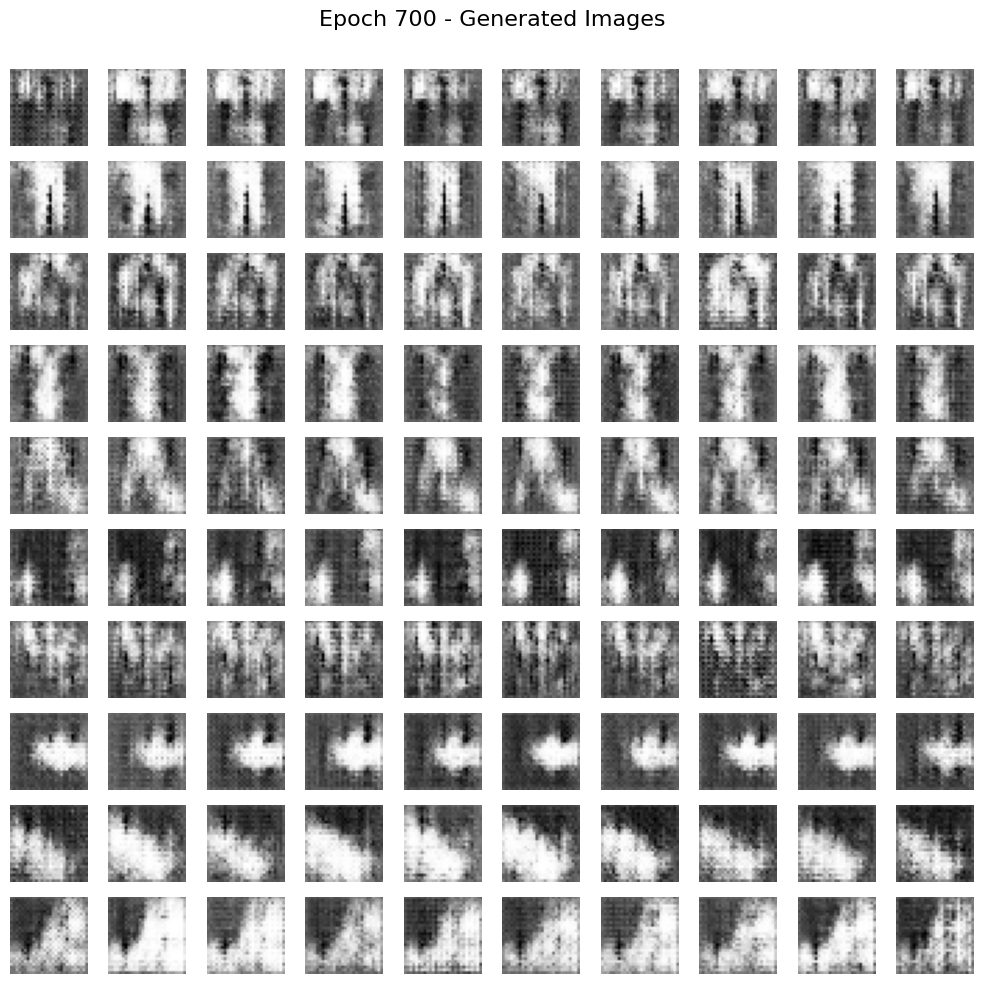

Epoch 710/2000,  GL: 0.0021, VL: 89.2788, PKLD:2.9929, KLD:0.0001, PE: 2.9929, CE: 0.0001, IA: 1.0000,  PA: 0.5700
Epoch 720/2000,  GL: 0.0027, VL: 88.0594, PKLD:3.0940, KLD:0.0002, PE: 3.0940, CE: 0.0002, IA: 1.0000,  PA: 0.5660
Epoch 730/2000,  GL: 0.0026, VL: 89.9859, PKLD:2.8502, KLD:0.0002, PE: 2.8502, CE: 0.0002, IA: 1.0000,  PA: 0.5840
Epoch 740/2000,  GL: 0.0026, VL: 87.8577, PKLD:3.0407, KLD:0.0002, PE: 3.0407, CE: 0.0002, IA: 1.0000,  PA: 0.5480
Epoch 750/2000,  GL: 0.0022, VL: 88.9596, PKLD:2.4177, KLD:0.0002, PE: 2.4177, CE: 0.0002, IA: 1.0000,  PA: 0.6220
Epoch 760/2000,  GL: 0.0022, VL: 86.4184, PKLD:3.5289, KLD:0.0001, PE: 3.5289, CE: 0.0001, IA: 1.0000,  PA: 0.5140
Epoch 770/2000,  GL: 0.0022, VL: 88.0538, PKLD:3.0664, KLD:0.0002, PE: 3.0664, CE: 0.0002, IA: 1.0000,  PA: 0.5480
Epoch 780/2000,  GL: 0.0025, VL: 85.8354, PKLD:3.4783, KLD:0.0002, PE: 3.4783, CE: 0.0002, IA: 1.0000,  PA: 0.5200
Epoch 790/2000,  GL: 0.0021, VL: 86.9463, PKLD:3.2004, KLD:0.0001, PE: 3.2004, C

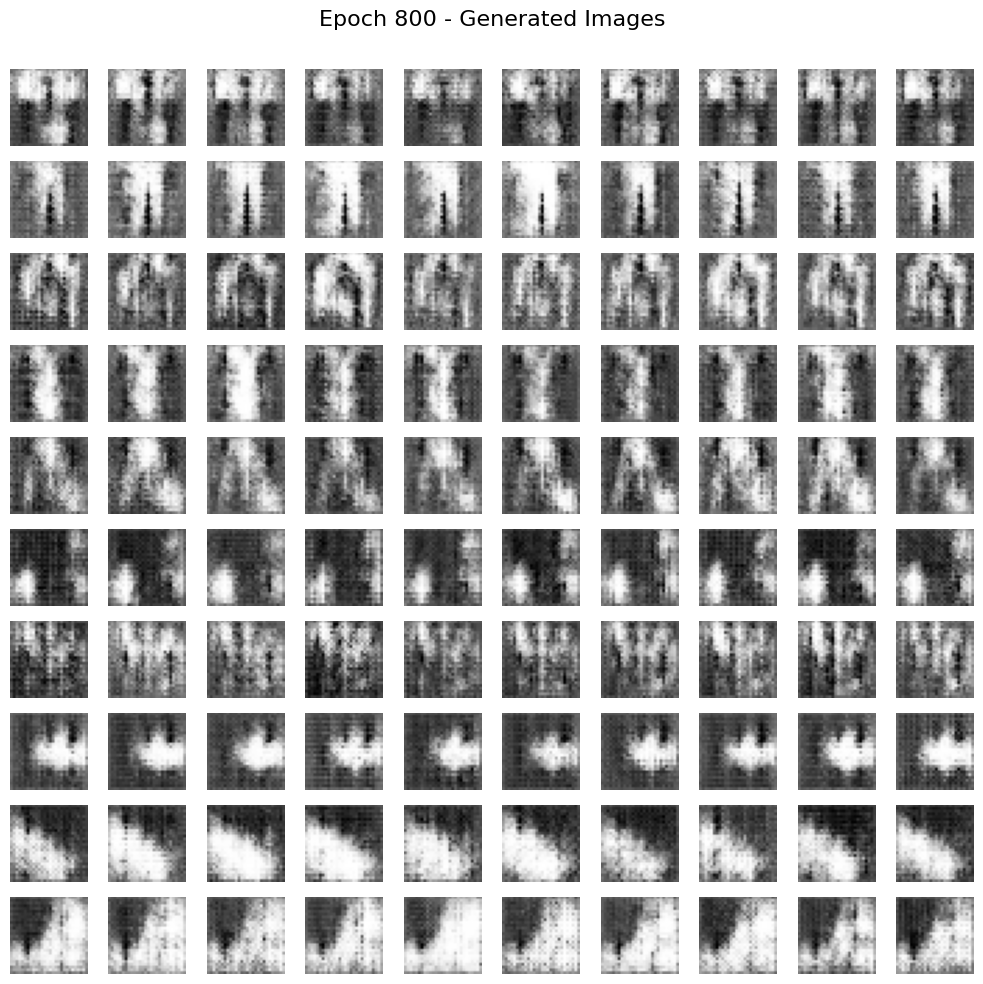

Epoch 810/2000,  GL: 0.0023, VL: 86.1224, PKLD:3.2930, KLD:0.0002, PE: 3.2930, CE: 0.0002, IA: 1.0000,  PA: 0.5680
Epoch 820/2000,  GL: 0.0021, VL: 85.5480, PKLD:3.0963, KLD:0.0001, PE: 3.0963, CE: 0.0001, IA: 1.0000,  PA: 0.5740
Epoch 830/2000,  GL: 0.0024, VL: 85.6158, PKLD:3.2434, KLD:0.0002, PE: 3.2434, CE: 0.0002, IA: 1.0000,  PA: 0.5440
Epoch 840/2000,  GL: 0.0028, VL: 85.5220, PKLD:2.9074, KLD:0.0002, PE: 2.9074, CE: 0.0002, IA: 1.0000,  PA: 0.5720
Epoch 850/2000,  GL: 0.0020, VL: 86.5184, PKLD:2.8107, KLD:0.0001, PE: 2.8107, CE: 0.0001, IA: 1.0000,  PA: 0.6060
Epoch 860/2000,  GL: 0.0020, VL: 86.5040, PKLD:2.9981, KLD:0.0001, PE: 2.9981, CE: 0.0001, IA: 1.0000,  PA: 0.5560
Epoch 870/2000,  GL: 0.0021, VL: 85.4800, PKLD:3.3062, KLD:0.0001, PE: 3.3062, CE: 0.0001, IA: 1.0000,  PA: 0.5380
Epoch 880/2000,  GL: 0.0021, VL: 86.5361, PKLD:2.8909, KLD:0.0001, PE: 2.8909, CE: 0.0001, IA: 1.0000,  PA: 0.5800
Epoch 890/2000,  GL: 0.0020, VL: 86.9274, PKLD:3.1151, KLD:0.0001, PE: 3.1151, C

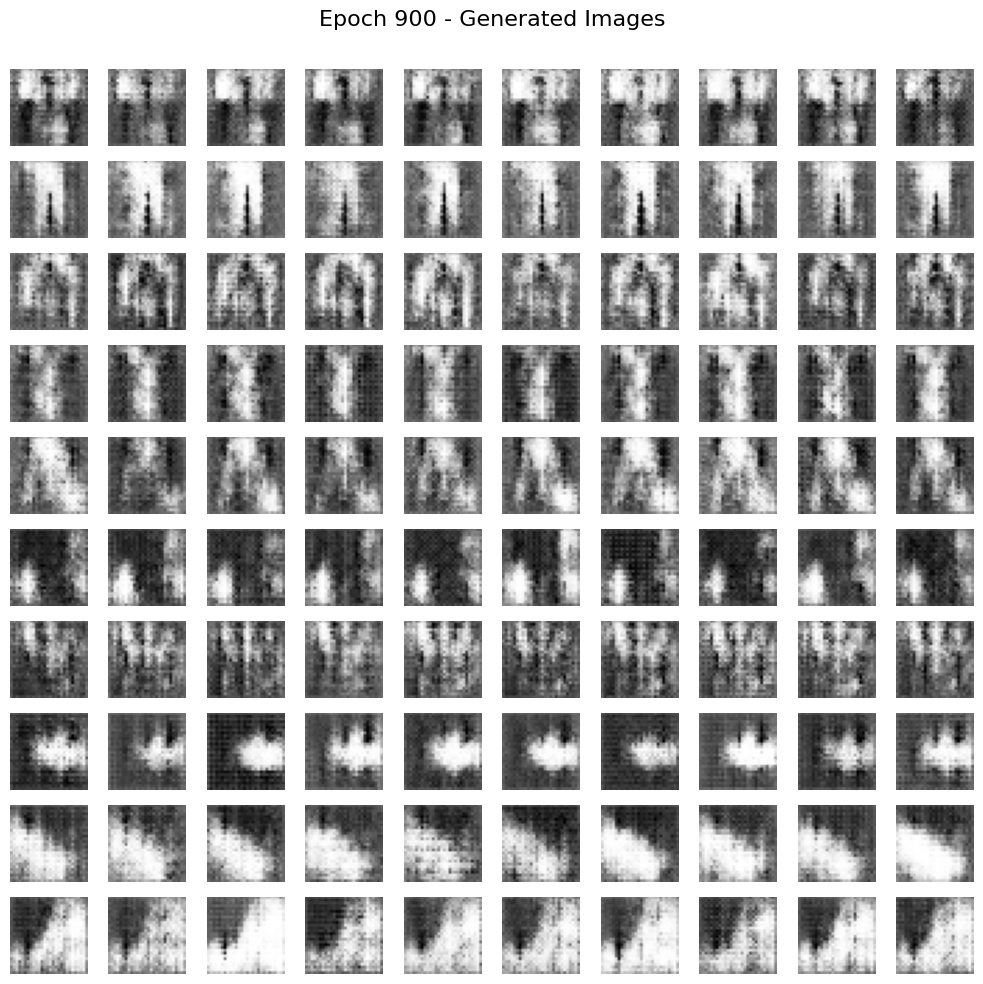

Epoch 910/2000,  GL: 0.0027, VL: 83.5862, PKLD:2.9874, KLD:0.0002, PE: 2.9874, CE: 0.0002, IA: 1.0000,  PA: 0.5560
Epoch 920/2000,  GL: 0.0019, VL: 84.6130, PKLD:2.6975, KLD:0.0001, PE: 2.6975, CE: 0.0001, IA: 1.0000,  PA: 0.5980
Epoch 930/2000,  GL: 0.0019, VL: 84.3295, PKLD:2.6591, KLD:0.0001, PE: 2.6591, CE: 0.0001, IA: 1.0000,  PA: 0.6020
Epoch 940/2000,  GL: 0.0020, VL: 83.0030, PKLD:3.1383, KLD:0.0001, PE: 3.1383, CE: 0.0001, IA: 1.0000,  PA: 0.5540
Epoch 950/2000,  GL: 0.0021, VL: 84.5200, PKLD:3.1546, KLD:0.0001, PE: 3.1546, CE: 0.0001, IA: 1.0000,  PA: 0.5360
Epoch 960/2000,  GL: 0.0019, VL: 85.0079, PKLD:2.5199, KLD:0.0001, PE: 2.5199, CE: 0.0001, IA: 1.0000,  PA: 0.6260
Epoch 970/2000,  GL: 0.0019, VL: 84.4082, PKLD:2.6825, KLD:0.0001, PE: 2.6825, CE: 0.0001, IA: 1.0000,  PA: 0.5960
Epoch 980/2000,  GL: 0.0020, VL: 82.4113, PKLD:2.8752, KLD:0.0001, PE: 2.8752, CE: 0.0001, IA: 1.0000,  PA: 0.5720
Epoch 990/2000,  GL: 0.0021, VL: 83.9127, PKLD:3.0082, KLD:0.0001, PE: 3.0082, C

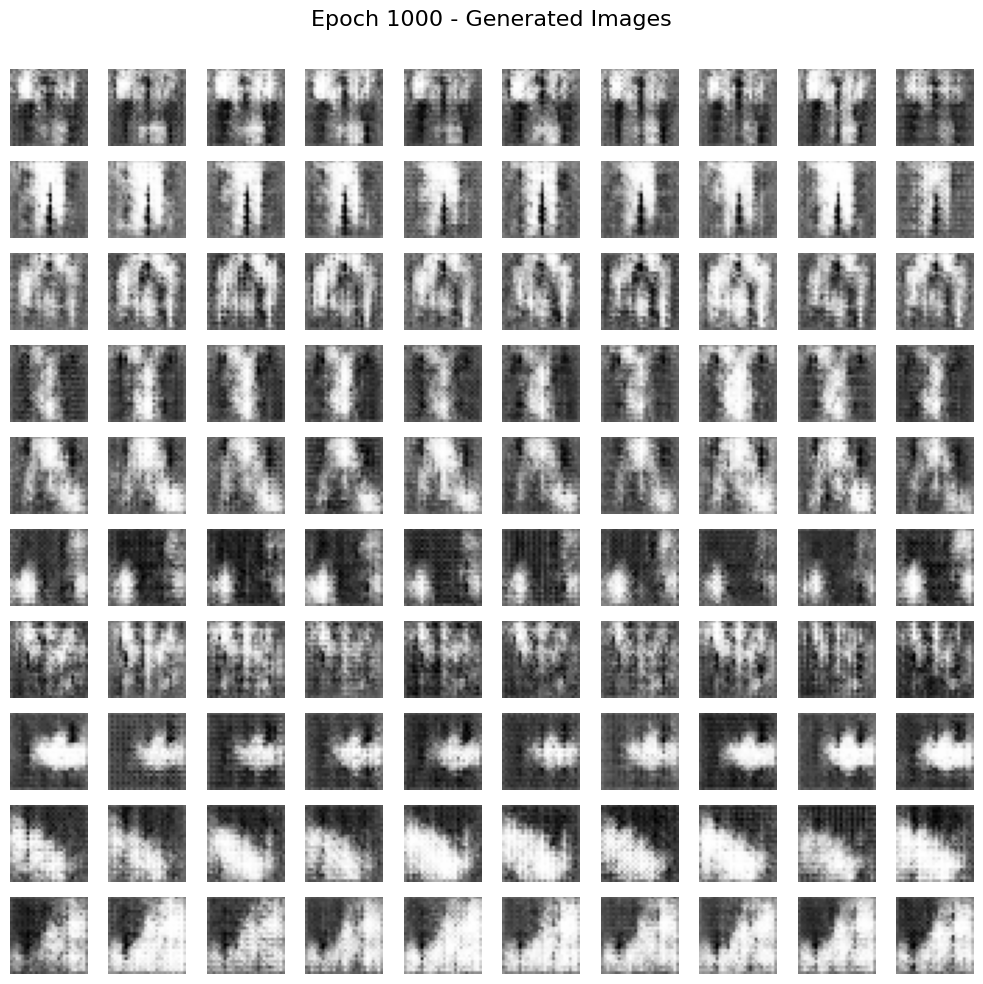

Epoch 1010/2000,  GL: 0.0019, VL: 82.7329, PKLD:3.1744, KLD:0.0001, PE: 3.1744, CE: 0.0001, IA: 1.0000,  PA: 0.5440
Epoch 1020/2000,  GL: 0.0021, VL: 81.8522, PKLD:3.4357, KLD:0.0001, PE: 3.4357, CE: 0.0001, IA: 1.0000,  PA: 0.5280
Epoch 1030/2000,  GL: 0.0018, VL: 83.5533, PKLD:2.8960, KLD:0.0001, PE: 2.8960, CE: 0.0001, IA: 1.0000,  PA: 0.5880
Epoch 1040/2000,  GL: 0.0021, VL: 82.7469, PKLD:3.1436, KLD:0.0001, PE: 3.1436, CE: 0.0001, IA: 1.0000,  PA: 0.5400
Epoch 1050/2000,  GL: 0.0017, VL: 82.3787, PKLD:3.0059, KLD:0.0001, PE: 3.0059, CE: 0.0001, IA: 1.0000,  PA: 0.5360
Epoch 1060/2000,  GL: 0.0017, VL: 82.9031, PKLD:3.1799, KLD:0.0001, PE: 3.1799, CE: 0.0001, IA: 1.0000,  PA: 0.5280
Epoch 1070/2000,  GL: 0.0020, VL: 82.1259, PKLD:2.9196, KLD:0.0001, PE: 2.9196, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1080/2000,  GL: 0.0019, VL: 83.3024, PKLD:2.6962, KLD:0.0001, PE: 2.6962, CE: 0.0001, IA: 1.0000,  PA: 0.5960
Epoch 1090/2000,  GL: 0.0018, VL: 83.7772, PKLD:3.2091, KLD:0.0001, PE: 

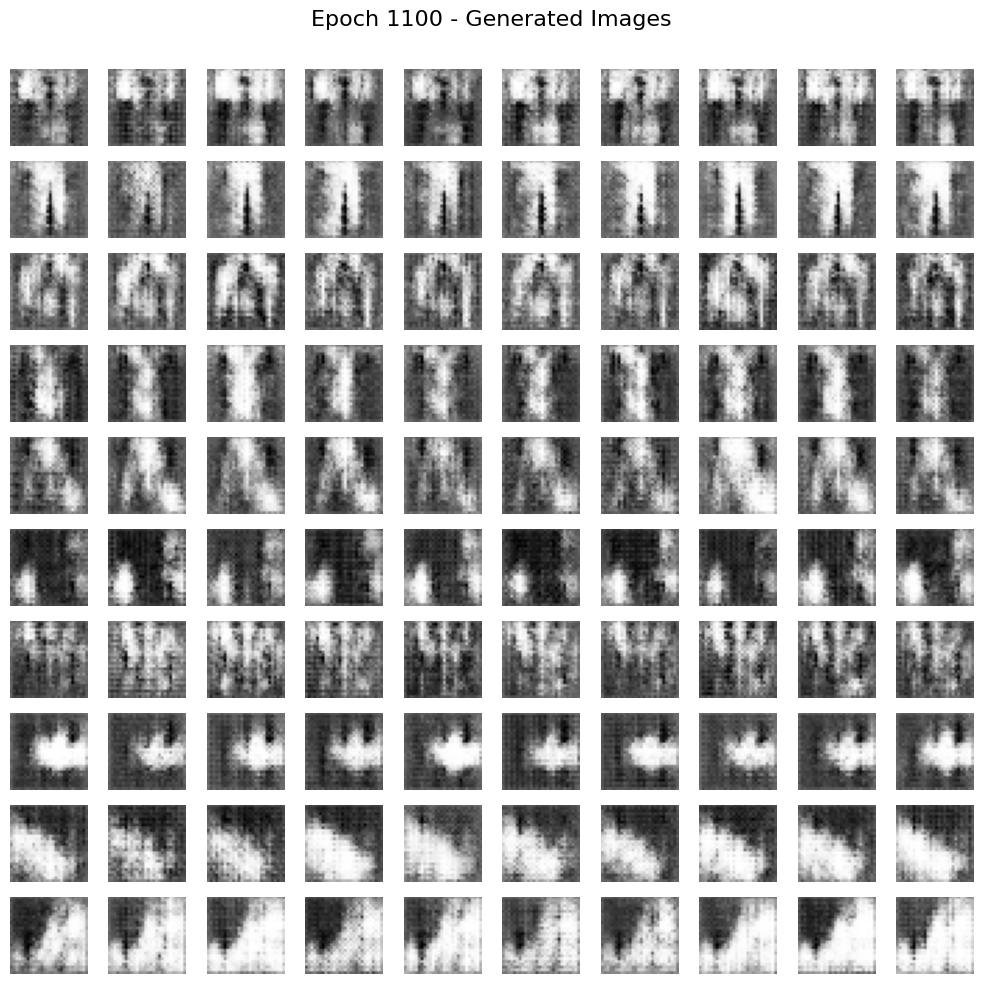

Epoch 1110/2000,  GL: 0.0018, VL: 81.4286, PKLD:3.1961, KLD:0.0001, PE: 3.1961, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1120/2000,  GL: 0.0019, VL: 81.6086, PKLD:3.2828, KLD:0.0001, PE: 3.2828, CE: 0.0001, IA: 1.0000,  PA: 0.5060
Epoch 1130/2000,  GL: 0.0018, VL: 83.3292, PKLD:2.8790, KLD:0.0001, PE: 2.8790, CE: 0.0001, IA: 1.0000,  PA: 0.5520
Epoch 1140/2000,  GL: 0.0017, VL: 83.4424, PKLD:2.7429, KLD:0.0001, PE: 2.7429, CE: 0.0001, IA: 1.0000,  PA: 0.5840
Epoch 1150/2000,  GL: 0.0018, VL: 81.7190, PKLD:2.6761, KLD:0.0001, PE: 2.6761, CE: 0.0001, IA: 1.0000,  PA: 0.5700
Epoch 1160/2000,  GL: 0.0019, VL: 81.1672, PKLD:2.8762, KLD:0.0001, PE: 2.8762, CE: 0.0001, IA: 1.0000,  PA: 0.5660
Epoch 1170/2000,  GL: 0.0018, VL: 82.2698, PKLD:2.9303, KLD:0.0001, PE: 2.9303, CE: 0.0001, IA: 1.0000,  PA: 0.5920
Epoch 1180/2000,  GL: 0.0018, VL: 82.3772, PKLD:3.0252, KLD:0.0001, PE: 3.0252, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1190/2000,  GL: 0.0018, VL: 81.2504, PKLD:2.9471, KLD:0.0001, PE: 

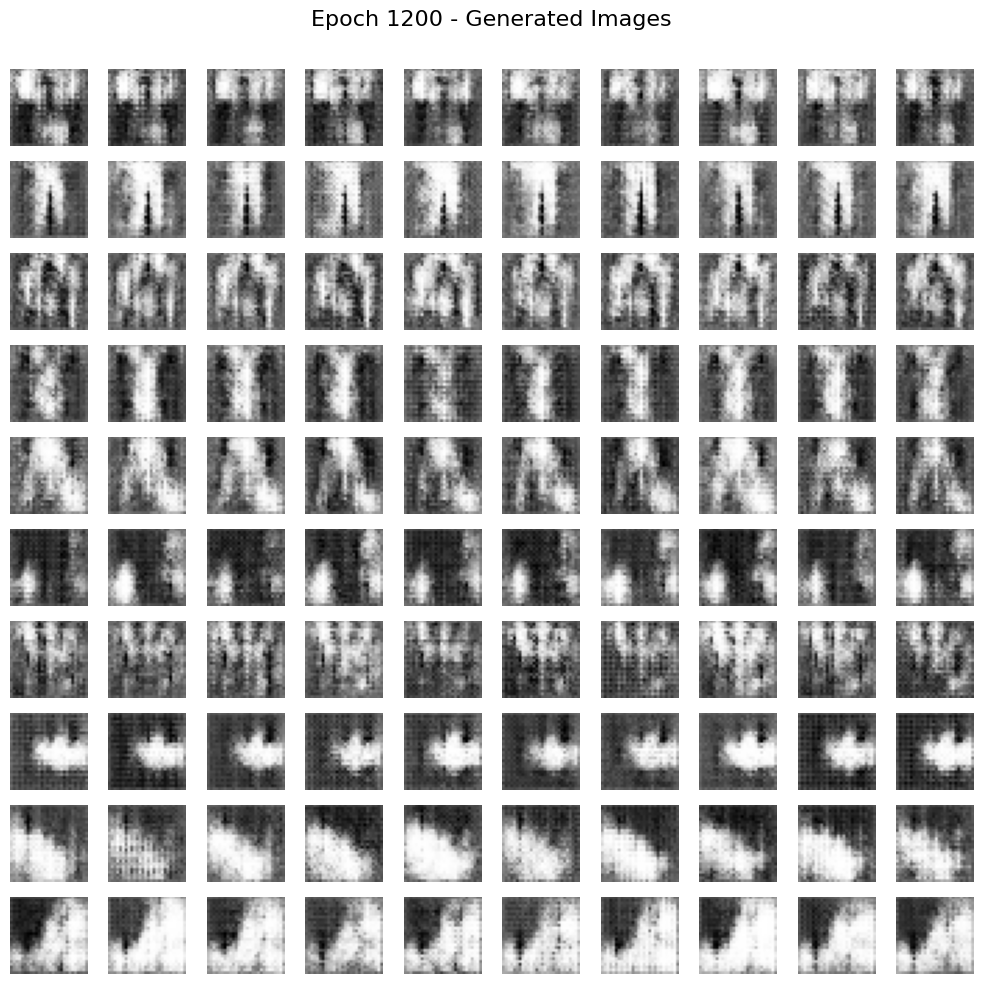

Epoch 1210/2000,  GL: 0.0020, VL: 82.3923, PKLD:3.3069, KLD:0.0001, PE: 3.3069, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1220/2000,  GL: 0.0017, VL: 83.9579, PKLD:2.9799, KLD:0.0001, PE: 2.9799, CE: 0.0001, IA: 1.0000,  PA: 0.5880
Epoch 1230/2000,  GL: 0.0017, VL: 85.1914, PKLD:2.8696, KLD:0.0001, PE: 2.8696, CE: 0.0001, IA: 1.0000,  PA: 0.5840
Epoch 1240/2000,  GL: 0.0015, VL: 80.8762, PKLD:2.8154, KLD:0.0001, PE: 2.8154, CE: 0.0001, IA: 1.0000,  PA: 0.5820
Epoch 1250/2000,  GL: 0.0020, VL: 83.5621, PKLD:3.1258, KLD:0.0001, PE: 3.1258, CE: 0.0001, IA: 1.0000,  PA: 0.5500
Epoch 1260/2000,  GL: 0.0020, VL: 83.1533, PKLD:3.0199, KLD:0.0001, PE: 3.0199, CE: 0.0001, IA: 1.0000,  PA: 0.5920
Epoch 1270/2000,  GL: 0.0018, VL: 81.6723, PKLD:2.8137, KLD:0.0001, PE: 2.8137, CE: 0.0001, IA: 1.0000,  PA: 0.5620
Epoch 1280/2000,  GL: 0.0019, VL: 81.2312, PKLD:3.5738, KLD:0.0001, PE: 3.5738, CE: 0.0001, IA: 1.0000,  PA: 0.5160
Epoch 1290/2000,  GL: 0.0018, VL: 81.5620, PKLD:2.8724, KLD:0.0001, PE: 

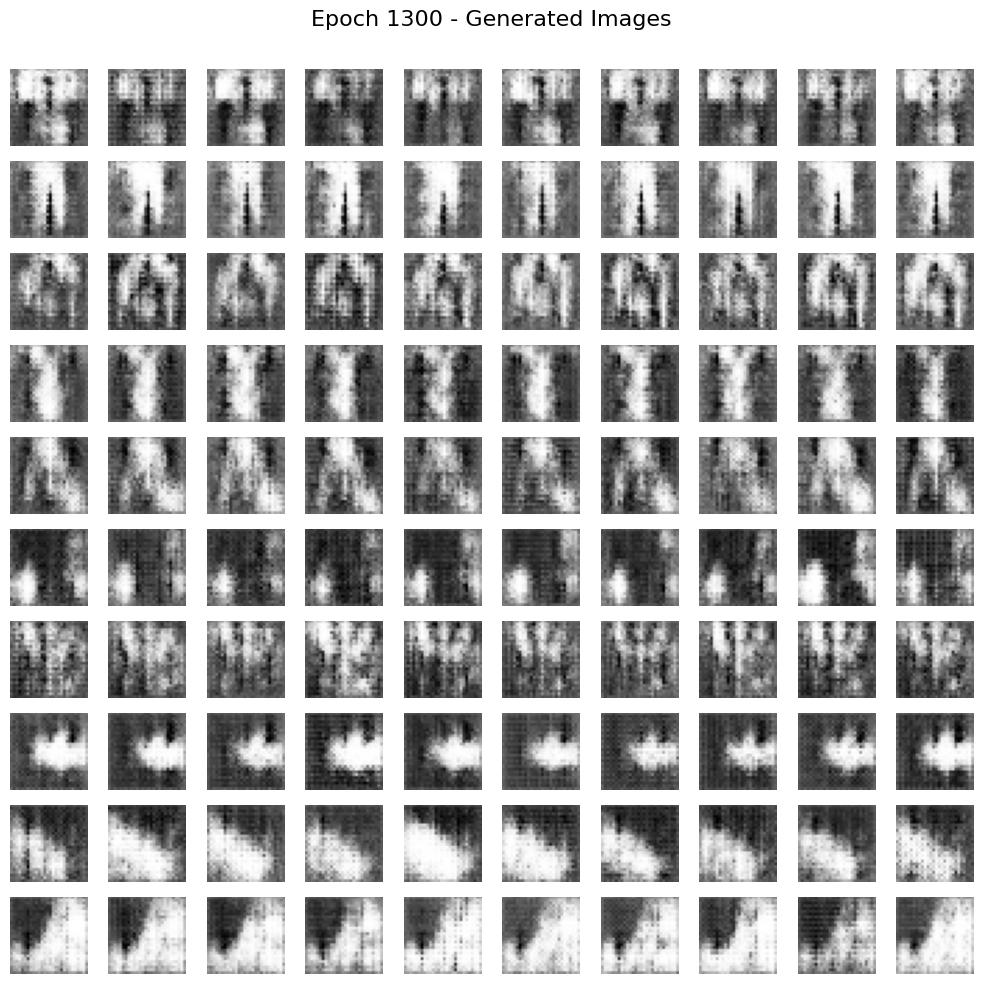

Epoch 1310/2000,  GL: 0.0018, VL: 82.6525, PKLD:2.9682, KLD:0.0001, PE: 2.9682, CE: 0.0001, IA: 1.0000,  PA: 0.5780
Epoch 1320/2000,  GL: 0.0017, VL: 82.0612, PKLD:2.6529, KLD:0.0001, PE: 2.6529, CE: 0.0001, IA: 1.0000,  PA: 0.6080
Epoch 1330/2000,  GL: 0.0018, VL: 81.4170, PKLD:2.9933, KLD:0.0001, PE: 2.9933, CE: 0.0001, IA: 1.0000,  PA: 0.5720
Epoch 1340/2000,  GL: 0.0019, VL: 81.7219, PKLD:2.9959, KLD:0.0001, PE: 2.9959, CE: 0.0001, IA: 1.0000,  PA: 0.5780
Epoch 1350/2000,  GL: 0.0019, VL: 82.1091, PKLD:3.1510, KLD:0.0001, PE: 3.1510, CE: 0.0001, IA: 1.0000,  PA: 0.5640
Epoch 1360/2000,  GL: 0.0019, VL: 79.9769, PKLD:2.8106, KLD:0.0001, PE: 2.8106, CE: 0.0001, IA: 1.0000,  PA: 0.5800
Epoch 1370/2000,  GL: 0.0018, VL: 82.8368, PKLD:3.2087, KLD:0.0001, PE: 3.2087, CE: 0.0001, IA: 1.0000,  PA: 0.5620
Epoch 1380/2000,  GL: 0.0020, VL: 81.9501, PKLD:3.0372, KLD:0.0001, PE: 3.0372, CE: 0.0001, IA: 1.0000,  PA: 0.5400
Epoch 1390/2000,  GL: 0.0017, VL: 81.6029, PKLD:2.9044, KLD:0.0001, PE: 

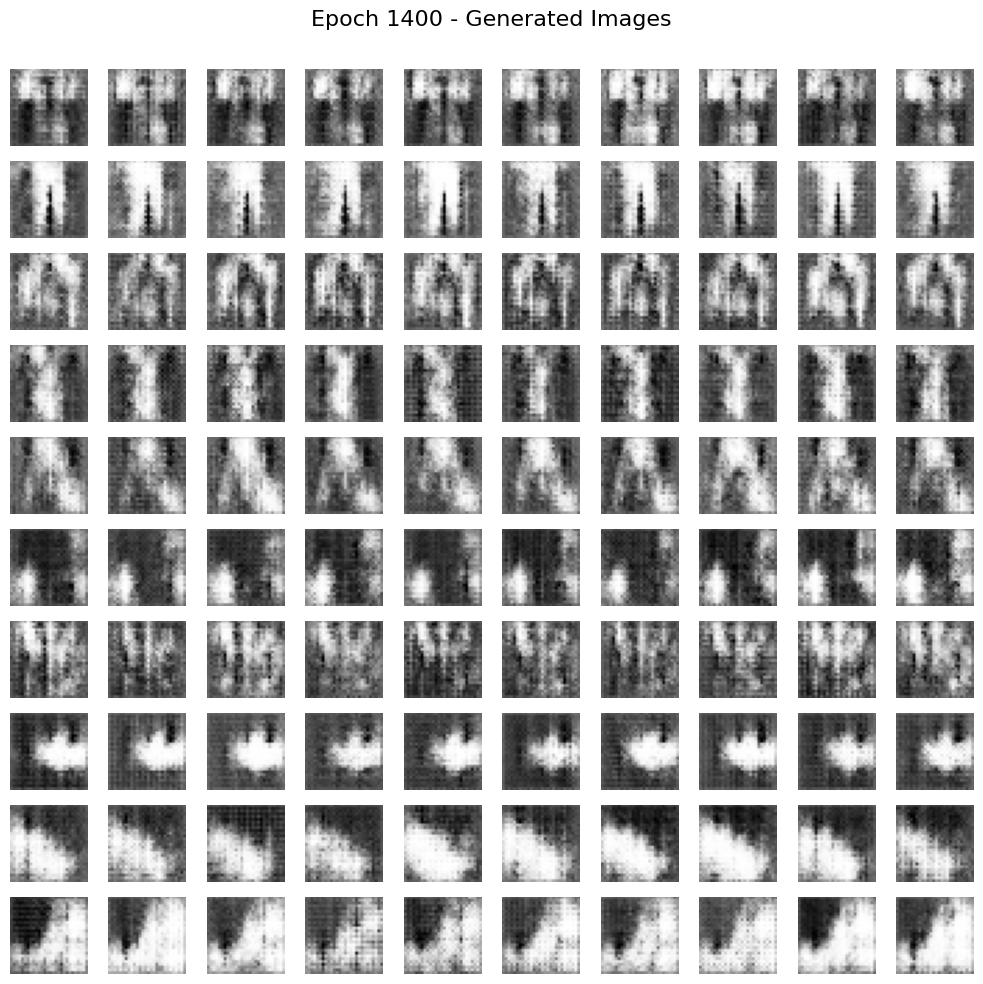

Epoch 1410/2000,  GL: 0.0016, VL: 81.4774, PKLD:2.9607, KLD:0.0001, PE: 2.9607, CE: 0.0001, IA: 1.0000,  PA: 0.5780
Epoch 1420/2000,  GL: 0.0020, VL: 80.0873, PKLD:2.8868, KLD:0.0001, PE: 2.8868, CE: 0.0001, IA: 1.0000,  PA: 0.5700
Epoch 1430/2000,  GL: 0.0019, VL: 82.5246, PKLD:2.7448, KLD:0.0001, PE: 2.7448, CE: 0.0001, IA: 1.0000,  PA: 0.6120
Epoch 1440/2000,  GL: 0.0021, VL: 80.2561, PKLD:2.8336, KLD:0.0001, PE: 2.8336, CE: 0.0001, IA: 1.0000,  PA: 0.5920
Epoch 1450/2000,  GL: 0.0018, VL: 82.4675, PKLD:2.9739, KLD:0.0001, PE: 2.9739, CE: 0.0001, IA: 1.0000,  PA: 0.5920
Epoch 1460/2000,  GL: 0.0016, VL: 81.0494, PKLD:2.7849, KLD:0.0001, PE: 2.7849, CE: 0.0001, IA: 1.0000,  PA: 0.5940
Epoch 1470/2000,  GL: 0.0017, VL: 82.6203, PKLD:3.1327, KLD:0.0001, PE: 3.1327, CE: 0.0001, IA: 1.0000,  PA: 0.5540
Epoch 1480/2000,  GL: 0.0017, VL: 82.0270, PKLD:3.3450, KLD:0.0001, PE: 3.3450, CE: 0.0001, IA: 1.0000,  PA: 0.5300
Epoch 1490/2000,  GL: 0.0018, VL: 82.0299, PKLD:2.6516, KLD:0.0001, PE: 

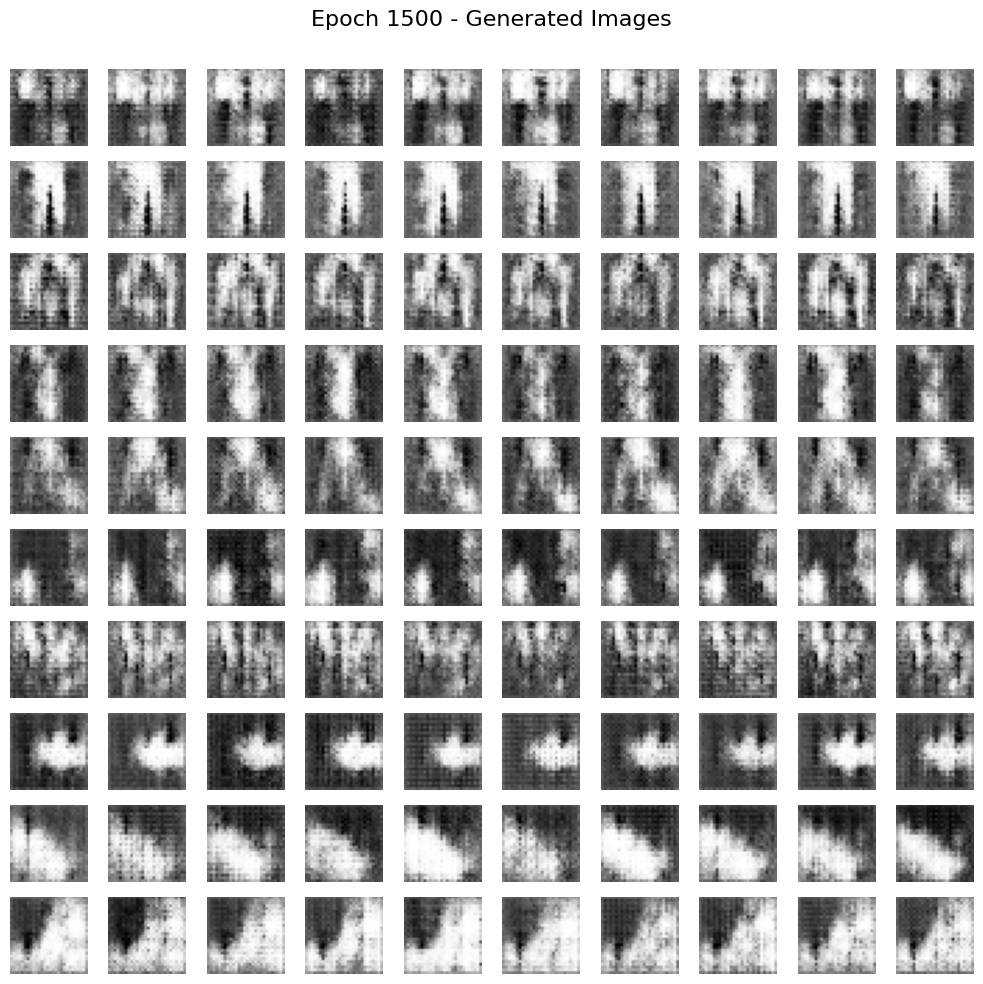

Epoch 1510/2000,  GL: 0.0019, VL: 80.7328, PKLD:2.9708, KLD:0.0001, PE: 2.9708, CE: 0.0001, IA: 1.0000,  PA: 0.5860
Epoch 1520/2000,  GL: 0.0018, VL: 82.1152, PKLD:3.0656, KLD:0.0001, PE: 3.0656, CE: 0.0001, IA: 1.0000,  PA: 0.5860
Epoch 1530/2000,  GL: 0.0018, VL: 79.1887, PKLD:3.2196, KLD:0.0001, PE: 3.2196, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1540/2000,  GL: 0.0019, VL: 79.8173, PKLD:3.4016, KLD:0.0001, PE: 3.4016, CE: 0.0001, IA: 1.0000,  PA: 0.5420
Epoch 1550/2000,  GL: 0.0019, VL: 85.0145, PKLD:2.9996, KLD:0.0001, PE: 2.9996, CE: 0.0001, IA: 1.0000,  PA: 0.5900
Epoch 1560/2000,  GL: 0.0021, VL: 81.5860, PKLD:3.0271, KLD:0.0001, PE: 3.0271, CE: 0.0001, IA: 1.0000,  PA: 0.5560
Epoch 1570/2000,  GL: 0.0018, VL: 81.5082, PKLD:3.2344, KLD:0.0001, PE: 3.2344, CE: 0.0001, IA: 1.0000,  PA: 0.5360
Epoch 1580/2000,  GL: 0.0016, VL: 80.0770, PKLD:2.8921, KLD:0.0001, PE: 2.8921, CE: 0.0001, IA: 1.0000,  PA: 0.5480
Epoch 1590/2000,  GL: 0.0018, VL: 81.6068, PKLD:2.9921, KLD:0.0001, PE: 

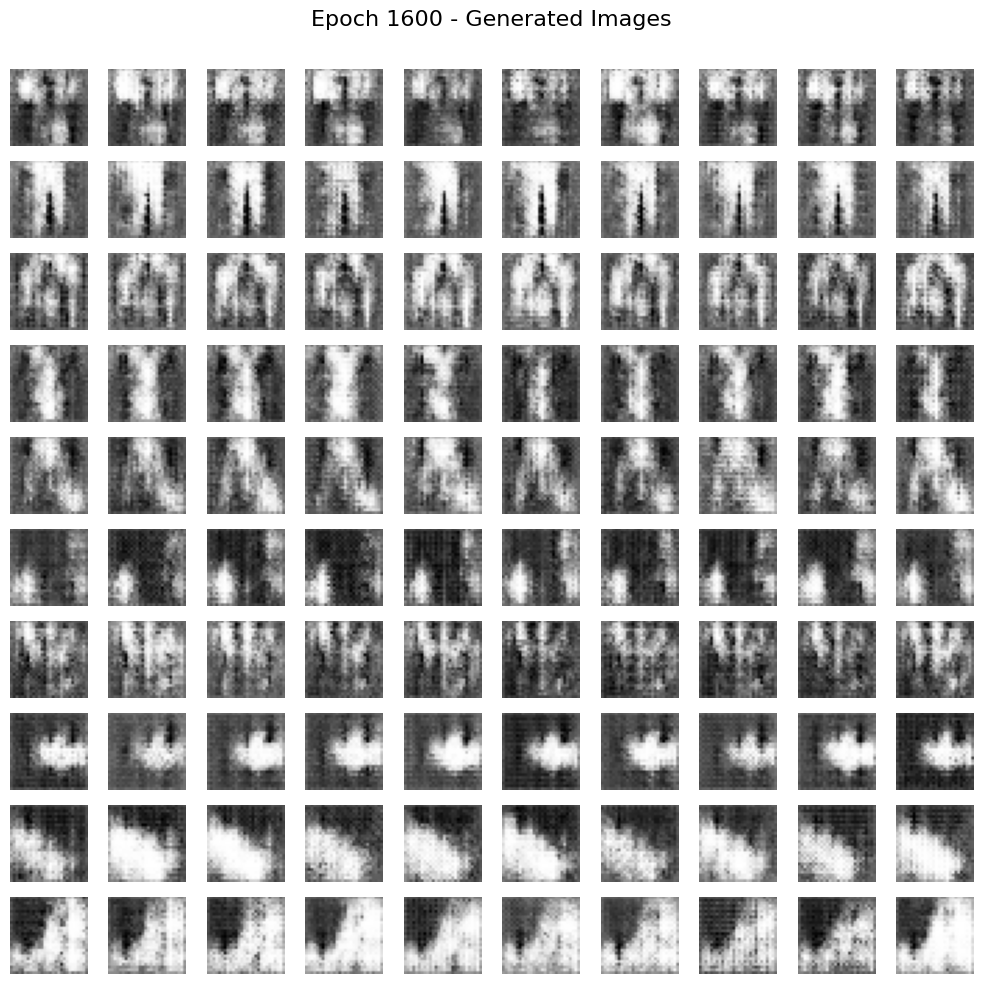

Epoch 1610/2000,  GL: 0.0018, VL: 80.5898, PKLD:3.0470, KLD:0.0001, PE: 3.0470, CE: 0.0001, IA: 1.0000,  PA: 0.5700
Epoch 1620/2000,  GL: 0.0018, VL: 82.2780, PKLD:3.1500, KLD:0.0001, PE: 3.1500, CE: 0.0001, IA: 1.0000,  PA: 0.5460
Epoch 1630/2000,  GL: 0.0018, VL: 82.7108, PKLD:2.9860, KLD:0.0001, PE: 2.9860, CE: 0.0001, IA: 1.0000,  PA: 0.5740
Epoch 1640/2000,  GL: 0.0020, VL: 80.5713, PKLD:3.2031, KLD:0.0001, PE: 3.2031, CE: 0.0001, IA: 1.0000,  PA: 0.5780
Epoch 1650/2000,  GL: 0.0017, VL: 84.0032, PKLD:2.5802, KLD:0.0001, PE: 2.5802, CE: 0.0001, IA: 1.0000,  PA: 0.5760
Epoch 1660/2000,  GL: 0.0019, VL: 81.4975, PKLD:3.2036, KLD:0.0001, PE: 3.2036, CE: 0.0001, IA: 1.0000,  PA: 0.5440
Epoch 1670/2000,  GL: 0.0017, VL: 82.2908, PKLD:2.9052, KLD:0.0001, PE: 2.9052, CE: 0.0001, IA: 1.0000,  PA: 0.6140
Epoch 1680/2000,  GL: 0.0019, VL: 81.8305, PKLD:2.8467, KLD:0.0001, PE: 2.8467, CE: 0.0001, IA: 1.0000,  PA: 0.5720
Epoch 1690/2000,  GL: 0.0018, VL: 83.8267, PKLD:2.8712, KLD:0.0001, PE: 

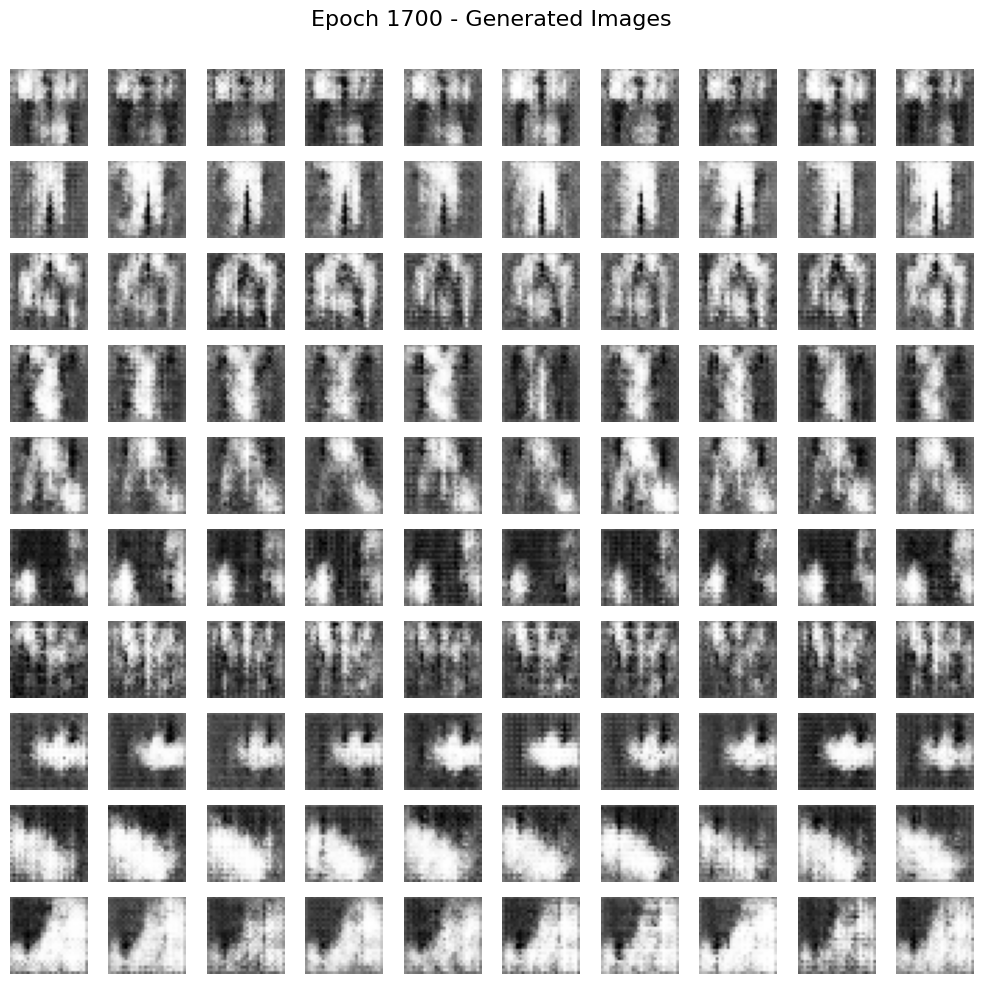

Epoch 1710/2000,  GL: 0.0017, VL: 80.8870, PKLD:2.7762, KLD:0.0001, PE: 2.7762, CE: 0.0001, IA: 1.0000,  PA: 0.6020
Epoch 1720/2000,  GL: 0.0017, VL: 80.8442, PKLD:2.9603, KLD:0.0001, PE: 2.9603, CE: 0.0001, IA: 1.0000,  PA: 0.5740
Epoch 1730/2000,  GL: 0.0018, VL: 82.4627, PKLD:2.7236, KLD:0.0001, PE: 2.7236, CE: 0.0001, IA: 1.0000,  PA: 0.6020
Epoch 1740/2000,  GL: 0.0018, VL: 82.2012, PKLD:2.8083, KLD:0.0001, PE: 2.8083, CE: 0.0001, IA: 1.0000,  PA: 0.5820
Epoch 1750/2000,  GL: 0.0019, VL: 82.3705, PKLD:2.7893, KLD:0.0001, PE: 2.7893, CE: 0.0001, IA: 1.0000,  PA: 0.5720
Epoch 1760/2000,  GL: 0.0020, VL: 81.3613, PKLD:2.7712, KLD:0.0001, PE: 2.7712, CE: 0.0001, IA: 1.0000,  PA: 0.5700
Epoch 1770/2000,  GL: 0.0018, VL: 80.8501, PKLD:2.9658, KLD:0.0001, PE: 2.9658, CE: 0.0001, IA: 1.0000,  PA: 0.5520
Epoch 1780/2000,  GL: 0.0017, VL: 82.6008, PKLD:2.7547, KLD:0.0001, PE: 2.7547, CE: 0.0001, IA: 1.0000,  PA: 0.5880
Epoch 1790/2000,  GL: 0.0020, VL: 84.4617, PKLD:3.0593, KLD:0.0001, PE: 

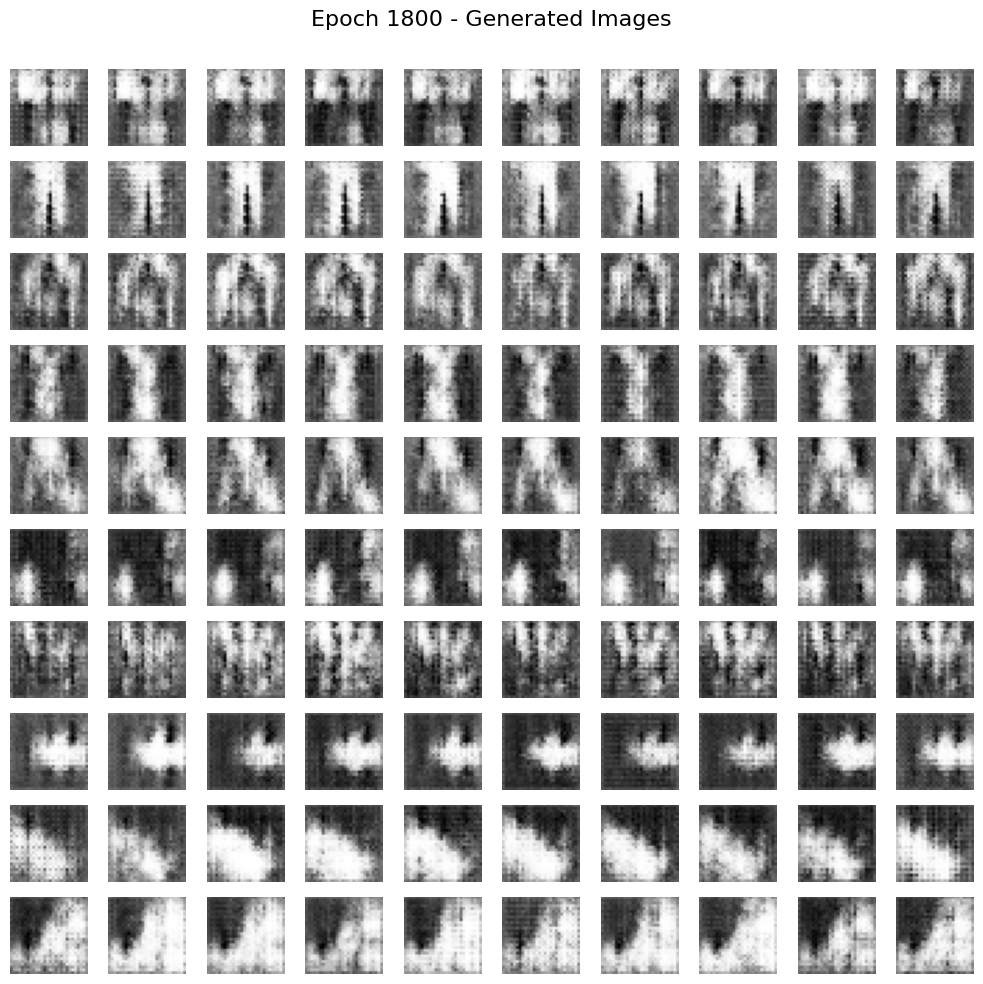

Epoch 1810/2000,  GL: 0.0015, VL: 82.2940, PKLD:2.7436, KLD:0.0001, PE: 2.7436, CE: 0.0001, IA: 1.0000,  PA: 0.5860
Epoch 1820/2000,  GL: 0.0018, VL: 79.4281, PKLD:2.9085, KLD:0.0001, PE: 2.9085, CE: 0.0001, IA: 1.0000,  PA: 0.5560
Epoch 1830/2000,  GL: 0.0018, VL: 78.9837, PKLD:2.8948, KLD:0.0001, PE: 2.8948, CE: 0.0001, IA: 1.0000,  PA: 0.5920
Epoch 1840/2000,  GL: 0.0017, VL: 79.7473, PKLD:3.1334, KLD:0.0001, PE: 3.1334, CE: 0.0001, IA: 1.0000,  PA: 0.5460
Epoch 1850/2000,  GL: 0.0017, VL: 82.8047, PKLD:2.7950, KLD:0.0001, PE: 2.7950, CE: 0.0001, IA: 1.0000,  PA: 0.5940
Epoch 1860/2000,  GL: 0.0018, VL: 79.8281, PKLD:2.9387, KLD:0.0001, PE: 2.9387, CE: 0.0001, IA: 1.0000,  PA: 0.5500
Epoch 1870/2000,  GL: 0.0019, VL: 81.8169, PKLD:2.9846, KLD:0.0001, PE: 2.9846, CE: 0.0001, IA: 1.0000,  PA: 0.5780
Epoch 1880/2000,  GL: 0.0020, VL: 79.8848, PKLD:3.1639, KLD:0.0001, PE: 3.1639, CE: 0.0001, IA: 1.0000,  PA: 0.5580
Epoch 1890/2000,  GL: 0.0016, VL: 81.6749, PKLD:3.2107, KLD:0.0001, PE: 

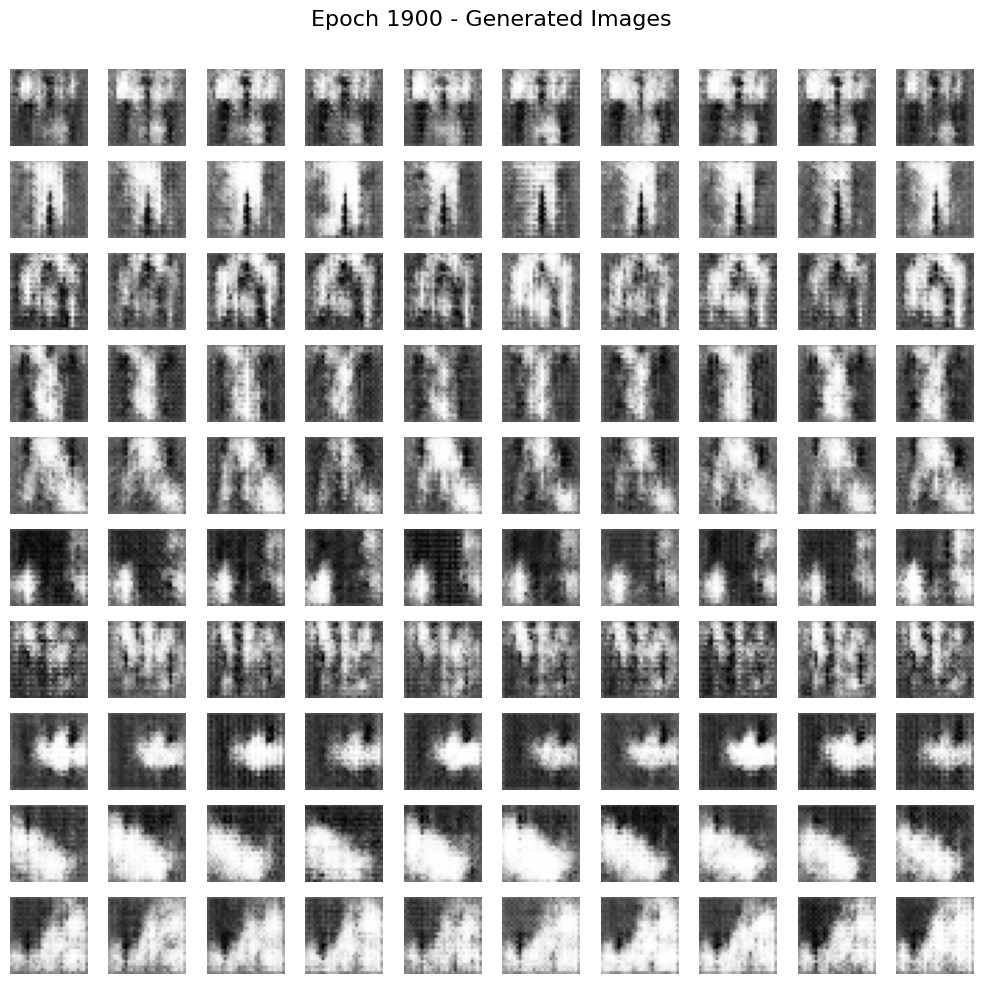

Epoch 1910/2000,  GL: 0.0017, VL: 81.1707, PKLD:2.7499, KLD:0.0001, PE: 2.7499, CE: 0.0001, IA: 1.0000,  PA: 0.5940
Epoch 1920/2000,  GL: 0.0016, VL: 79.9402, PKLD:3.2945, KLD:0.0001, PE: 3.2945, CE: 0.0001, IA: 1.0000,  PA: 0.5600
Epoch 1930/2000,  GL: 0.0016, VL: 79.1416, PKLD:2.9430, KLD:0.0001, PE: 2.9430, CE: 0.0001, IA: 1.0000,  PA: 0.5800
Epoch 1940/2000,  GL: 0.0016, VL: 79.0037, PKLD:3.0768, KLD:0.0001, PE: 3.0768, CE: 0.0001, IA: 1.0000,  PA: 0.5380
Epoch 1950/2000,  GL: 0.0017, VL: 79.6101, PKLD:2.8663, KLD:0.0001, PE: 2.8663, CE: 0.0001, IA: 1.0000,  PA: 0.5680
Epoch 1960/2000,  GL: 0.0018, VL: 79.3867, PKLD:3.3010, KLD:0.0001, PE: 3.3010, CE: 0.0001, IA: 1.0000,  PA: 0.5520
Epoch 1970/2000,  GL: 0.0017, VL: 79.6412, PKLD:3.3549, KLD:0.0001, PE: 3.3549, CE: 0.0001, IA: 1.0000,  PA: 0.5380
Epoch 1980/2000,  GL: 0.0017, VL: 80.2191, PKLD:2.9017, KLD:0.0001, PE: 2.9017, CE: 0.0001, IA: 1.0000,  PA: 0.5640
Epoch 1990/2000,  GL: 0.0016, VL: 80.8310, PKLD:2.7065, KLD:0.0001, PE: 

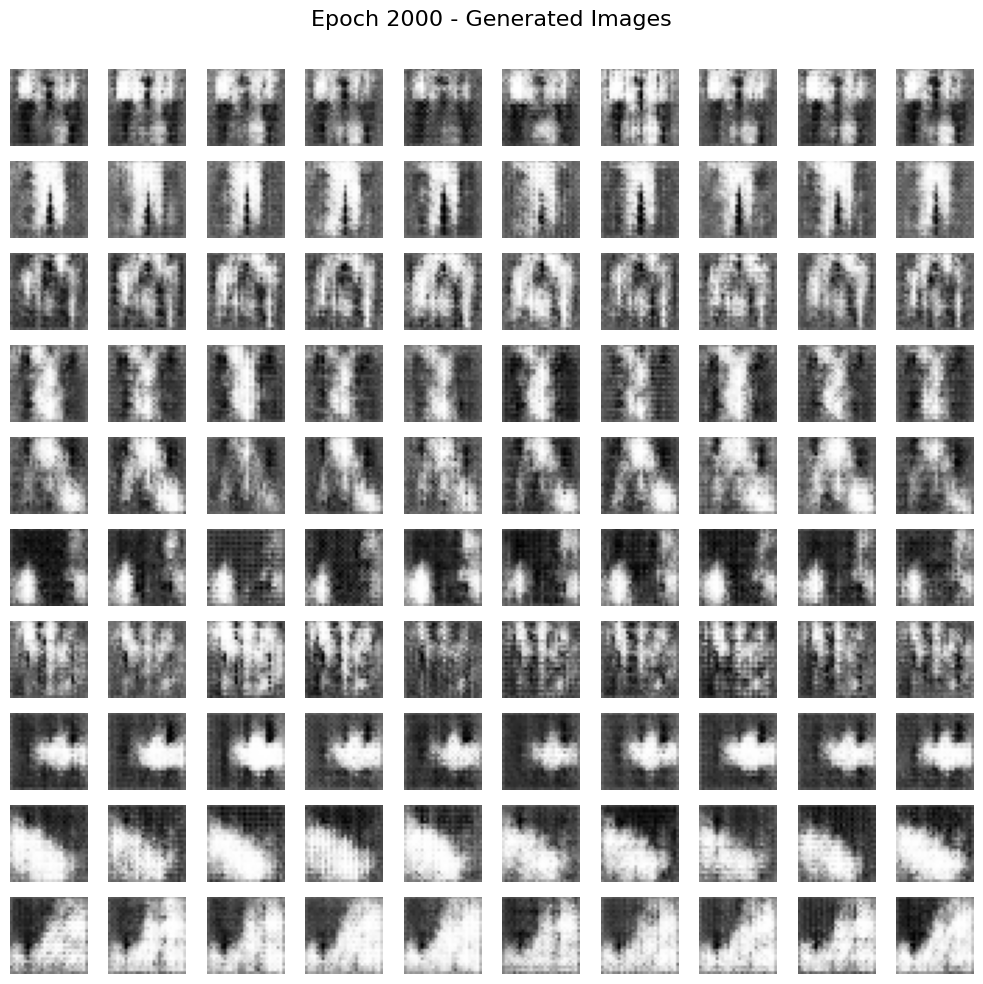

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_1000_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.001, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =2000

perturbation_bound = 2

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              + .1*var_loss
              # +750*perturbation_entropy
            #  +750*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

### 10 image per class

Epoch 10/2000,  GL: 3.9639, VL: 254.1533, PKLD:7.6745, KLD:2.3100, PE: 7.6745, CE: 2.3100, IA: 0.1560,  PA: 0.1160
Epoch 20/2000,  GL: 2.2068, VL: 217.8596, PKLD:7.5794, KLD:2.0741, PE: 7.5794, CE: 2.0741, IA: 0.3160,  PA: 0.1000
Epoch 30/2000,  GL: 2.0676, VL: 153.1344, PKLD:6.6735, KLD:1.5920, PE: 6.6735, CE: 1.5920, IA: 0.7380,  PA: 0.1560
Epoch 40/2000,  GL: 1.8217, VL: 106.1394, PKLD:5.6348, KLD:0.5780, PE: 5.6348, CE: 0.5780, IA: 0.9820,  PA: 0.2340
Epoch 50/2000,  GL: 0.9078, VL: 94.1065, PKLD:2.8003, KLD:0.1108, PE: 2.8003, CE: 0.1108, IA: 1.0000,  PA: 0.4860
Epoch 60/2000,  GL: 0.2838, VL: 98.2185, PKLD:1.6259, KLD:0.0246, PE: 1.6259, CE: 0.0246, IA: 1.0000,  PA: 0.6180
Epoch 70/2000,  GL: 0.1131, VL: 106.0320, PKLD:0.7987, KLD:0.0073, PE: 0.7987, CE: 0.0073, IA: 1.0000,  PA: 0.7540
Epoch 80/2000,  GL: 0.0738, VL: 111.4745, PKLD:0.5339, KLD:0.0044, PE: 0.5339, CE: 0.0044, IA: 1.0000,  PA: 0.8400
Epoch 90/2000,  GL: 0.0410, VL: 119.0012, PKLD:0.3822, KLD:0.0024, PE: 0.3822, CE:

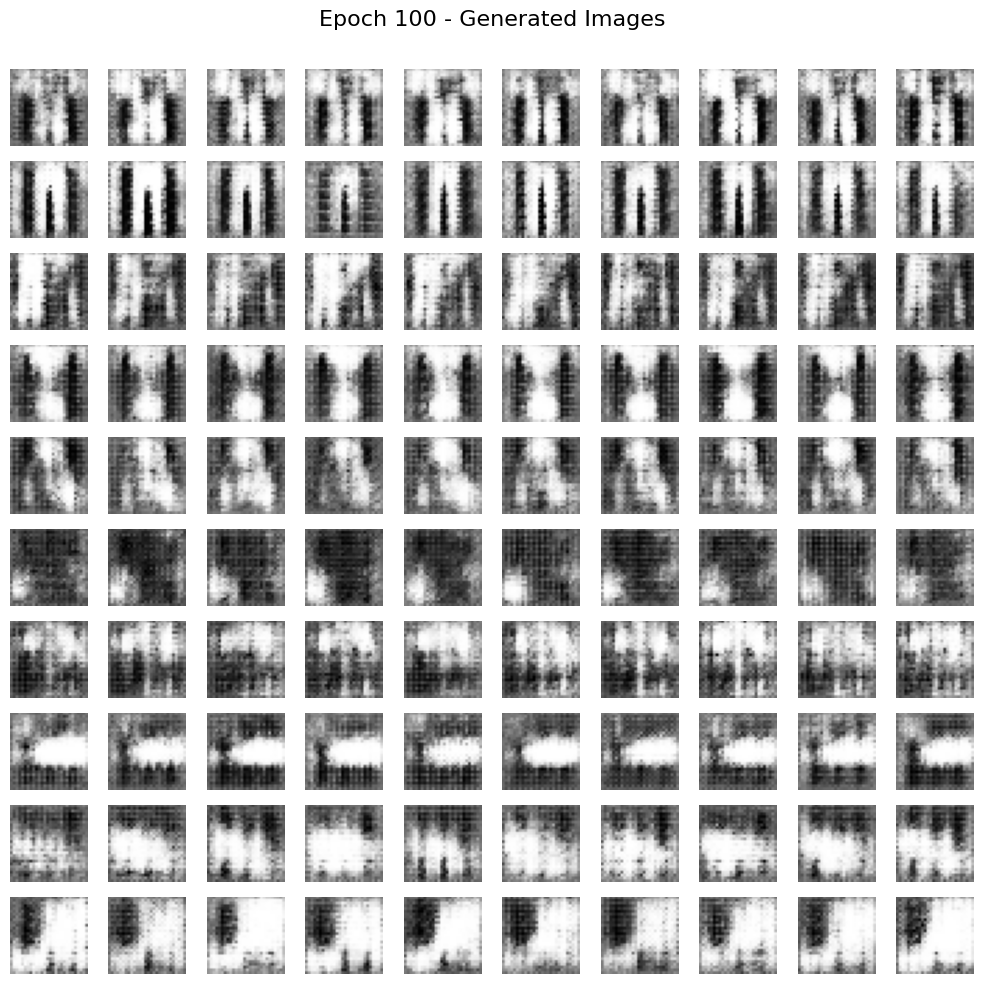

Epoch 110/2000,  GL: 0.0214, VL: 122.7751, PKLD:0.1983, KLD:0.0011, PE: 0.1983, CE: 0.0011, IA: 1.0000,  PA: 0.9300
Epoch 120/2000,  GL: 0.0169, VL: 126.4371, PKLD:0.1409, KLD:0.0009, PE: 0.1409, CE: 0.0009, IA: 1.0000,  PA: 0.9480
Epoch 130/2000,  GL: 0.0128, VL: 130.2086, PKLD:0.1758, KLD:0.0006, PE: 0.1758, CE: 0.0006, IA: 1.0000,  PA: 0.9380
Epoch 140/2000,  GL: 0.0130, VL: 129.6835, PKLD:0.0997, KLD:0.0006, PE: 0.0997, CE: 0.0006, IA: 1.0000,  PA: 0.9620
Epoch 150/2000,  GL: 0.0142, VL: 134.8239, PKLD:0.1050, KLD:0.0006, PE: 0.1050, CE: 0.0006, IA: 1.0000,  PA: 0.9540
Epoch 160/2000,  GL: 0.0080, VL: 135.2856, PKLD:0.1098, KLD:0.0004, PE: 0.1098, CE: 0.0004, IA: 1.0000,  PA: 0.9600
Epoch 170/2000,  GL: 0.0080, VL: 137.3844, PKLD:0.1153, KLD:0.0004, PE: 0.1153, CE: 0.0004, IA: 1.0000,  PA: 0.9520
Epoch 180/2000,  GL: 0.0075, VL: 140.0219, PKLD:0.1076, KLD:0.0003, PE: 0.1076, CE: 0.0003, IA: 1.0000,  PA: 0.9580
Epoch 190/2000,  GL: 0.0080, VL: 142.2792, PKLD:0.0595, KLD:0.0004, PE: 

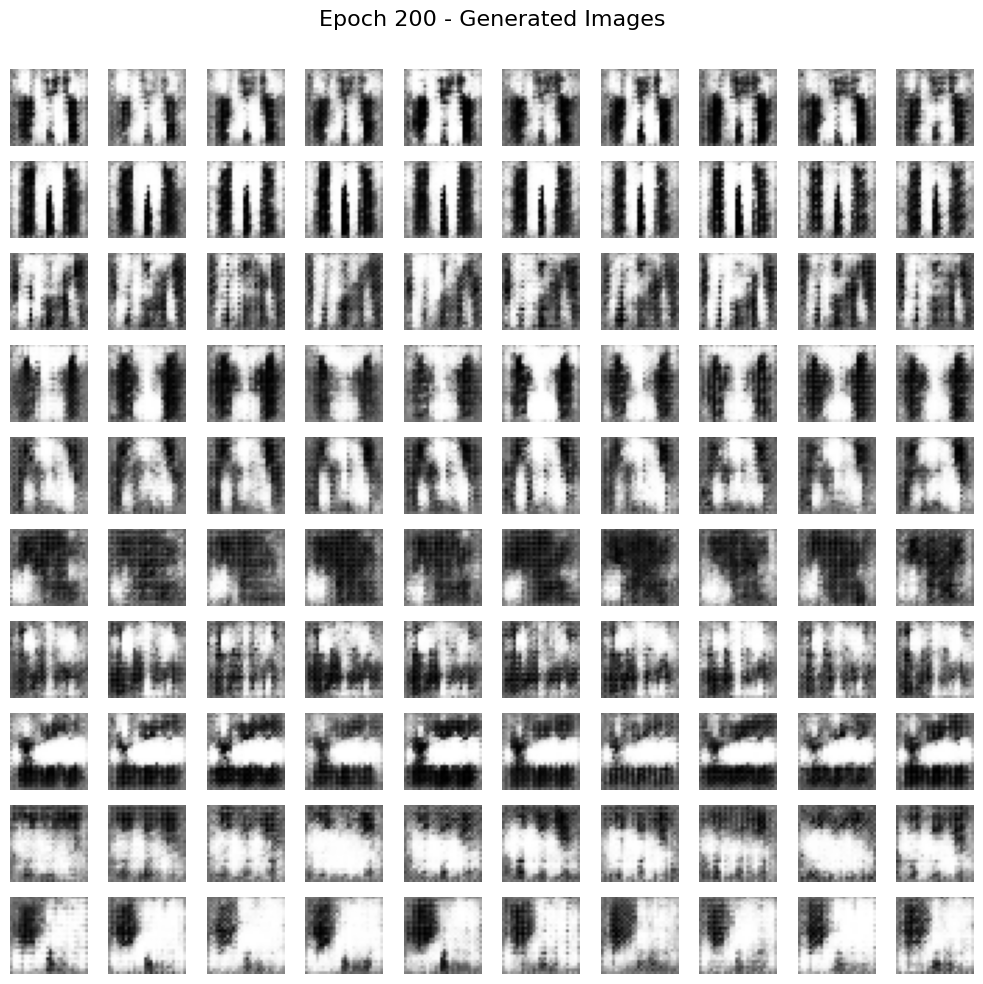

Epoch 210/2000,  GL: 0.0052, VL: 145.1820, PKLD:0.0514, KLD:0.0002, PE: 0.0514, CE: 0.0002, IA: 1.0000,  PA: 0.9800
Epoch 220/2000,  GL: 0.0049, VL: 146.4768, PKLD:0.0435, KLD:0.0002, PE: 0.0435, CE: 0.0002, IA: 1.0000,  PA: 0.9840
Epoch 230/2000,  GL: 0.0048, VL: 149.5758, PKLD:0.0502, KLD:0.0002, PE: 0.0502, CE: 0.0002, IA: 1.0000,  PA: 0.9880
Epoch 240/2000,  GL: 0.0047, VL: 150.1723, PKLD:0.0584, KLD:0.0002, PE: 0.0584, CE: 0.0002, IA: 1.0000,  PA: 0.9780
Epoch 250/2000,  GL: 0.0042, VL: 150.6773, PKLD:0.0518, KLD:0.0002, PE: 0.0518, CE: 0.0002, IA: 1.0000,  PA: 0.9860
Epoch 260/2000,  GL: 0.0042, VL: 152.2292, PKLD:0.0486, KLD:0.0002, PE: 0.0486, CE: 0.0002, IA: 1.0000,  PA: 0.9820
Epoch 270/2000,  GL: 0.0043, VL: 152.3309, PKLD:0.0201, KLD:0.0002, PE: 0.0201, CE: 0.0002, IA: 1.0000,  PA: 0.9960
Epoch 280/2000,  GL: 0.0038, VL: 153.6158, PKLD:0.0362, KLD:0.0001, PE: 0.0362, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 290/2000,  GL: 0.0033, VL: 153.3721, PKLD:0.0290, KLD:0.0001, PE: 

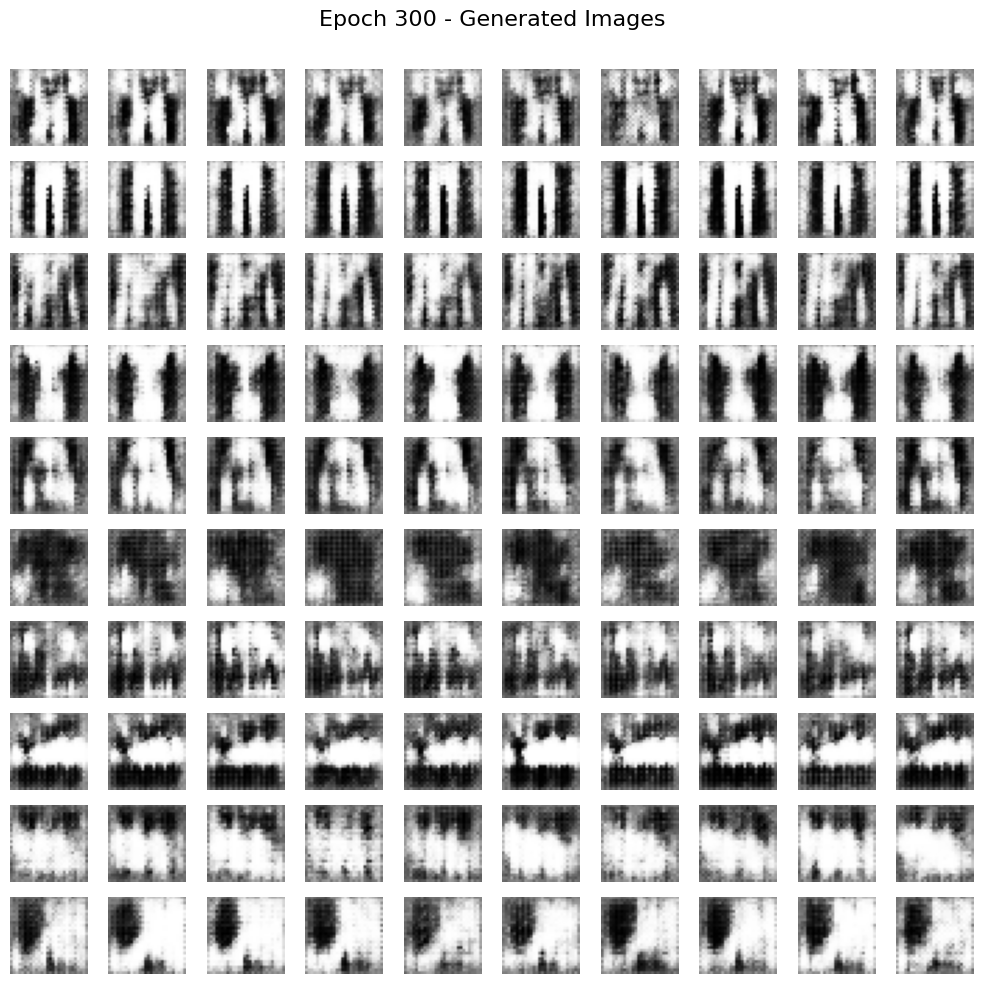

Epoch 310/2000,  GL: 0.0033, VL: 157.0073, PKLD:0.0342, KLD:0.0001, PE: 0.0342, CE: 0.0001, IA: 1.0000,  PA: 0.9900
Epoch 320/2000,  GL: 0.0032, VL: 156.0738, PKLD:0.0338, KLD:0.0001, PE: 0.0338, CE: 0.0001, IA: 1.0000,  PA: 0.9860
Epoch 330/2000,  GL: 0.0028, VL: 158.4279, PKLD:0.0178, KLD:0.0001, PE: 0.0178, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 340/2000,  GL: 0.0030, VL: 160.9716, PKLD:0.0198, KLD:0.0001, PE: 0.0198, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 350/2000,  GL: 0.0032, VL: 158.3734, PKLD:0.0286, KLD:0.0001, PE: 0.0286, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 360/2000,  GL: 0.0032, VL: 163.6103, PKLD:0.0257, KLD:0.0001, PE: 0.0257, CE: 0.0001, IA: 1.0000,  PA: 0.9920
Epoch 370/2000,  GL: 0.0023, VL: 161.3385, PKLD:0.0170, KLD:0.0001, PE: 0.0170, CE: 0.0001, IA: 1.0000,  PA: 0.9980
Epoch 380/2000,  GL: 0.0027, VL: 161.6400, PKLD:0.0194, KLD:0.0001, PE: 0.0194, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 390/2000,  GL: 0.0028, VL: 160.8903, PKLD:0.0178, KLD:0.0001, PE: 

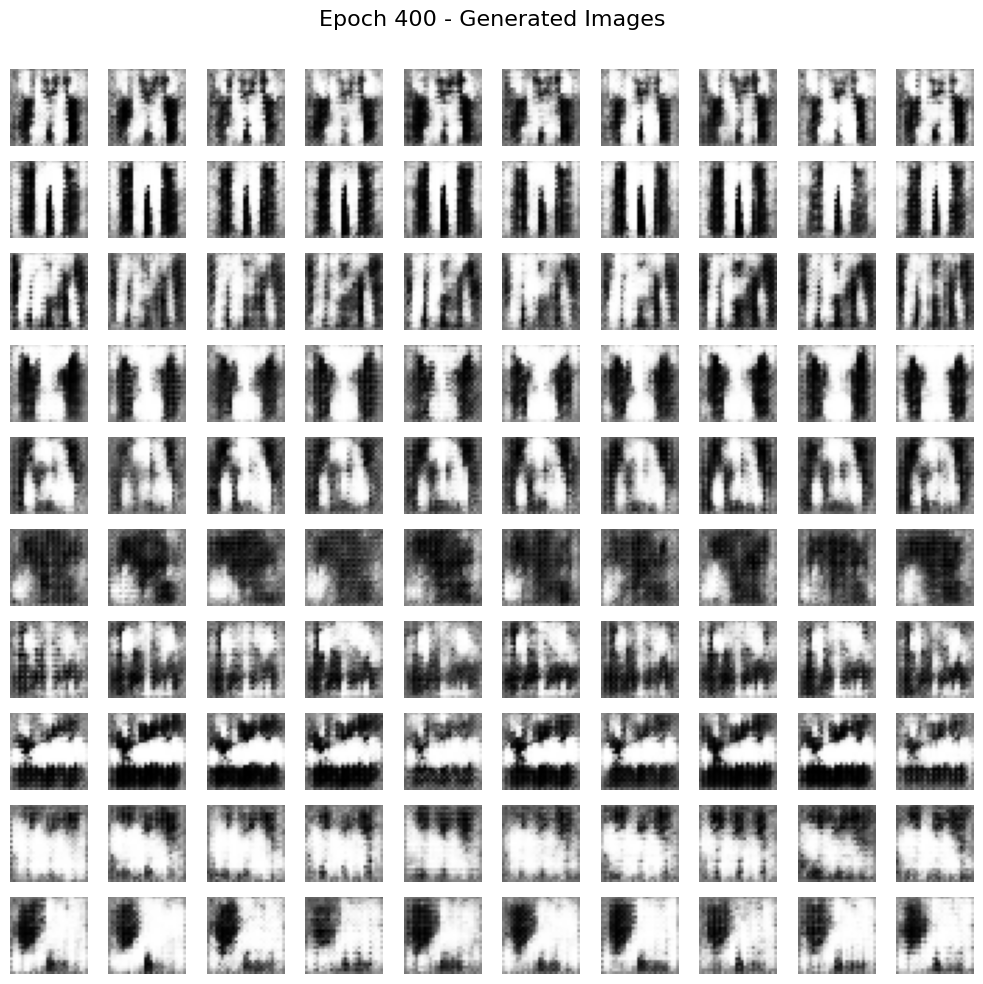

Epoch 410/2000,  GL: 0.0019, VL: 162.5442, PKLD:0.0264, KLD:0.0001, PE: 0.0264, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 420/2000,  GL: 0.0028, VL: 165.1962, PKLD:0.0304, KLD:0.0001, PE: 0.0304, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 430/2000,  GL: 0.0020, VL: 166.6061, PKLD:0.0069, KLD:0.0001, PE: 0.0069, CE: 0.0001, IA: 1.0000,  PA: 1.0000
Epoch 440/2000,  GL: 0.0023, VL: 165.7469, PKLD:0.0403, KLD:0.0001, PE: 0.0403, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 450/2000,  GL: 0.0020, VL: 163.9657, PKLD:0.0216, KLD:0.0001, PE: 0.0216, CE: 0.0001, IA: 1.0000,  PA: 0.9920
Epoch 460/2000,  GL: 0.0015, VL: 162.8922, PKLD:0.0143, KLD:0.0001, PE: 0.0143, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 470/2000,  GL: 0.0021, VL: 167.1216, PKLD:0.0279, KLD:0.0001, PE: 0.0279, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 480/2000,  GL: 0.0020, VL: 169.3576, PKLD:0.0131, KLD:0.0001, PE: 0.0131, CE: 0.0001, IA: 1.0000,  PA: 0.9960
Epoch 490/2000,  GL: 0.0017, VL: 170.6572, PKLD:0.0223, KLD:0.0001, PE: 

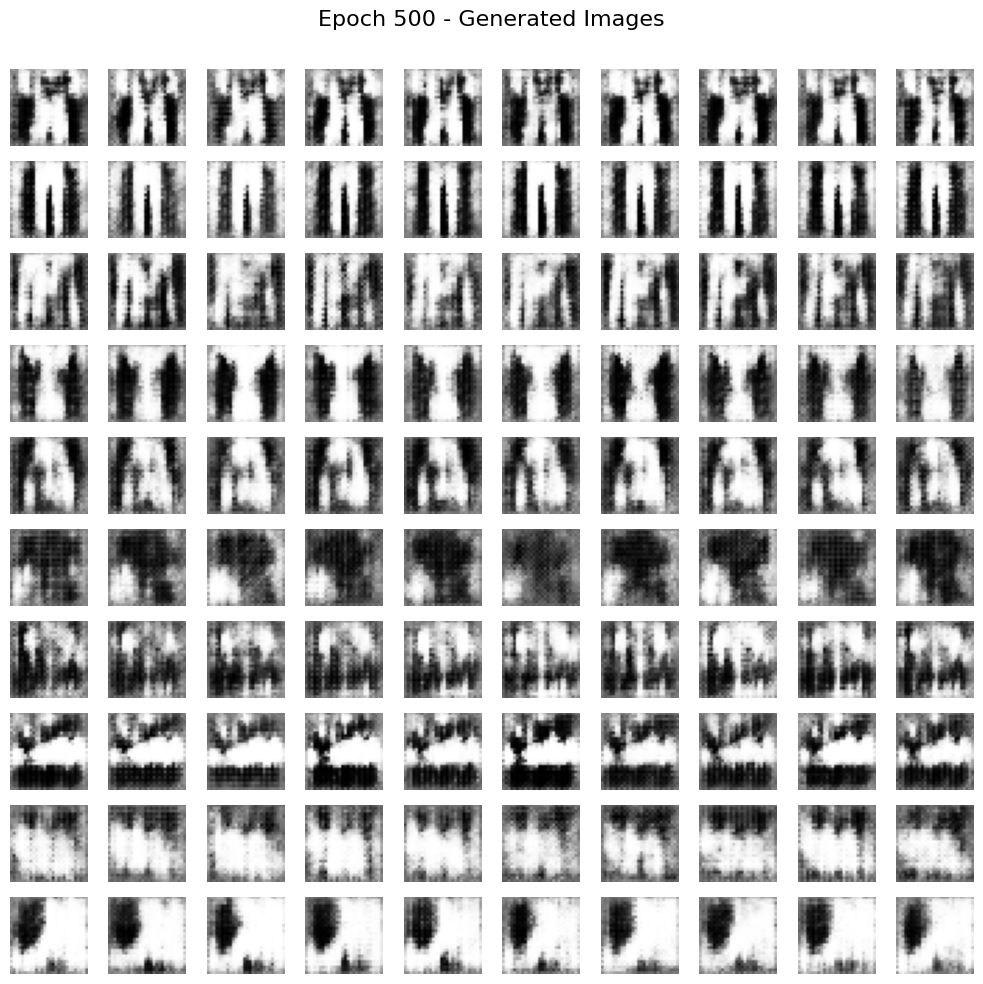

Epoch 510/2000,  GL: 0.0016, VL: 171.7075, PKLD:0.0155, KLD:0.0001, PE: 0.0155, CE: 0.0001, IA: 1.0000,  PA: 0.9920
Epoch 520/2000,  GL: 0.0017, VL: 172.5529, PKLD:0.0175, KLD:0.0001, PE: 0.0175, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 530/2000,  GL: 0.0017, VL: 168.3252, PKLD:0.0143, KLD:0.0001, PE: 0.0143, CE: 0.0001, IA: 1.0000,  PA: 0.9940
Epoch 540/2000,  GL: 0.0016, VL: 171.4687, PKLD:0.0120, KLD:0.0001, PE: 0.0120, CE: 0.0001, IA: 1.0000,  PA: 0.9980
Epoch 550/2000,  GL: 0.0015, VL: 173.1598, PKLD:0.0214, KLD:0.0001, PE: 0.0214, CE: 0.0001, IA: 1.0000,  PA: 0.9920
Epoch 560/2000,  GL: 0.0015, VL: 172.2548, PKLD:0.0279, KLD:0.0001, PE: 0.0279, CE: 0.0001, IA: 1.0000,  PA: 0.9880
Epoch 570/2000,  GL: 0.0015, VL: 173.1207, PKLD:0.0117, KLD:0.0001, PE: 0.0117, CE: 0.0001, IA: 1.0000,  PA: 0.9980
Epoch 580/2000,  GL: 0.0013, VL: 173.2507, PKLD:0.0185, KLD:0.0000, PE: 0.0185, CE: 0.0000, IA: 1.0000,  PA: 0.9920
Epoch 590/2000,  GL: 0.0014, VL: 175.3834, PKLD:0.0143, KLD:0.0000, PE: 

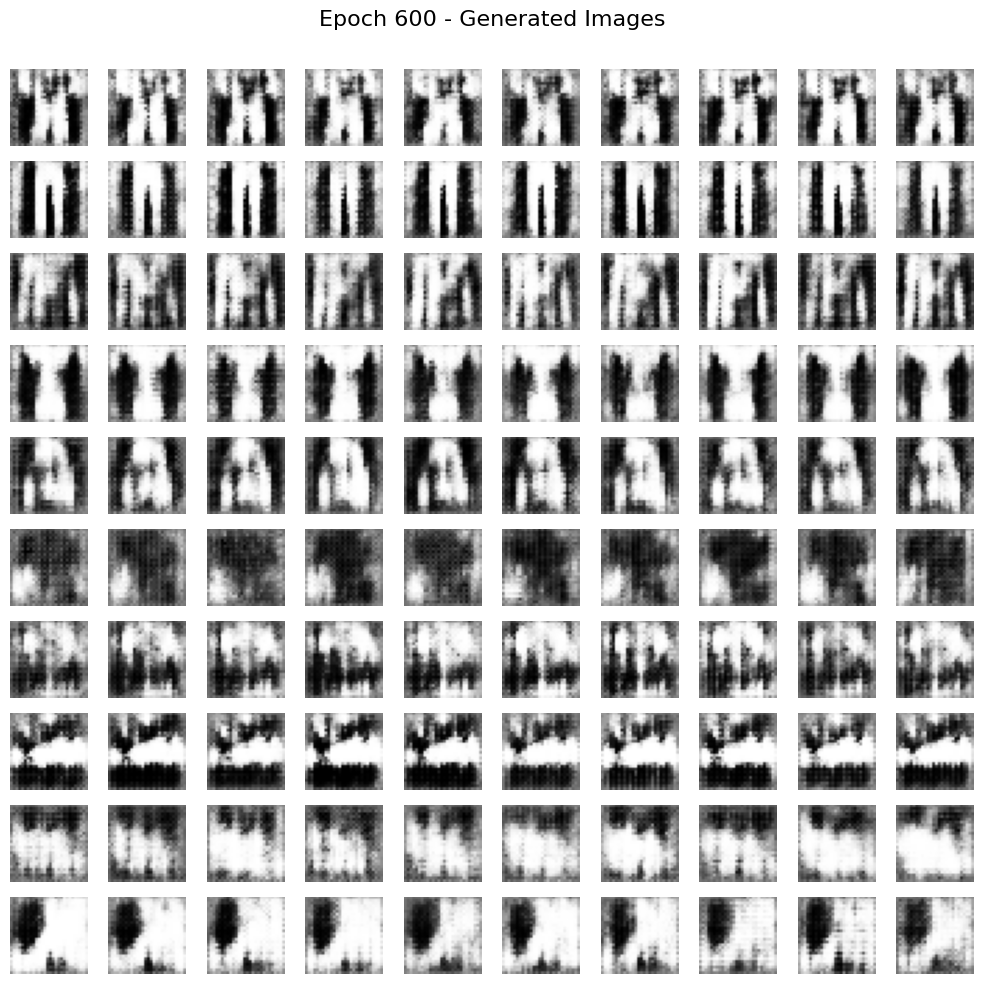

Epoch 610/2000,  GL: 0.0019, VL: 167.5875, PKLD:0.0205, KLD:0.0001, PE: 0.0205, CE: 0.0001, IA: 1.0000,  PA: 0.9960
Epoch 620/2000,  GL: 0.0014, VL: 180.3545, PKLD:0.0185, KLD:0.0000, PE: 0.0185, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 630/2000,  GL: 0.0013, VL: 172.5807, PKLD:0.0102, KLD:0.0000, PE: 0.0102, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 640/2000,  GL: 0.0015, VL: 174.2887, PKLD:0.0129, KLD:0.0001, PE: 0.0129, CE: 0.0001, IA: 1.0000,  PA: 0.9960
Epoch 650/2000,  GL: 0.0018, VL: 175.6992, PKLD:0.0056, KLD:0.0001, PE: 0.0056, CE: 0.0001, IA: 1.0000,  PA: 1.0000
Epoch 660/2000,  GL: 0.0015, VL: 179.1474, PKLD:0.0136, KLD:0.0001, PE: 0.0136, CE: 0.0001, IA: 1.0000,  PA: 0.9900
Epoch 670/2000,  GL: 0.0011, VL: 180.2571, PKLD:0.0198, KLD:0.0000, PE: 0.0198, CE: 0.0000, IA: 1.0000,  PA: 0.9920
Epoch 680/2000,  GL: 0.0010, VL: 174.1896, PKLD:0.0098, KLD:0.0000, PE: 0.0098, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 690/2000,  GL: 0.0014, VL: 175.8600, PKLD:0.0095, KLD:0.0000, PE: 

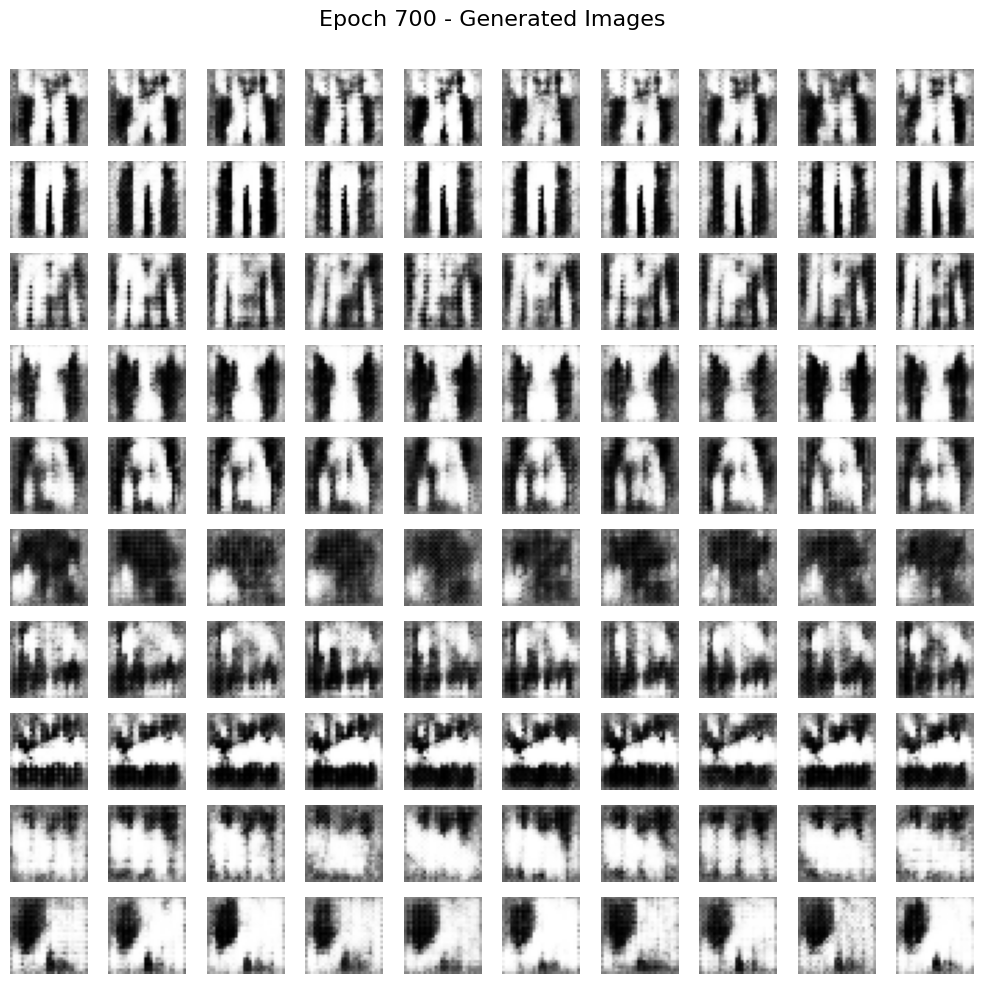

Epoch 710/2000,  GL: 0.0012, VL: 178.0300, PKLD:0.0151, KLD:0.0000, PE: 0.0151, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 720/2000,  GL: 0.0010, VL: 178.4162, PKLD:0.0047, KLD:0.0000, PE: 0.0047, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 730/2000,  GL: 0.0010, VL: 177.2532, PKLD:0.0107, KLD:0.0000, PE: 0.0107, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 740/2000,  GL: 0.0011, VL: 177.3568, PKLD:0.0124, KLD:0.0000, PE: 0.0124, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 750/2000,  GL: 0.0013, VL: 182.0516, PKLD:0.0086, KLD:0.0000, PE: 0.0086, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 760/2000,  GL: 0.0014, VL: 176.1131, PKLD:0.0246, KLD:0.0000, PE: 0.0246, CE: 0.0000, IA: 1.0000,  PA: 0.9880
Epoch 770/2000,  GL: 0.0011, VL: 179.0919, PKLD:0.0049, KLD:0.0000, PE: 0.0049, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 780/2000,  GL: 0.0008, VL: 180.7597, PKLD:0.0126, KLD:0.0000, PE: 0.0126, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 790/2000,  GL: 0.0012, VL: 178.0074, PKLD:0.0089, KLD:0.0000, PE: 

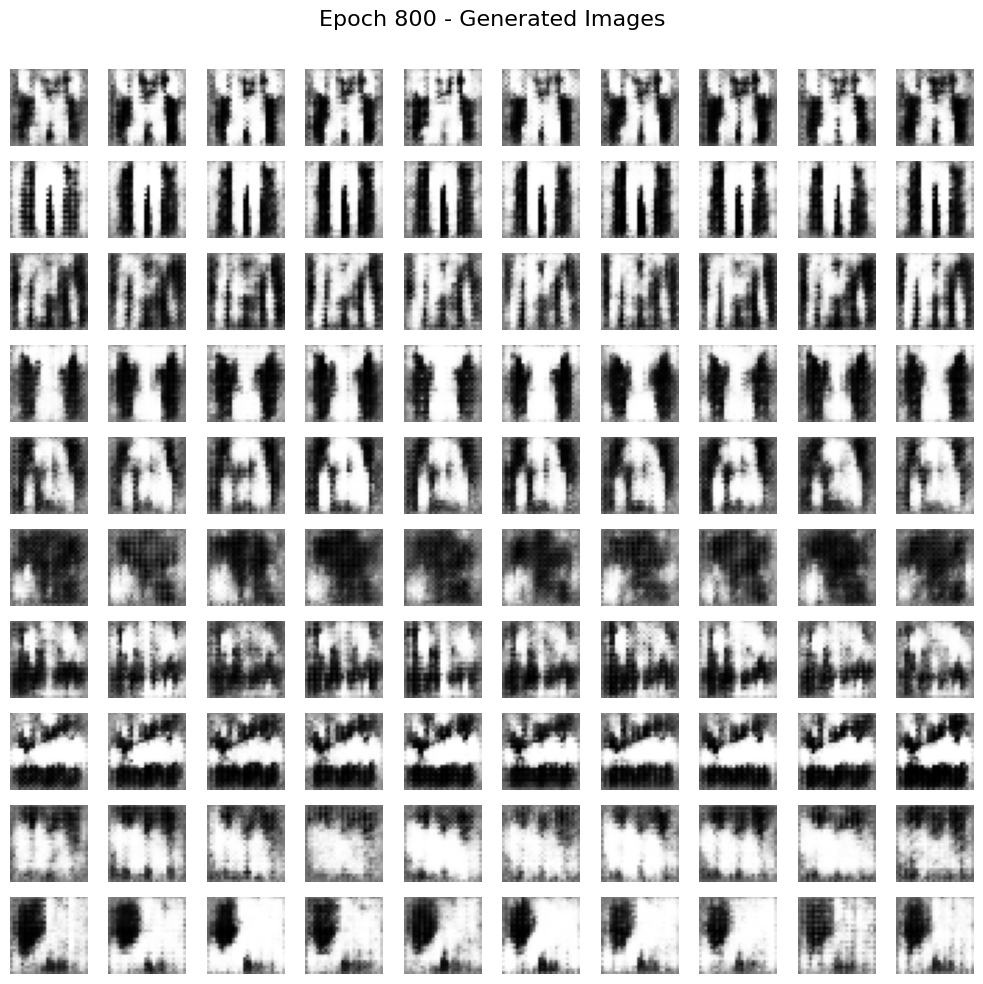

Epoch 810/2000,  GL: 0.0010, VL: 181.0479, PKLD:0.0106, KLD:0.0000, PE: 0.0106, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 820/2000,  GL: 0.0009, VL: 178.5961, PKLD:0.0091, KLD:0.0000, PE: 0.0091, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 830/2000,  GL: 0.0013, VL: 179.5327, PKLD:0.0108, KLD:0.0000, PE: 0.0108, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 840/2000,  GL: 0.0010, VL: 181.2905, PKLD:0.0106, KLD:0.0000, PE: 0.0106, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 850/2000,  GL: 0.0026, VL: 179.2884, PKLD:0.0169, KLD:0.0001, PE: 0.0169, CE: 0.0001, IA: 1.0000,  PA: 0.9960
Epoch 860/2000,  GL: 0.0009, VL: 183.4205, PKLD:0.0081, KLD:0.0000, PE: 0.0081, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 870/2000,  GL: 0.0011, VL: 182.8083, PKLD:0.0115, KLD:0.0000, PE: 0.0115, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 880/2000,  GL: 0.0011, VL: 182.6179, PKLD:0.0089, KLD:0.0000, PE: 0.0089, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 890/2000,  GL: 0.0011, VL: 179.7067, PKLD:0.0049, KLD:0.0000, PE: 

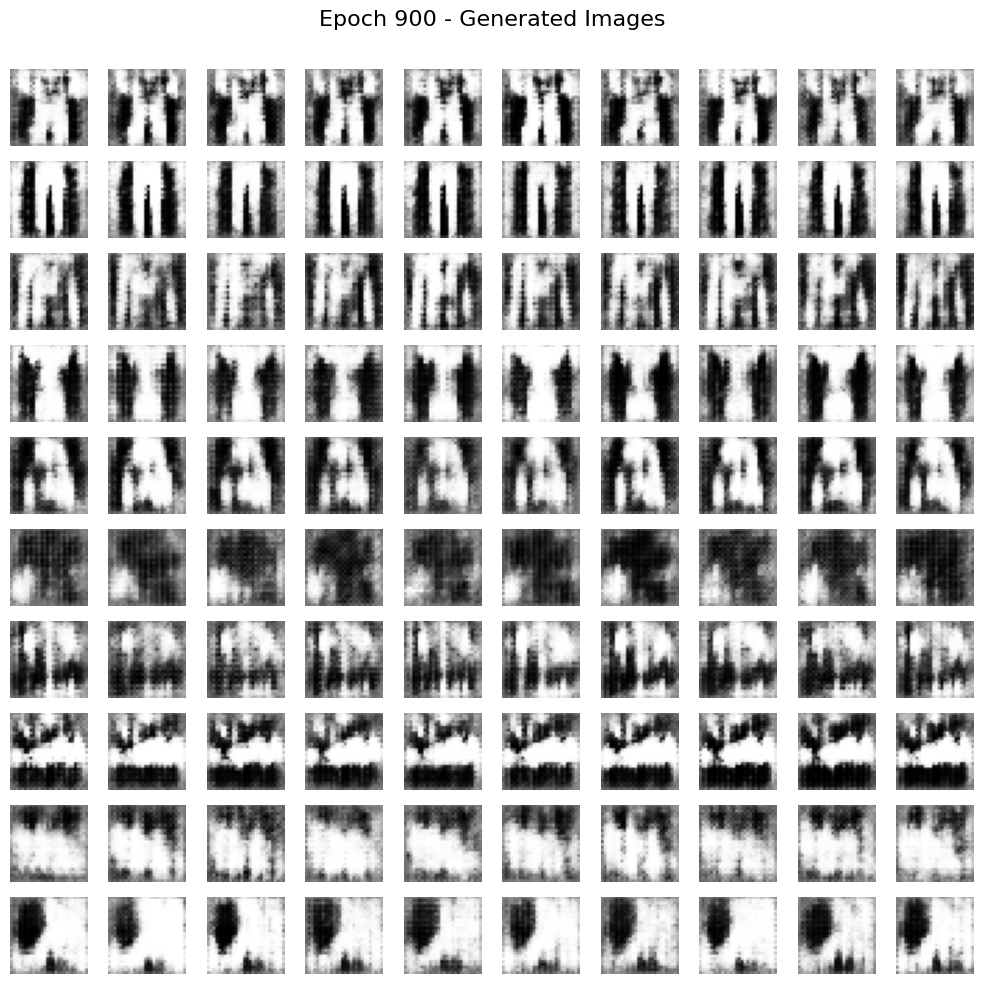

Epoch 910/2000,  GL: 0.0009, VL: 181.2684, PKLD:0.0127, KLD:0.0000, PE: 0.0127, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 920/2000,  GL: 0.0017, VL: 181.9779, PKLD:0.0145, KLD:0.0000, PE: 0.0145, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 930/2000,  GL: 0.0011, VL: 181.1050, PKLD:0.0044, KLD:0.0000, PE: 0.0044, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 940/2000,  GL: 0.0010, VL: 187.6902, PKLD:0.0075, KLD:0.0000, PE: 0.0075, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 950/2000,  GL: 0.0012, VL: 180.7155, PKLD:0.0100, KLD:0.0000, PE: 0.0100, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 960/2000,  GL: 0.0008, VL: 183.0228, PKLD:0.0097, KLD:0.0000, PE: 0.0097, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 970/2000,  GL: 0.0009, VL: 188.5814, PKLD:0.0032, KLD:0.0000, PE: 0.0032, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 980/2000,  GL: 0.0009, VL: 182.7658, PKLD:0.0153, KLD:0.0000, PE: 0.0153, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 990/2000,  GL: 0.0011, VL: 187.9959, PKLD:0.0067, KLD:0.0000, PE: 

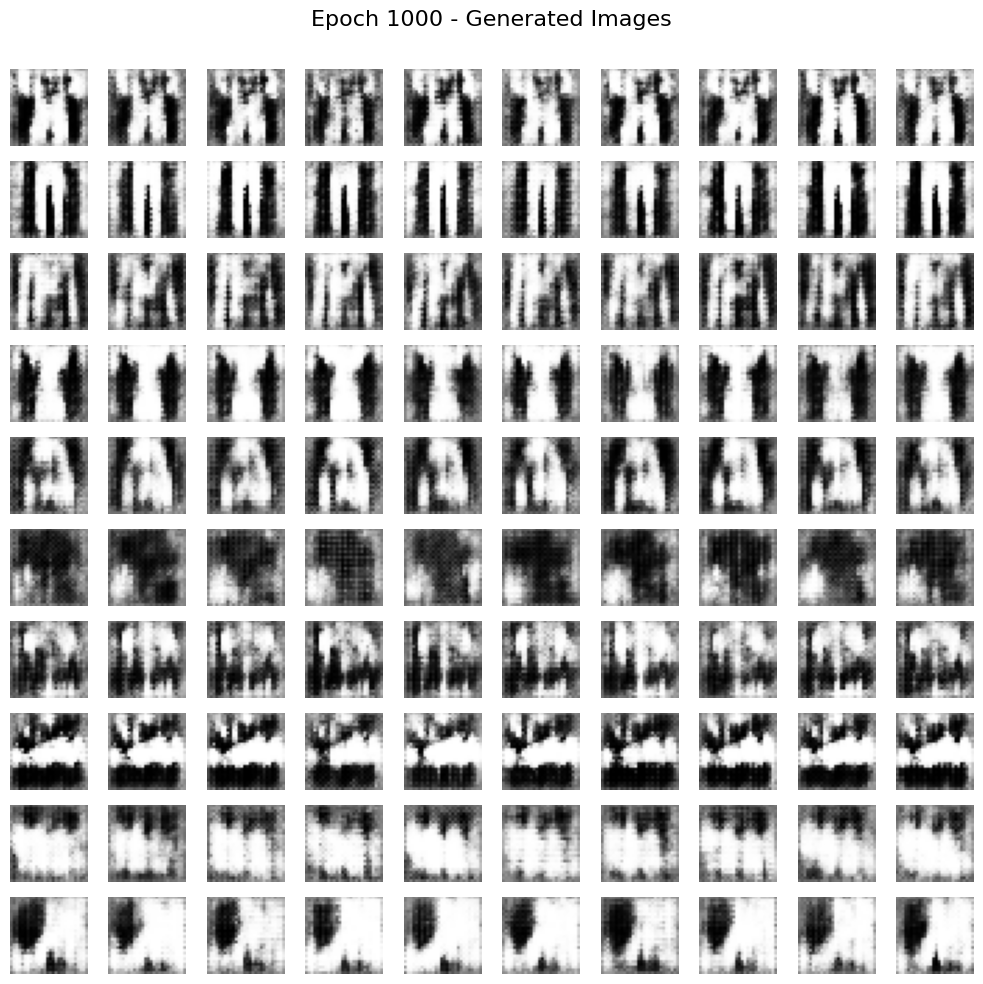

Epoch 1010/2000,  GL: 0.0009, VL: 183.9209, PKLD:0.0036, KLD:0.0000, PE: 0.0036, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1020/2000,  GL: 0.0010, VL: 180.5897, PKLD:0.0052, KLD:0.0000, PE: 0.0052, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1030/2000,  GL: 0.0011, VL: 185.8336, PKLD:0.0089, KLD:0.0000, PE: 0.0089, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1040/2000,  GL: 0.0010, VL: 187.8278, PKLD:0.0049, KLD:0.0000, PE: 0.0049, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1050/2000,  GL: 0.0008, VL: 189.0232, PKLD:0.0039, KLD:0.0000, PE: 0.0039, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1060/2000,  GL: 0.0010, VL: 184.7303, PKLD:0.0053, KLD:0.0000, PE: 0.0053, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1070/2000,  GL: 0.0008, VL: 184.1342, PKLD:0.0124, KLD:0.0000, PE: 0.0124, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1080/2000,  GL: 0.0009, VL: 184.4708, PKLD:0.0116, KLD:0.0000, PE: 0.0116, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1090/2000,  GL: 0.0009, VL: 185.1943, PKLD:0.0061, KLD:0.0

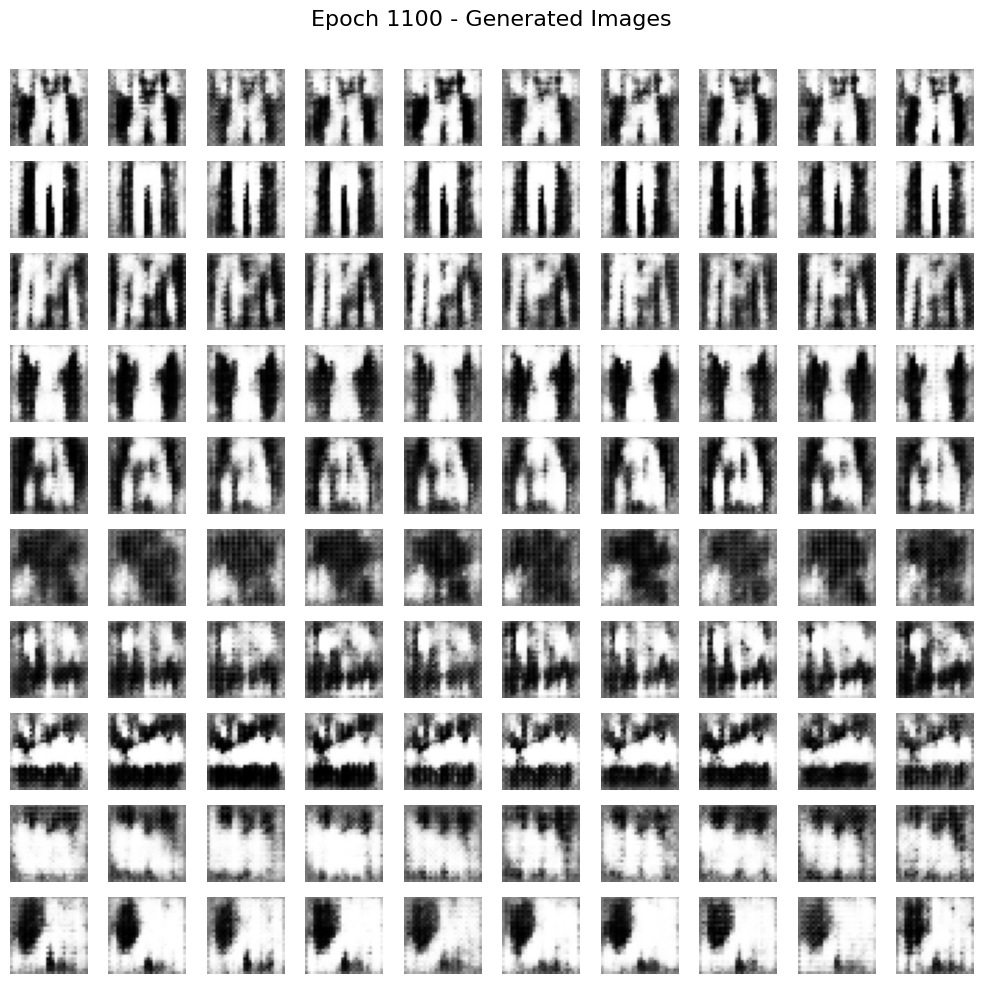

Epoch 1110/2000,  GL: 0.0008, VL: 184.6446, PKLD:0.0036, KLD:0.0000, PE: 0.0036, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1120/2000,  GL: 0.0007, VL: 186.9863, PKLD:0.0087, KLD:0.0000, PE: 0.0087, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1130/2000,  GL: 0.0009, VL: 186.2946, PKLD:0.0049, KLD:0.0000, PE: 0.0049, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1140/2000,  GL: 0.0010, VL: 186.0000, PKLD:0.0043, KLD:0.0000, PE: 0.0043, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1150/2000,  GL: 0.0009, VL: 182.6871, PKLD:0.0169, KLD:0.0000, PE: 0.0169, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1160/2000,  GL: 0.0008, VL: 184.8555, PKLD:0.0104, KLD:0.0000, PE: 0.0104, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1170/2000,  GL: 0.0008, VL: 184.0565, PKLD:0.0134, KLD:0.0000, PE: 0.0134, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1180/2000,  GL: 0.0007, VL: 188.9012, PKLD:0.0046, KLD:0.0000, PE: 0.0046, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1190/2000,  GL: 0.0008, VL: 189.3651, PKLD:0.0153, KLD:0.0

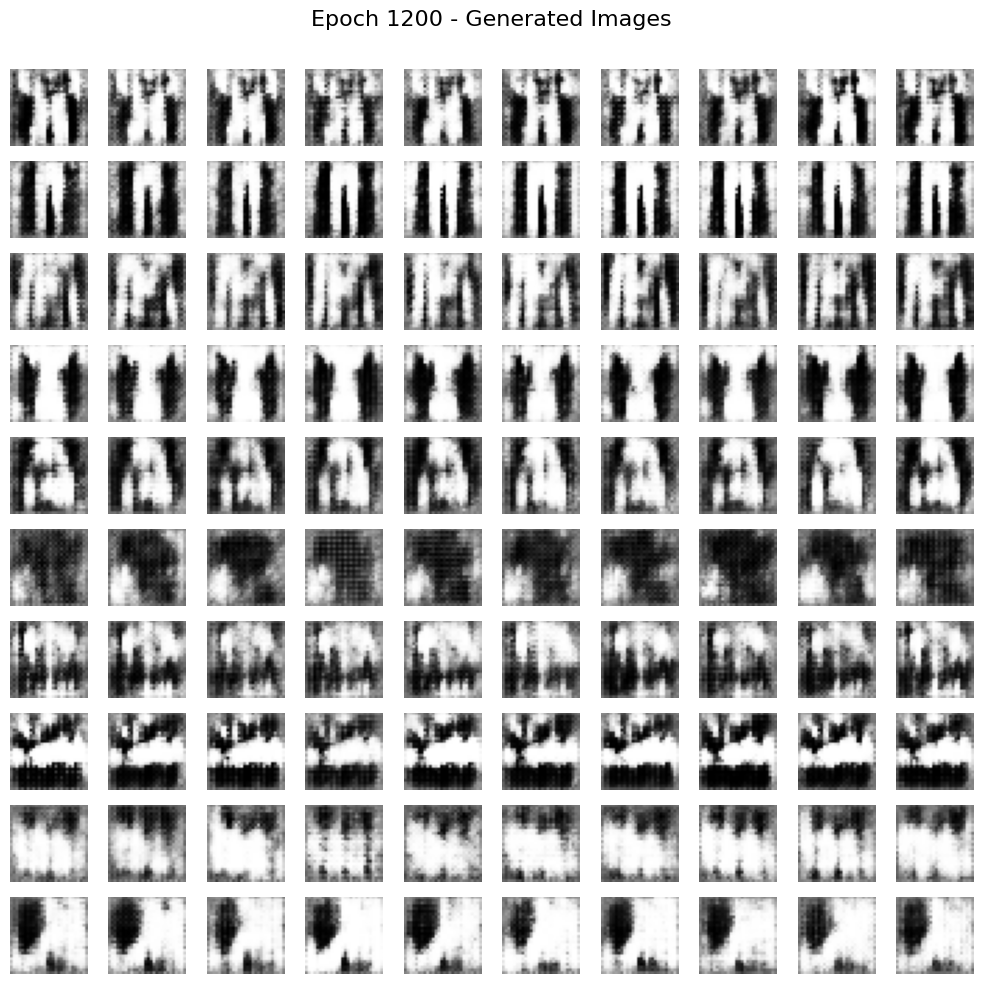

Epoch 1210/2000,  GL: 0.0008, VL: 185.4113, PKLD:0.0148, KLD:0.0000, PE: 0.0148, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1220/2000,  GL: 0.0010, VL: 189.0337, PKLD:0.0215, KLD:0.0000, PE: 0.0215, CE: 0.0000, IA: 1.0000,  PA: 0.9900
Epoch 1230/2000,  GL: 0.0008, VL: 188.2376, PKLD:0.0092, KLD:0.0000, PE: 0.0092, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1240/2000,  GL: 0.0008, VL: 188.0796, PKLD:0.0099, KLD:0.0000, PE: 0.0099, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1250/2000,  GL: 0.0010, VL: 187.2798, PKLD:0.0040, KLD:0.0000, PE: 0.0040, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1260/2000,  GL: 0.0008, VL: 184.5811, PKLD:0.0134, KLD:0.0000, PE: 0.0134, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1270/2000,  GL: 0.0009, VL: 185.9994, PKLD:0.0062, KLD:0.0000, PE: 0.0062, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1280/2000,  GL: 0.0010, VL: 185.7148, PKLD:0.0123, KLD:0.0000, PE: 0.0123, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1290/2000,  GL: 0.0007, VL: 191.2097, PKLD:0.0046, KLD:0.0

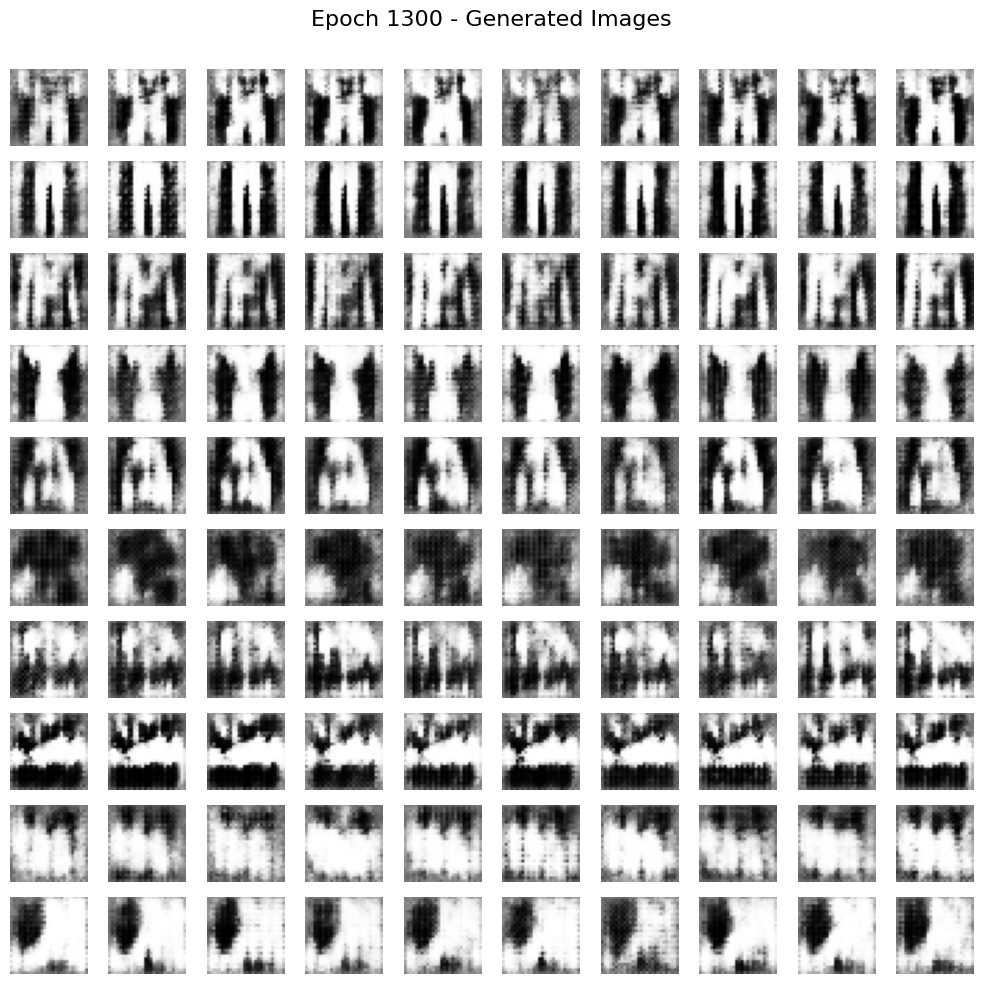

Epoch 1310/2000,  GL: 0.0008, VL: 186.8810, PKLD:0.0092, KLD:0.0000, PE: 0.0092, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1320/2000,  GL: 0.0007, VL: 186.2319, PKLD:0.0051, KLD:0.0000, PE: 0.0051, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1330/2000,  GL: 0.0010, VL: 187.2019, PKLD:0.0049, KLD:0.0000, PE: 0.0049, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1340/2000,  GL: 0.0007, VL: 190.9222, PKLD:0.0042, KLD:0.0000, PE: 0.0042, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1350/2000,  GL: 0.0009, VL: 189.4359, PKLD:0.0056, KLD:0.0000, PE: 0.0056, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1360/2000,  GL: 0.0007, VL: 187.5185, PKLD:0.0045, KLD:0.0000, PE: 0.0045, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1370/2000,  GL: 0.0007, VL: 188.6772, PKLD:0.0079, KLD:0.0000, PE: 0.0079, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1380/2000,  GL: 0.0007, VL: 191.0650, PKLD:0.0094, KLD:0.0000, PE: 0.0094, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1390/2000,  GL: 0.0008, VL: 188.3359, PKLD:0.0066, KLD:0.0

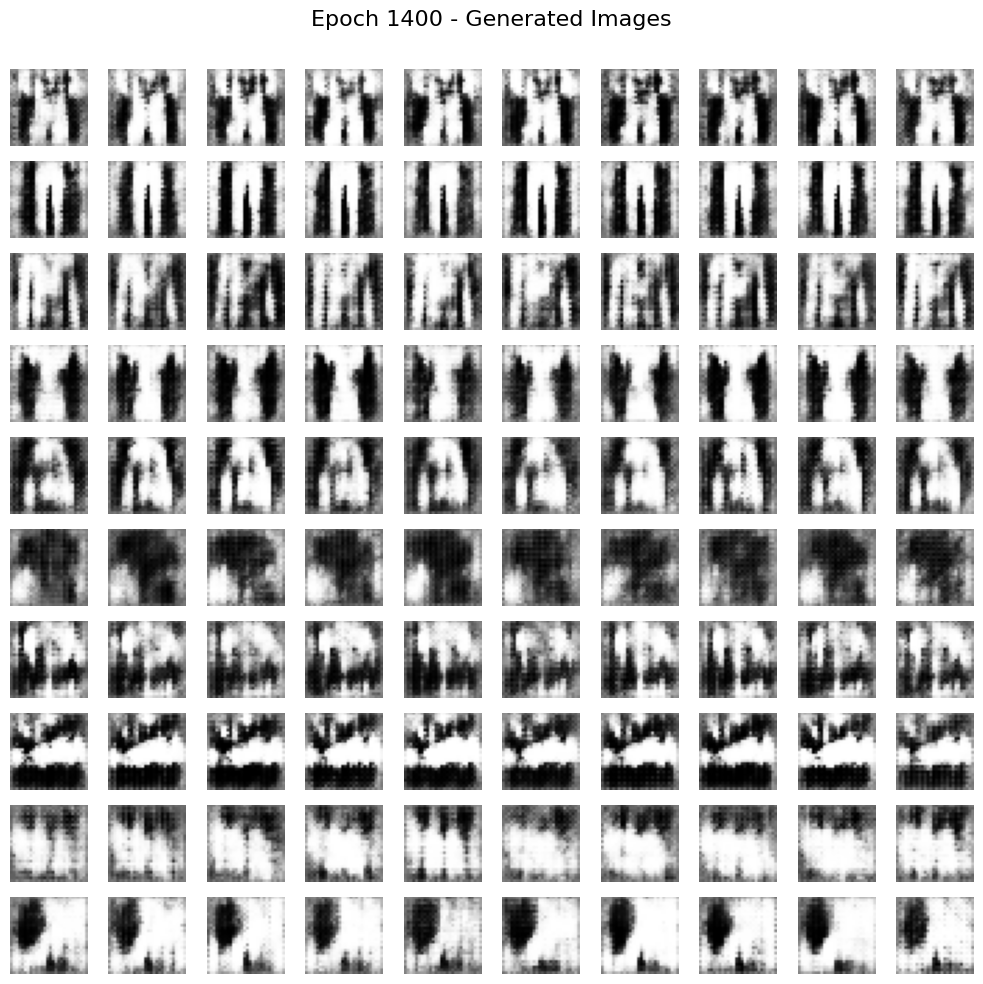

Epoch 1410/2000,  GL: 0.0007, VL: 186.6845, PKLD:0.0050, KLD:0.0000, PE: 0.0050, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1420/2000,  GL: 0.0007, VL: 184.7947, PKLD:0.0052, KLD:0.0000, PE: 0.0052, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1430/2000,  GL: 0.0010, VL: 187.1800, PKLD:0.0062, KLD:0.0000, PE: 0.0062, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1440/2000,  GL: 0.0007, VL: 185.3463, PKLD:0.0047, KLD:0.0000, PE: 0.0047, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1450/2000,  GL: 0.0008, VL: 187.4554, PKLD:0.0130, KLD:0.0000, PE: 0.0130, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1460/2000,  GL: 0.0007, VL: 190.0280, PKLD:0.0075, KLD:0.0000, PE: 0.0075, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1470/2000,  GL: 0.0008, VL: 188.8833, PKLD:0.0046, KLD:0.0000, PE: 0.0046, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1480/2000,  GL: 0.0007, VL: 187.4556, PKLD:0.0120, KLD:0.0000, PE: 0.0120, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1490/2000,  GL: 0.0007, VL: 186.2339, PKLD:0.0032, KLD:0.0

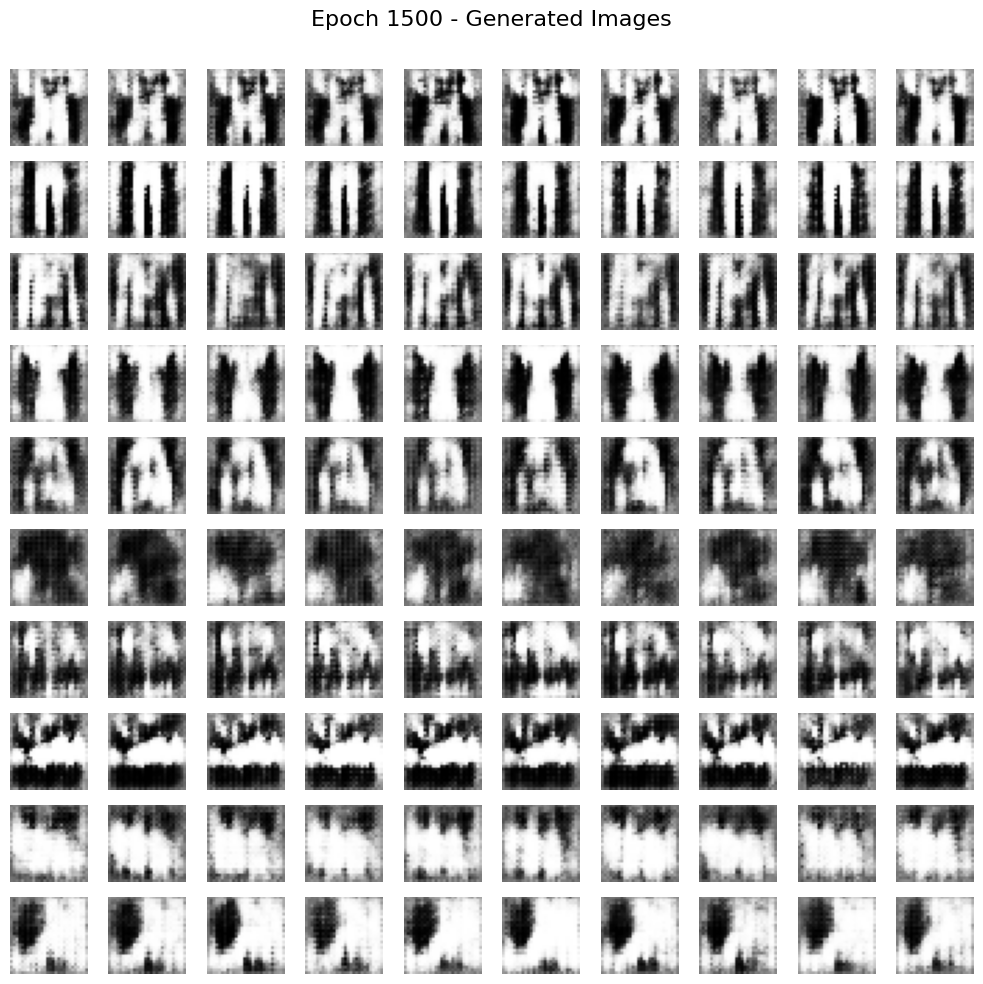

Epoch 1510/2000,  GL: 0.0009, VL: 189.1114, PKLD:0.0081, KLD:0.0000, PE: 0.0081, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1520/2000,  GL: 0.0010, VL: 182.2970, PKLD:0.0033, KLD:0.0000, PE: 0.0033, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1530/2000,  GL: 0.0008, VL: 186.6647, PKLD:0.0023, KLD:0.0000, PE: 0.0023, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1540/2000,  GL: 0.0008, VL: 189.7976, PKLD:0.0060, KLD:0.0000, PE: 0.0060, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1550/2000,  GL: 0.0047, VL: 186.4930, PKLD:0.0116, KLD:0.0001, PE: 0.0116, CE: 0.0001, IA: 1.0000,  PA: 0.9960
Epoch 1560/2000,  GL: 0.0008, VL: 193.6965, PKLD:0.0089, KLD:0.0000, PE: 0.0089, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1570/2000,  GL: 0.0008, VL: 190.6125, PKLD:0.0055, KLD:0.0000, PE: 0.0055, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1580/2000,  GL: 0.0007, VL: 186.7531, PKLD:0.0054, KLD:0.0000, PE: 0.0054, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1590/2000,  GL: 0.0009, VL: 183.8256, PKLD:0.0188, KLD:0.0

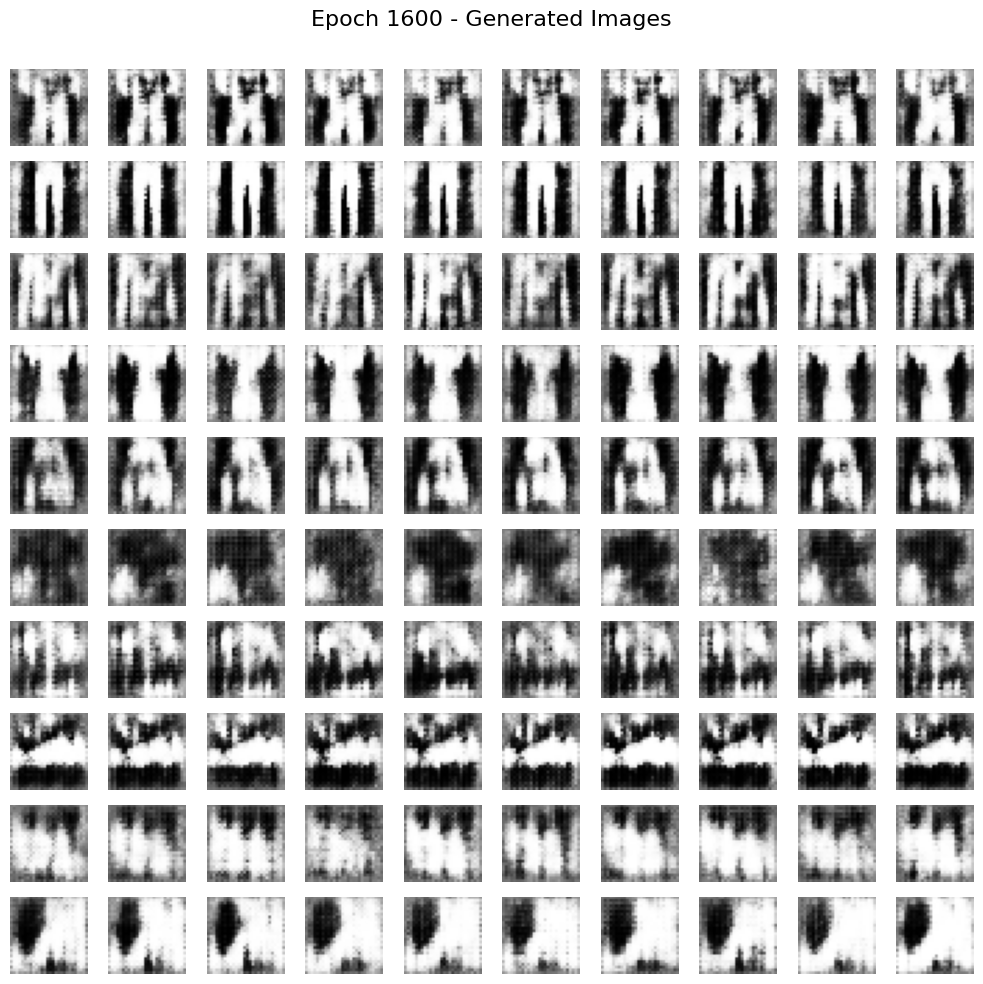

Epoch 1610/2000,  GL: 0.0009, VL: 189.9451, PKLD:0.0230, KLD:0.0000, PE: 0.0230, CE: 0.0000, IA: 1.0000,  PA: 0.9900
Epoch 1620/2000,  GL: 0.0008, VL: 190.4293, PKLD:0.0177, KLD:0.0000, PE: 0.0177, CE: 0.0000, IA: 1.0000,  PA: 0.9900
Epoch 1630/2000,  GL: 0.0008, VL: 189.0447, PKLD:0.0108, KLD:0.0000, PE: 0.0108, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1640/2000,  GL: 0.0006, VL: 188.7317, PKLD:0.0051, KLD:0.0000, PE: 0.0051, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1650/2000,  GL: 0.0008, VL: 186.5189, PKLD:0.0110, KLD:0.0000, PE: 0.0110, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1660/2000,  GL: 0.0007, VL: 187.8156, PKLD:0.0109, KLD:0.0000, PE: 0.0109, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1670/2000,  GL: 0.0008, VL: 183.0709, PKLD:0.0049, KLD:0.0000, PE: 0.0049, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1680/2000,  GL: 0.0007, VL: 186.0534, PKLD:0.0045, KLD:0.0000, PE: 0.0045, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1690/2000,  GL: 0.0007, VL: 186.2486, PKLD:0.0123, KLD:0.0

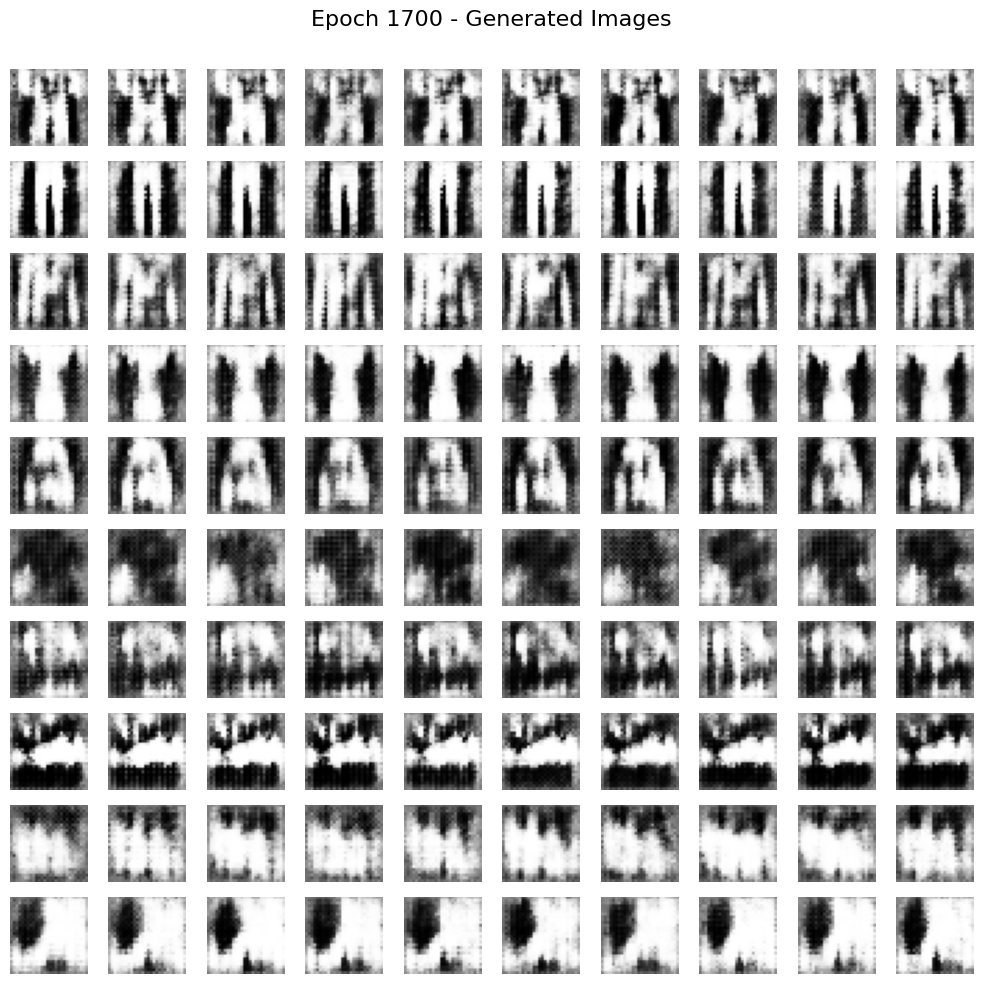

Epoch 1710/2000,  GL: 0.0007, VL: 186.8670, PKLD:0.0068, KLD:0.0000, PE: 0.0068, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1720/2000,  GL: 0.0009, VL: 188.9632, PKLD:0.0078, KLD:0.0000, PE: 0.0078, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1730/2000,  GL: 0.0011, VL: 189.3285, PKLD:0.0057, KLD:0.0000, PE: 0.0057, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1740/2000,  GL: 0.0008, VL: 191.0017, PKLD:0.0113, KLD:0.0000, PE: 0.0113, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1750/2000,  GL: 0.0011, VL: 188.4448, PKLD:0.0031, KLD:0.0000, PE: 0.0031, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1760/2000,  GL: 0.0010, VL: 188.9274, PKLD:0.0079, KLD:0.0000, PE: 0.0079, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1770/2000,  GL: 0.0009, VL: 189.5346, PKLD:0.0041, KLD:0.0000, PE: 0.0041, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1780/2000,  GL: 0.0007, VL: 190.5815, PKLD:0.0129, KLD:0.0000, PE: 0.0129, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1790/2000,  GL: 0.0008, VL: 186.1347, PKLD:0.0091, KLD:0.0

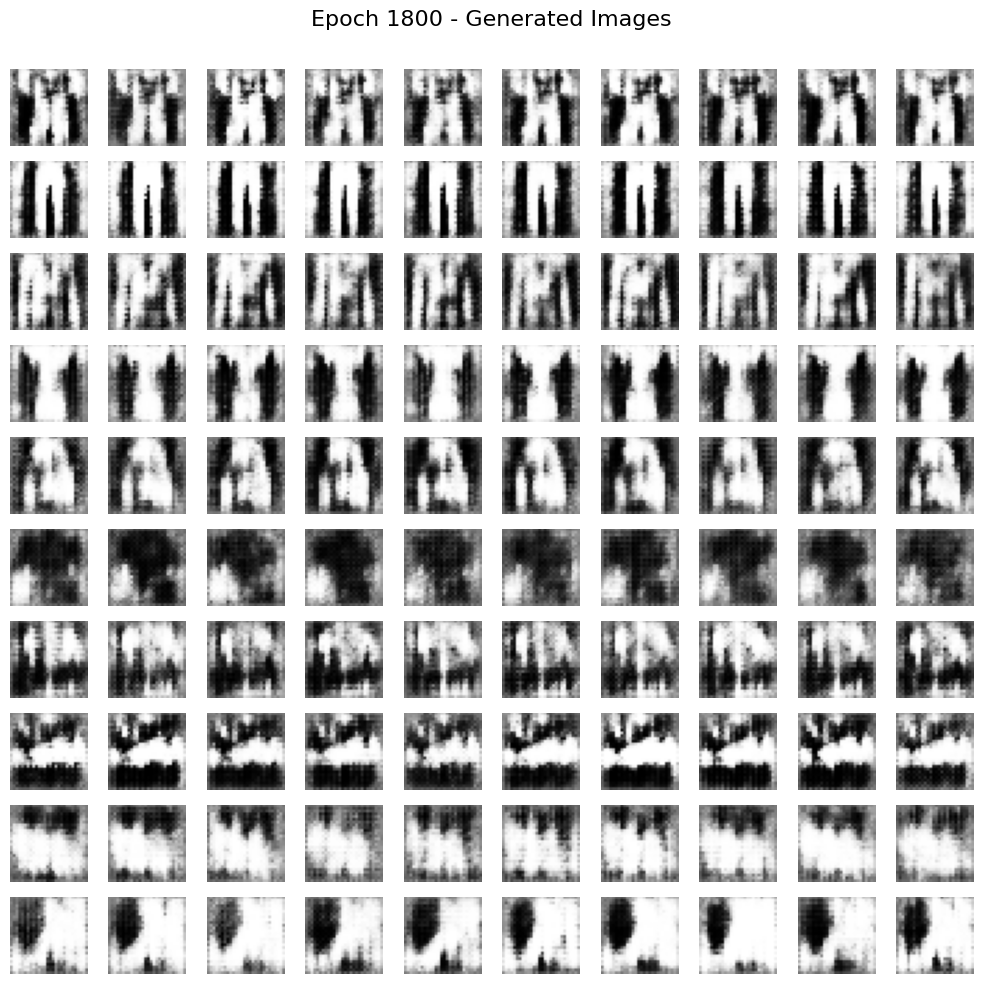

Epoch 1810/2000,  GL: 0.0007, VL: 192.3856, PKLD:0.0084, KLD:0.0000, PE: 0.0084, CE: 0.0000, IA: 1.0000,  PA: 0.9940
Epoch 1820/2000,  GL: 0.0007, VL: 190.5088, PKLD:0.0074, KLD:0.0000, PE: 0.0074, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1830/2000,  GL: 0.0009, VL: 187.7885, PKLD:0.0058, KLD:0.0000, PE: 0.0058, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1840/2000,  GL: 0.0008, VL: 188.3898, PKLD:0.0048, KLD:0.0000, PE: 0.0048, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1850/2000,  GL: 0.0008, VL: 189.3013, PKLD:0.0057, KLD:0.0000, PE: 0.0057, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1860/2000,  GL: 0.0007, VL: 187.0781, PKLD:0.0106, KLD:0.0000, PE: 0.0106, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1870/2000,  GL: 0.0008, VL: 188.9271, PKLD:0.0073, KLD:0.0000, PE: 0.0073, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1880/2000,  GL: 0.0007, VL: 187.7843, PKLD:0.0107, KLD:0.0000, PE: 0.0107, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1890/2000,  GL: 0.0008, VL: 187.5633, PKLD:0.0050, KLD:0.0

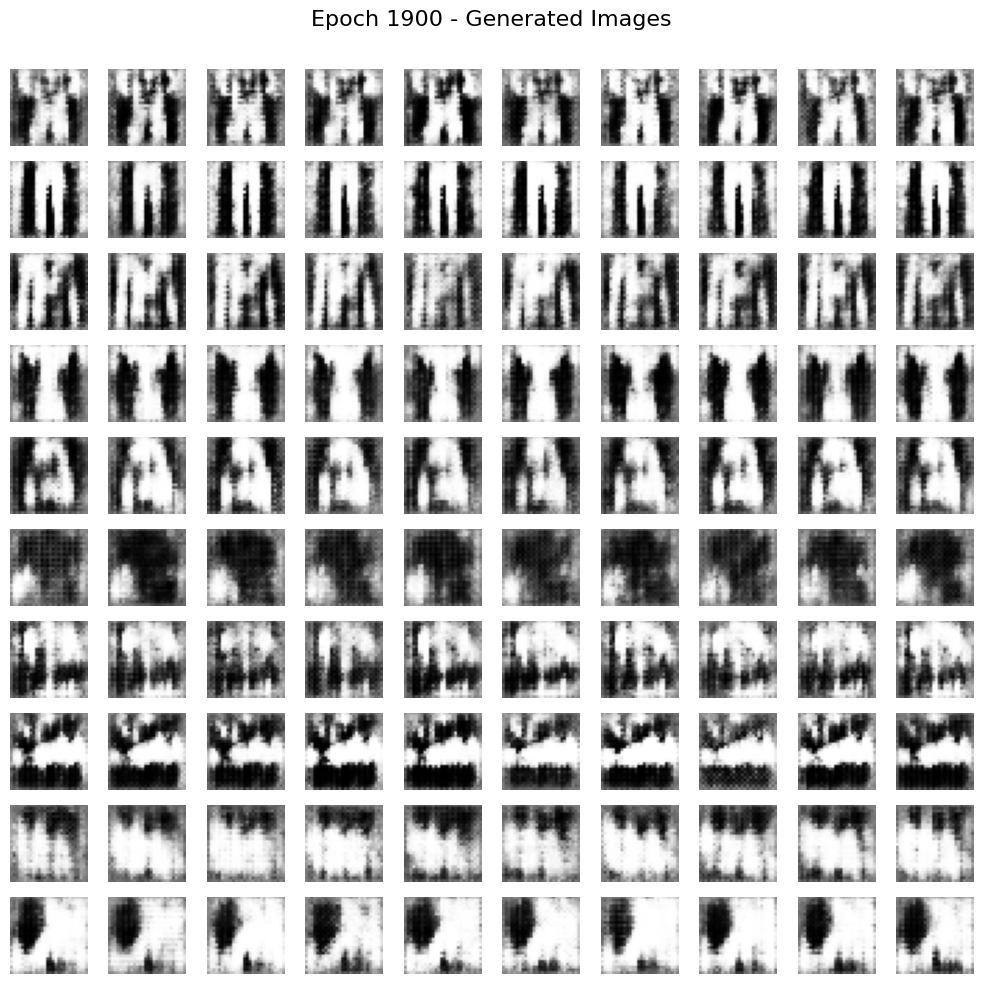

Epoch 1910/2000,  GL: 0.0010, VL: 186.6224, PKLD:0.0038, KLD:0.0000, PE: 0.0038, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1920/2000,  GL: 0.0011, VL: 188.2022, PKLD:0.0075, KLD:0.0000, PE: 0.0075, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1930/2000,  GL: 0.0007, VL: 193.1933, PKLD:0.0033, KLD:0.0000, PE: 0.0033, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1940/2000,  GL: 0.0006, VL: 192.0794, PKLD:0.0054, KLD:0.0000, PE: 0.0054, CE: 0.0000, IA: 1.0000,  PA: 0.9980
Epoch 1950/2000,  GL: 0.0006, VL: 190.4708, PKLD:0.0137, KLD:0.0000, PE: 0.0137, CE: 0.0000, IA: 1.0000,  PA: 0.9920
Epoch 1960/2000,  GL: 0.0012, VL: 186.8964, PKLD:0.0041, KLD:0.0000, PE: 0.0041, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1970/2000,  GL: 0.0008, VL: 188.2749, PKLD:0.0042, KLD:0.0000, PE: 0.0042, CE: 0.0000, IA: 1.0000,  PA: 1.0000
Epoch 1980/2000,  GL: 0.0006, VL: 192.6976, PKLD:0.0074, KLD:0.0000, PE: 0.0074, CE: 0.0000, IA: 1.0000,  PA: 0.9960
Epoch 1990/2000,  GL: 0.0009, VL: 187.5561, PKLD:0.0073, KLD:0.0

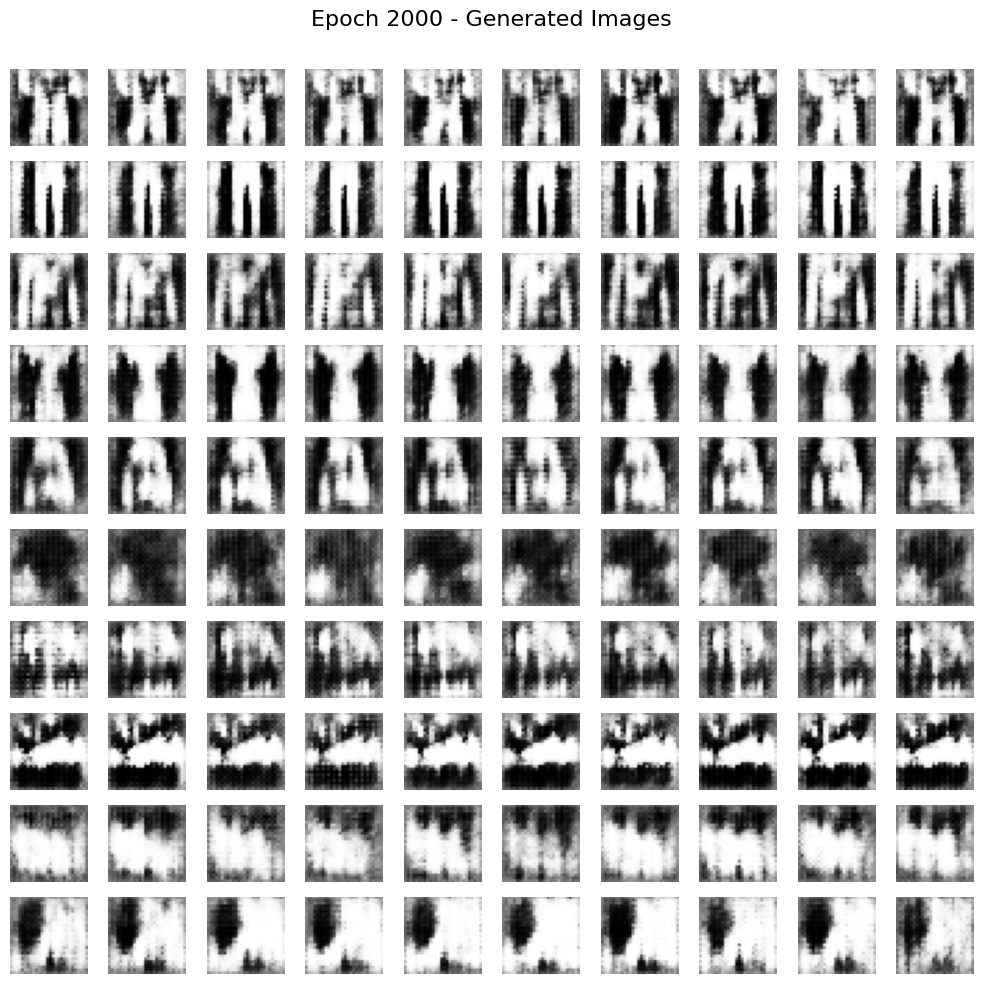

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_100_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.0005, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =2000

perturbation_bound = 2

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              # + .001*var_loss
              +750*perturbation_entropy
             +750*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_100_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.0001, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =4000

perturbation_bound = 2

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              + .001*var_loss
            #   +7500*perturbation_entropy
            #  +7500*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

### 1 image per class

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_10_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.001, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =4000

perturbation_bound = 2.5

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              + .001*var_loss
            #   +7500*perturbation_entropy
            #  +7500*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_10_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.001, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =4000

perturbation_bound = 1.75

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              # + .001*var_loss
            #   +7500*perturbation_entropy
            #  +7500*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_10_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.0005, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =4000

perturbation_bound = 1.75

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              # + .001*var_loss
            #   +7500*perturbation_entropy
            #  +7500*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")

In [ ]:
ncf=64
ngf =64
csf = CNNClassifier(nc=1, ncf=64).to(device)
csf.load_state_dict(torch.load('fmnist_cnn_csf_10_noaug_.pth'))
nc=1
gen = Generator(nz, ngf, nc, n_classes).to(device)
gen.apply(weights_initialization_gen_custom)
gen.train()
gen_optimizer = optim.AdamW(gen.parameters(), lr=0.0001, weight_decay=0)

# Add learning rate scheduler for generator
gen_scheduler = optim.lr_scheduler.CosineAnnealingLR(gen_optimizer, T_max=1500, eta_min=1e-6)

# hook0 = csf.main[6].register_forward_hook(hook_function0)
# hook1 = csf.main[4].register_forward_hook(hook_function1)

recon_criterion = nn.CrossEntropyLoss()
criterion = nn.CrossEntropyLoss(label_smoothing=0.0)

n_classes=10
batch_size=500
labels_per_class=10

fixed_noise, fixed_input_pdf = generate_ordered_one_hot_noise(100, n_classes, nz)
#fixed_noise, fixed_input_pdf = generate_sorted_input_pdf(100, n_classes, nz)
fixed_noise = fixed_noise.to(device)
fixed_input_pdf = fixed_input_pdf.to(device)

lambda_l1 = 0

num_epochs =4000

perturbation_bound = 1.75

for epoch in range(num_epochs):
    gen_optimizer.zero_grad()

    random_indices = torch.randint(0, n_classes, (batch_size,), device=device)
    input_pdf = torch.nn.functional.one_hot(random_indices, num_classes=n_classes).float().to(device)
    #input_pdf = F.softmax(torch.randn(batch_size, n_classes).to(device), dim=1)
    set_labels = torch.argmax(input_pdf, dim=1)
    noise = torch.randn(batch_size, nz, 1, 1).to(device)
    gen_images = gen(noise, input_pdf)
    var_loss = total_variation_loss(gen_images)
    grad_loss = gradient_minimization_loss(csf, gen_images, set_labels, recon_criterion)

    perturbed_images = add_linf_perturbation(gen_images, perturbation_bound)
    csf_outputs = csf(perturbed_images)
    perturbed_pdf = F.softmax(csf_outputs, dim=1)

    perturbation_entropy = criterion(csf_outputs, set_labels)
    perturbed_kl_div=kl_divergence(perturbed_pdf,input_pdf)

    predicted_labels = torch.argmax(perturbed_pdf, dim=1)
    perturbation_accuracy = (predicted_labels == set_labels).float().mean()

    # hook0 = csf.main[6].register_forward_hook(hook_function0)
    # hook1 = csf.main[4].register_forward_hook(hook_function1)

    csf.eval()
    csf_outputs = csf(gen_images)
    output_pdf = F.softmax(csf_outputs, dim=1)

    kl_divergence_value = kl_divergence(output_pdf, input_pdf)
    # cosine_similarilty = cosine_similarity_loss(features0[0]) + cosine_similarity_loss(features1[0])
    # orthogonality_loss = feature_orthogonality_loss(features0[0]) + feature_orthogonality_loss(features1[0])

    cross_entropy = criterion(csf_outputs, set_labels)
    predicted_labels = torch.argmax(F.log_softmax(csf_outputs, dim=1), dim=1)
    accuracy = (predicted_labels == set_labels).float().mean()

    l1_regularization = sum(param.abs().sum() for param in gen.parameters())

    loss =  (#25*cosine_similarilty
            #  +25*orthogonality_loss
             +1000*cross_entropy
             +5000*kl_divergence_value
              # + .001*var_loss
            #   +7500*perturbation_entropy
            #  +7500*perturbed_kl_div
              +750*grad_loss
            )

    loss.backward()
    gen_optimizer.step()
    gen_scheduler.step()  # Update learning rate for generator

    # hook0.remove()
    # hook1.remove()
    features0.clear()
    features1.clear()

    if epoch % 10 == 9:
      print(f"Epoch {epoch + 1}/{num_epochs},  GL: {grad_loss.item():.4f}, VL: {var_loss.item():.4f}, PKLD:{perturbed_kl_div.item():.4f}, KLD:{kl_divergence_value.item():.4f}, PE: {perturbation_entropy.item():.4f}, CE: {cross_entropy.item():.4f}, IA: {accuracy.item():.4f},  PA: {perturbation_accuracy.item():.4f}")

      with torch.no_grad():
          fixed_gen_images = gen(fixed_noise, fixed_input_pdf)
          vutils.save_image(fixed_gen_images, f"MNIST-Reconstruction/1/image_{epoch + 1}.png", nrow=10, normalize=True)
    if epoch%100 == 99:
      plot_generated_grid(fixed_gen_images, nrow=10, title=f"Epoch {epoch+1} - Generated Images")